# **IMPORT MODULES**

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import datetime as dt
import sklearn.mixture as mix
import plotly.express as px
from datetime import datetime
import scipy
import random
from sklearn.decomposition import PCA
from datetime import timedelta
import cvxpy as cp
import copy

import warnings
warnings.filterwarnings("ignore") 

# **LOAD DATA**

In [2]:
# Load Factor Data for regime detection
final_df = pd.read_csv('https://raw.githubusercontent.com/DN612/Capstone-Regime-Detection/main/factor_data.csv', index_col=0)
final_df.index = pd.to_datetime(final_df.index)
final_df

,Interest Rate,Equity,Credit,Commodities,Emerging Market,Foreign Currency,Local Inflation,Equity Short Volatility,Fixed Income Carry,Foreign Exchange Carry,Trend Following,Low Risk,Momentum,Quality,Value
Date,,,,,,,,,,,,,,,
2002-04-03,0.003201,-0.004629,0.001418,-0.012797,-0.000021,-0.001560,0.005413,-0.008489,0.001839,-0.000877,-0.000618,0.000064,-0.006541,-0.000397,0.007077
2002-04-04,0.002607,-0.001380,0.000492,-0.023046,0.000037,-0.000398,0.002651,0.001399,0.005787,-0.001464,0.002117,0.000442,0.000402,-0.000150,-0.002165
2002-04-05,0.000826,-0.002263,0.000616,-0.015066,0.002990,-0.001601,0.002501,-0.001653,-0.002182,0.000683,0.000440,0.003700,-0.000063,0.003049,0.004912
2002-04-08,-0.001516,-0.004962,0.000173,0.009791,-0.003813,0.000355,0.000337,0.002653,0.000862,-0.002345,-0.004237,0.000937,0.005677,0.002057,-0.000864
2002-04-09,0.001067,-0.004521,0.000380,-0.015899,-0.000731,-0.000199,-0.000323,-0.005489,-0.002166,-0.000881,0.003179,0.001220,0.007328,0.001860,0.007096
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-08-24,-0.003205,0.001355,-0.000937,0.009899,-0.001431,0.000464,-0.003414,0.003337,0.002932,0.001939,0.002186,-0.002911,0.002654,-0.004390,-0.010452
2022-08-25,0.003457,0.012520,0.003759,-0.011337,0.011348,0.000204,0.004469,0.009027,0.000934,0.001119,-0.002823,-0.003612,0.006666,0.000162,-0.000331
2022-08-26,-0.001508,-0.023717,-0.002084,0.007313,0.001396,0.000253,-0.003928,-0.024272,-0.007612,-0.001764,0.001631,-0.003722,0.002863,-0.000755,0.003260


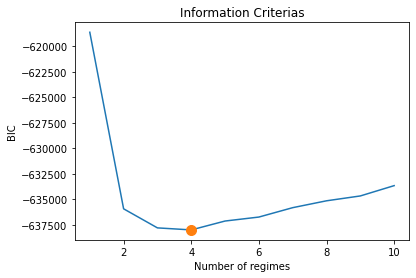

In [3]:
models = []
bic = []
n_components = list(np.arange(1, 11))
for n in n_components:
  X_slice = final_df[final_df.columns]
  model = mix.GaussianMixture(n_components = n, random_state = 42)
  model.fit(X_slice)
  models.append(model)
  ic = model.bic(X_slice)
  bic.append(ic)

plt.figure()
plt.title("Information Criterias")
plt.plot(np.arange(1, 11), bic)
plt.plot(1+np.argmin(bic), min(bic), marker = '.', markersize = 20)
plt.xlabel("Number of regimes")
plt.ylabel("BIC")
plt.show()

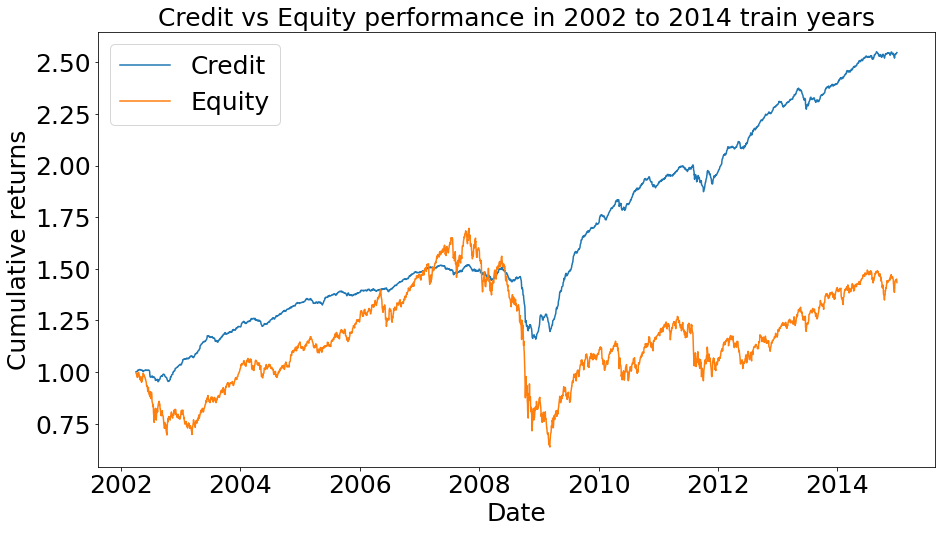

In [4]:
plt.figure(figsize = (15, 8))
plt.plot((1 + final_df[(final_df.index.year >= 2002) & (final_df.index.year <= 2014)].Credit).cumprod(), label = "Credit")
plt.plot((1 + final_df[(final_df.index.year >= 2002) & (final_df.index.year <= 2014)].Equity).cumprod(), label = "Equity")
plt.title("Credit vs Equity performance in 2002 to 2014 train years", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

In [5]:
t_df = final_df[(final_df.index.year >= 2002) & (final_df.index.year <= 2014)]


print("Credit ret:", np.cumprod(1 + t_df.Credit)[-1]**(1/13) -1 )
print("Equity ret:", np.cumprod(1 + t_df.Equity)[-1]**(1/13) -1 ) 

print("Credit vol:", t_df.Credit.std() * 252**(0.5))
print("Equity vol:", t_df.Equity.std() * 252**(0.5))

print("Credit sharpe:", (252)**(0.5) * t_df.Credit.mean()/t_df.Credit.std())
print("Equity sharpe:", (252)**(0.5) * t_df.Equity.mean()/t_df.Equity.std())

Credit ret: 0.07455000807301926
Equity ret: 0.028086299684360716
Credit vol: 0.03457066516644319
Equity vol: 0.17535034807662256
Credit sharpe: 2.19728861713203
Equity sharpe: 0.2534210150890204


In [6]:
# Load US specific data
invest_factors_us = pd.read_csv('https://raw.githubusercontent.com/DN612/Capstone-Regime-Detection/main/invest_factors_us.csv')
invest_factors_us['Date'] = pd.to_datetime(invest_factors_us['Date'])
invest_factors_us = invest_factors_us.set_index('Date')
invest_factors_us

,Interest Rate,Equity,Credit,Commodities,Emerging Markets,Local Inflation
Date,,,,,,
2002-04-02,-0.014815,-0.008567,0.002215,0.026478,0.006259,0.003212
2002-04-03,-0.011257,-0.010052,0.002088,-0.012797,-0.000021,0.003154
2002-04-04,-0.003781,0.000835,-0.000261,-0.023046,0.000037,0.003000
2002-04-05,-0.011429,-0.003210,0.002010,-0.015066,0.002990,0.002885
2002-04-08,0.005731,0.002278,-0.000286,0.009791,-0.003813,0.000528
...,...,...,...,...,...,...
2022-08-25,-0.026060,0.013993,0.004649,-0.011337,0.011348,0.002741
2022-08-26,0.003295,-0.034269,-0.001669,0.007313,0.001396,-0.001188
2022-08-29,0.025975,-0.006689,-0.005693,0.019071,-0.009922,-0.003766


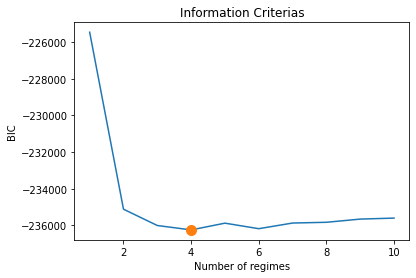

In [7]:
models = []
bic = []
n_components = list(np.arange(1, 11))
for n in n_components:
  X_slice = invest_factors_us[invest_factors_us.columns]
  model = mix.GaussianMixture(n_components = n, random_state = 42)
  model.fit(X_slice)
  models.append(model)
  ic = model.bic(X_slice)
  bic.append(ic)

plt.figure()
plt.title("Information Criterias")
plt.plot(np.arange(1, 11), bic)
plt.plot(1+np.argmin(bic), min(bic), marker = '.', markersize = 20)
plt.xlabel("Number of regimes")
plt.ylabel("BIC")
plt.show()

# **BUILD PIPELINE**

In [8]:
def smooth(year, regime_num, daily_regime, daily_prob):
    
    weekly_first_date = daily_regime.resample('W-MON').first().index
    weekly_first_date = [x + timedelta(days=1) for x in weekly_first_date] 
    weekly_regime_tohold = pd.DataFrame(index = daily_regime.index, columns=['regime to hold'])
    weekly_regime_probs = pd.DataFrame(index = daily_regime.index, columns=['regime ' + str(i) for i in range(regime_num)])
    
    for i in range(1, len(weekly_first_date)):
      last_week_regime = daily_regime.loc[(daily_regime.index < weekly_first_date[i])&(daily_regime.index >= weekly_first_date[i-1])]
      last_week_regime_count = last_week_regime.groupby('regime').size().sort_values()
      last_week_regime_prob = daily_prob.loc[(daily_prob.index < weekly_first_date[i])&(daily_prob.index >= weekly_first_date[i-1])]
      
      # if regime count are all ones, use the last date's regime
      if last_week_regime_count.iloc[-1] == 1:
        regime_max = int(last_week_regime.iloc[-1])
      # if regime count are 2 v.s. 2, use the regime in the latest date belong to those 2 regimes
      elif len(last_week_regime_count) not in [0,1] and last_week_regime_count.iloc[-1] == last_week_regime_count.iloc[-2]:
        last_date1 = last_week_regime[last_week_regime==last_week_regime_count.iloc[-1]].index[-1]
        last_date2 = last_week_regime[last_week_regime==last_week_regime_count.iloc[-2]].index[-1]
        regime_max = int(last_week_regime.loc[max(last_date1,last_date2)])
      # no equal counts, use the majority
      else:
        regime_max = last_week_regime_count.index[-1]
    
      if i != len(weekly_first_date) - 1:
        current_week_dates = daily_regime.loc[(daily_regime.index < weekly_first_date[i+1])&(daily_regime.index >= weekly_first_date[i])].index
      else:
        current_week_dates = daily_regime.loc[daily_regime.index >= weekly_first_date[i]].index
      weekly_regime_tohold.loc[current_week_dates, 'regime to hold'] = regime_max
      weekly_regime_probs.loc[current_week_dates, weekly_regime_probs.columns] = list(last_week_regime_prob.mean())
    weekly_regime_tohold = weekly_regime_tohold.dropna()
    weekly_regime_probs = weekly_regime_probs.dropna()
    
    return weekly_regime_tohold, weekly_regime_probs

In [9]:
def portfolio_optimizer(mu, Sigma, gamma_range=[-1, 4], SAMPLES = 100, type = 'original', min_weight=0.1, benchmark_index=1, min_ret=0.001, max_var=0.001):
  
  # original markowitz
  if(type == 'original'):
    n = len(mu)
    w = cp.Variable(n)
    gamma = cp.Parameter(nonneg=True)
    ret = mu @ w
    risk = cp.quad_form(w, Sigma)
    zero_w_list = [i for i in range(len(mu)) if mu[i] < 0]
    prob = cp.Problem(cp.Maximize(ret - gamma * risk), [cp.sum(w) == 1, w >= 0])
    risk_data = np.zeros(SAMPLES)
    ret_data = np.zeros(SAMPLES)
    w_data = []
    gamma_vals = np.logspace(gamma_range[0], gamma_range[1], num=SAMPLES)
    for i in range(SAMPLES):
        gamma.value = gamma_vals[i]
        prob.solve()
        risk_data[i] = cp.sqrt(risk).value
        ret_data[i] = ret.value
        w_data.append(w.value)       
    return ret_data, risk_data, w_data

  # markowitz with minimum weight on equities (only in relevant regime)
  if(type == 'equity_min'):
    n = len(mu)
    w = cp.Variable(n)
    gamma = cp.Parameter(nonneg=True)
    ret = mu @ w
    risk = cp.quad_form(w, Sigma)
    zero_w_list = [i for i in range(len(mu)) if mu[i] < 0]
    prob = cp.Problem(cp.Maximize(ret - gamma * risk), [cp.sum(w) == 1, w >= 0, w[benchmark_index] >= min_weight])
    risk_data = np.zeros(SAMPLES)
    ret_data = np.zeros(SAMPLES)
    w_data = []
    gamma_vals = np.logspace(gamma_range[0], gamma_range[1], num=SAMPLES)
    for i in range(SAMPLES):
        gamma.value = gamma_vals[i]
        prob.solve()
        risk_data[i] = cp.sqrt(risk).value
        ret_data[i] = ret.value
        w_data.append(w.value)       
    return ret_data, risk_data, w_data

  # markowitz with minimum weight on all assets
  if(type == 'all_min'):
    n = len(mu)
    w = cp.Variable(n)
    gamma = cp.Parameter(nonneg=True)
    ret = mu @ w
    risk = cp.quad_form(w, Sigma)
    zero_w_list = [i for i in range(len(mu)) if mu[i] < 0]
    prob = cp.Problem(cp.Maximize(ret - gamma * risk), [cp.sum(w) == 1, w >= min_weight])
    risk_data = np.zeros(SAMPLES)
    ret_data = np.zeros(SAMPLES)
    w_data = []
    gamma_vals = np.logspace(gamma_range[0], gamma_range[1], num=SAMPLES)
    for i in range(SAMPLES):
        gamma.value = gamma_vals[i]
        prob.solve()
        risk_data[i] = cp.sqrt(risk).value
        ret_data[i] = ret.value
        w_data.append(w.value)       
    return ret_data, risk_data, w_data

  # markowitz with beta = 1 wrt to index
  if(type == 'index_track'):
    n = len(mu)
    w = cp.Variable(n)
    ret = w @ mu
    risk = cp.quad_form(w, Sigma)
    betas = Sigma[:,benchmark_index] / Sigma[benchmark_index,benchmark_index]
    b = w @ betas
    prob = cp.Problem(cp.Minimize(risk), [cp.sum(w) == 1,  w >= 0, b==1])
    prob.solve()
    risk_data = cp.sqrt(risk).value
    ret_data = ret.value
    w_data = w.value

    return np.array([ret_data]), np.array([risk_data]), [w_data]

  # markowitz for minimizing risk with constraint on minimum returns needed
  if(type == 'min_return_constraint'):
    n = len(mu)
    w = cp.Variable(n)
    gamma = cp.Parameter(nonneg=True)
    ret = mu @ w
    risk = cp.quad_form(w, Sigma)
    zero_w_list = [i for i in range(len(mu)) if mu[i] < 0]
    prob = cp.Problem(cp.Minimize(risk), [cp.sum(w) == 1, w >= 0, ret >= min_ret])
    prob.solve()
    risk_data = cp.sqrt(risk).value
    ret_data = ret.value
    w_data = w.value
    return np.array([ret_data]), np.array([risk_data]), [w_data]

  # markowitz for maximizing returns with constraint on maximum risk allowed
  if(type == 'max_risk_constraint'):
    n = len(mu)
    w = cp.Variable(n)
    gamma = cp.Parameter(nonneg=True)
    ret = mu @ w
    risk = cp.quad_form(w, Sigma)
    zero_w_list = [i for i in range(len(mu)) if mu[i] < 0]
    prob = cp.Problem(cp.Maximize(ret), [cp.sum(w) == 1, w >= 0, risk <= max_var])
    prob.solve()
    risk_data = cp.sqrt(risk).value
    ret_data = ret.value
    w_data = w.value
    return np.array([ret_data]), np.array([risk_data]), [w_data]

In [10]:
def pnl_analysis(pnl, pnl_base, portfolio_name):
    
    pnl_nv = (1 + pnl).cumprod()
    pnl_base_nv = (1 + pnl_base).cumprod()
    plt.plot(figsize = (10, 3))
    plt.plot(pnl_nv, label = 'portfolio')
    plt.plot(pnl_base_nv, label = 'baseline')
    plt.legend()
    plt.title(portfolio_name)
    
    def max_drawdown(wealth):
        roll_max = wealth.cummax()
        Daily_Drawdown = wealth/roll_max - 1.0
        Max_Daily_Drawdown = Daily_Drawdown.min()
        return -Max_Daily_Drawdown
    
    portfolio_md = max_drawdown(pnl_nv)[0]
    baseline_md = max_drawdown(pnl_base_nv)[0]
    portfolio_ar = ((pnl_nv.iloc[-1] / pnl_nv.iloc[0]) ** (252 / len(pnl_nv)) - 1)[0]
    baseline_ar = ((pnl_base_nv.iloc[-1] / pnl_base_nv.iloc[0]) ** (252 / len(pnl_base_nv)) - 1)[0]
    portfolio_sharpe = (pnl.mean() * np.sqrt(252) / pnl.std())[0]
    baseline_sharpe = (pnl_base.mean() * np.sqrt(252) / pnl_base.std())[0]
    portfolio_calmar = (pnl.mean() * 252 / portfolio_md)[0]
    baseline_calmar = (pnl_base.mean() * 252 / baseline_md)[0]
    
    print(portfolio_name + " Performance")
    print("Portfolio Annual Return:  {0},  Baseline Annual Return: {1}".format(str(portfolio_ar), str(baseline_ar)))
    print("Portfolio Sharpe Ratio:  {0},  Baseline Sharpe Ratio: {1}".format(str(portfolio_sharpe), str(baseline_sharpe)))
    print("Portfolio Max Drawdown:  {0},  Baseline Max Drawdown: {1}".format(str(portfolio_md), str(baseline_md)))
    print("Portfolio Calmar Ratio:  {0},  Baseline Calmar Ratio: {1}".format(str(portfolio_calmar), str(baseline_calmar)))
    
    return

In [11]:
def run(factor, invest_factor, year, train_window, print_stats, plot_chart, portfolio_type, weighted, 
        weekly = False, expanding = False, fix_k = None, portfolio_sub_type="original", 
        min_ret = 0.001, max_var = 0.001, min_weight = 0.1):
    '''

    Parameters
    ----------
    factor : pd.DataFrame
        The factors used to train GMM model.
    invest_factor : pd.DataFrame
        The factors to invest after we train GMM model.
    year : Int
        Test year.
    train_window : Int
        GMM training window length.
    print_stats : Bool
        Whether to print the training set statistics.
    plot_chart : Bool
        Whether to plot the regimes and weights in the training set.
    portfolio_type : String
        'Markowitz': Construct a Markowitz portfolio.
        'Max_sharpe': Construct a max sharpe portfolio.
    weighted : Bool
        Whether to use the regime probabilities to weight portfolios
    weekly : Bool
        Whether to use weekly data or not for regime detection
    expanding : Bool
        Whether to use expanding window or not for training
    fix_k : Int
        The fix number of regimes throughtout whole period. If None, the changing optimal

    Returns
    -------
    pnl:  pnl for this year
    pnl_base: base portfolio pnl for this year

    '''

    if(weekly):
      factor = factor.resample('W-MON').sum()

    train_window = train_window + 1

    if(expanding):
      custom_start = 2002
    else:
      custom_start = year - train_window
    
    print("Training on years", str(custom_start), "to", str(year-1))
    print("Testing on year", str(year))
    
    # take input year as test year and train_window years before that as train years
    training = factor[(factor.index >= datetime(custom_start, 1, 1)) & (factor.index < datetime(year, 1, 1))]
    test = factor[(factor.index >= datetime(year, 1, 1)) & (factor.index <= datetime(year, 12, 31))]
    
    training_f = invest_factor[(invest_factor.index >= datetime(custom_start, 1, 1)) & (invest_factor.index < datetime(year, 1, 1))]
    test_f = invest_factor[(invest_factor.index >= datetime(year, 1, 1)) & (invest_factor.index <= datetime(year, 12, 31))]
    
    # run GMM model on train years for different number of regimes
    # identify optimal number of regimes based on lowest BIC score
    bic_scores = []
    models = []
    for n in np.arange(1, 11):
      model = mix.GaussianMixture(n_components = n, random_state = 42)
      model.fit(training)
      bic_scores.append(model.bic(training))
      models.append(model)
    
    # fetch optimal number of regimes and corresponding model
    if(fix_k != None):
      optimal_ind = fix_k - 1
    else:
      optimal_ind = np.argmin(bic_scores)
    
    optimal_n = optimal_ind + 1
    optimal_model = models[optimal_ind]
    print("Optimal number of regimes:", optimal_n)

    efficient_f = {z:[] for z in range(optimal_n)}
    eff_point = {z:[] for z in range(optimal_n)}
    inverse_p = {z:[] for z in range(optimal_n)}
    min_var = {z:[] for z in range(optimal_n)}
    
    # smooth the regimes in train years
    in_sample = optimal_model.predict(training)
    in_sample_prob = optimal_model.predict_proba(training)
    train_regime = pd.DataFrame(in_sample, columns = ['regime'], index = training.index)
    in_sample_prob = pd.DataFrame(in_sample_prob, columns = ['regime ' + str(i) for i in range(optimal_n)], index = training.index)                                                            
    train_regime_weekly, train_regime_prob = smooth(year, optimal_n, train_regime, in_sample_prob)
    
    # reorder labels such that regime 1 is the max occuring regime and regime n is the least occuring regime
    idx_lst =  train_regime_weekly.groupby('regime to hold')['regime to hold'].count().sort_values(ascending = False).index
    reorder_map = dict(zip(idx_lst, np.arange(optimal_n)))
    train_regime_weekly = train_regime_weekly.replace({'regime to hold':reorder_map})
    train_regime_prob = train_regime_prob.iloc[:, idx_lst]
    train_regime_prob.columns = ['regime ' + str(i) for i in range(optimal_n)]
      
    # print statistics in train years for optimal model
    mean_dict, std_dict, sharpe_dict, cov_dict = {}, {}, {}, {}
    for i in range(optimal_n):
      train_slice = training_f[training_f.index.isin(train_regime_weekly.index)]
      train_slice["Regime"] = train_regime_weekly["regime to hold"]
      state_i_df = train_slice[train_slice.Regime == i].drop(columns = ["Regime"], axis = 1)
      mean_dict[i] = state_i_df.mean() * 252
      std_dict[i] = state_i_df.std() * np.sqrt(252)
      sharpe_dict[i] = (state_i_df.mean() *252)/(state_i_df.std() * np.sqrt(252))
      cov_dict[i] = state_i_df.cov() * 252
      
    names = []
    for i in range(optimal_n):
      names.append('Regime_'+str(i+1))
      
    smoothed_train_mean = pd.DataFrame.from_dict(mean_dict)
    smoothed_train_mean.columns = [n+"_Mean" for n in names]
    smoothed_train_std = pd.DataFrame.from_dict(std_dict)
    smoothed_train_std.columns = [n+"_Volatility" for n in names]
    smoothed_train_sr = pd.DataFrame.from_dict(sharpe_dict)
    smoothed_train_sr.columns = [n+"_Sharpe_Ratio" for n in names]
    statistics = pd.concat([smoothed_train_mean, smoothed_train_std, smoothed_train_sr], axis=1)
    if(print_stats):
      print(statistics)
    
    # function for preprocessing dataframe before plots
    def label_regime (row, regime, idx_lst, optimal_n):
      for i in range(optimal_n):
        if regime == i+1:
          if row['regime to hold'] == idx_lst[i] :
            return 1
          return 0
    color_lst = ['dodgerblue','orange','navy','slategray','green','tan','purple','olive','pink','grey']
     
    # plot regimes in train years
    if(plot_chart):
      idx_lst_new =  train_regime_weekly.groupby('regime to hold')['regime to hold'].count().sort_values(ascending = False).index
      for i in range(optimal_n):
        train_regime_weekly['Regime_'+str(i+1)] = train_regime_weekly.apply(lambda row: label_regime (row, i+1, idx_lst_new, optimal_n), axis = 1)
      train_regime_weekly = train_regime_weekly[names] 
      fig, ax = plt.subplots(figsize=(30,4))
      ax.stackplot(train_regime_weekly.index, train_regime_weekly.T, colors = color_lst[:optimal_n],labels=train_regime_weekly.columns)
      ax.axes.get_yaxis().set_visible(False)
      plt.title(str(custom_start) + " to " + str(year-1) +" train years regimes with smoothing", fontsize = 20)
      plt.xlabel("Date", fontsize = 20)
      plt.xticks(fontsize = 20)
      plt.legend(fontsize = 20)
      plt.show()
        
    # predict regimes in test year and plot
    test_regime = pd.DataFrame(optimal_model.predict(test), columns = ['regime'], index = test.index)
    test_regime_prob = pd.DataFrame(optimal_model.predict_proba(test), columns = names, index = test.index)
    if weekly:
      test_regime = test_regime.shift(1)
      test_regime = test_regime.reindex(test_f.index)
      test_regime.ffill(inplace = True)
      test_regime.bfill(inplace = True)
    
    test_regime_weekly, test_regime_prob = smooth(year, optimal_n, test_regime, test_regime_prob)
    test_regime_weekly = test_regime_weekly.replace({'regime to hold': reorder_map})
    test_regime_prob = test_regime_prob.iloc[:, idx_lst]
    test_regime_prob.columns = ['regime ' + str(i) for i in range(optimal_n)]

    if(plot_chart):
      test_regime_weekly_copy = test_regime_weekly.copy()
      for i in range(optimal_n):
        test_regime_weekly_copy['Regime_'+str(i+1)] = test_regime_weekly.apply(lambda row: label_regime (row, i+1, idx_lst_new, optimal_n), axis = 1)
      test_regime_weekly_copy = test_regime_weekly_copy[names]
      fig, ax = plt.subplots(figsize=(30,4))
      ax.stackplot(test_regime_weekly_copy.index, test_regime_weekly_copy.T, colors = color_lst[:optimal_n],labels=test_regime_weekly_copy.columns)
      ax.axes.get_yaxis().set_visible(False)
      plt.title(str(year) + " test years regimes", fontsize = 20)
      plt.xlabel("Date", fontsize = 20)
      plt.xticks(fontsize = 20)
      plt.legend(fontsize = 20)
      plt.show()
    
    # portfolio contruction based on train years regimes
    if portfolio_type == 'Markowitz':
        max_sharpe_w = {}
        for i in range(optimal_n):
            mu = np.array(mean_dict[i])
            Sigma = np.array(cov_dict[i])
            ret_data, risk_data, w_data = portfolio_optimizer(mu, Sigma, type=portfolio_sub_type, min_weight=min_weight, benchmark_index=1, min_ret=min_ret, max_var=max_var)
            idx = np.argmax(ret_data / risk_data)
            idx_min_var = np.argmin(risk_data)
            max_sharpe_w[i] = w_data[idx]

            inv_weight = np.sqrt(1/Sigma.diagonal())/np.sum(np.sqrt(1/Sigma.diagonal()))
            inverse_p[i].append(np.sqrt(inv_weight @ Sigma @inv_weight.T))
            inverse_p[i].append(inv_weight @ mu)
            efficient_f[i].append(ret_data)
            efficient_f[i].append(risk_data)
            eff_point[i].append(risk_data[idx]) 
            eff_point[i].append(ret_data[idx])
            min_var[i].append(risk_data[idx_min_var])
            min_var[i].append(ret_data[idx_min_var])

        positions = pd.DataFrame(0, index = test_regime_weekly.index, columns = test_f.columns)
        positions_copy = positions.copy()
        
        if not weighted:
            for i in range(optimal_n):
                positions.loc[test_regime_weekly[test_regime_weekly['regime to hold'] == i].index] = max_sharpe_w[i]
        else:
            for i in range(optimal_n):
                positions_temp = positions_copy.copy()
                positions_temp.iloc[:, :] = max_sharpe_w[i]
                arr = test_regime_prob['regime ' + str(i)]
                mask = np.tile(arr, [len(test_f.columns), 1]).T                
                positions += positions_temp * mask
                
        positions[np.abs(positions) < 10e-5] = 0
        positions = pd.DataFrame(np.matrix(positions) / np.matrix(positions.sum(axis = 1)).T, columns = positions.columns, index = positions.index)
        pnl = (test_f.loc[test_regime_weekly.index] * positions).sum(axis = 1)
    
        # baseline_model for markowitz portfolio
        mu_all = np.array(training_f.mean(axis=0))
        cov_all = np.array(training_f.cov())
        ret_data, risk_data, w_data = portfolio_optimizer(mu_all, cov_all, type=portfolio_sub_type, min_weight=min_weight, benchmark_index=1, min_ret=min_ret, max_var=max_var)
        idx = np.argmax(ret_data / risk_data)  
        test_f.loc[test_regime_weekly.index] @ w_data[idx]
        pnl_base = test_f.loc[test_regime_weekly.index] @ w_data[idx]

        # plot efficient frontiers
        if(plot_chart):
          plt.plot(figsize = (15, 5))
          color1 = ['dodgerblue','orange','navy','slategray','green','tan','purple','olive','pink','grey']
          for i in range(optimal_n):
            plt.plot(efficient_f[i][1], efficient_f[i][0], color = color1[i], 
                     label = "Regime"+str(i))
          for i in range(optimal_n):
            plt.plot(eff_point[i][0], eff_point[i][1], marker="o", markersize=5, 
                      markeredgecolor=color1[i], markerfacecolor=color1[i])
          for i in range(optimal_n):
            plt.plot(inverse_p[i][0], inverse_p[i][1], marker="^", markersize=5, 
                      markeredgecolor=color1[i], markerfacecolor=color1[i])    
          for i in range(optimal_n):
            plt.plot(min_var[i][0], min_var[i][1], marker="+", markersize=10, 
                      markeredgecolor=color1[i], markerfacecolor=color1[i])
          plt.title("Efficient Frontier for " + str(year), fontsize = 12)
          plt.legend(fontsize = 12)
          plt.xlabel("Risk", fontsize = 12)
          plt.ylabel("Return", fontsize = 12)
          plt.xticks(fontsize = 12)
          plt.yticks(fontsize = 12)
          plt.show()
    
    elif portfolio_type == 'Max_Sharpe':
        factor_dict_long = {}
        for i in range(optimal_n):
            long_factors_sharpe = sharpe_dict[i].nlargest(2) 
            long_factors_sharpe = long_factors_sharpe[long_factors_sharpe > 0]
            factor_dict_long[i] = long_factors_sharpe.index.to_list()   
        test_temp = test_f.loc[test_regime_weekly.index]
        
        if not weighted:
            positions = pd.DataFrame(index = test_temp.index, columns = test_temp.columns)
            pnl = pd.DataFrame(index = test_temp.index, columns = ['regime', 'return'])
            for i in range(optimal_n):
                indices = test_regime_weekly[test_regime_weekly['regime to hold'] == i].index
                positions.loc[indices, factor_dict_long[i]] = 1
            positions = positions.fillna(0) 
            positions = positions / 2
            pnl = (positions * test_temp).sum(axis = 1)
        else:
            regimes_pnl = pd.DataFrame(0, columns = ['regime ' + str(i) for i in range(optimal_n)], index = test_f.index)
            for i in range(optimal_n):
              regimes_pnl.iloc[:, i] = test_f[factor_dict_long[i]].mean(axis = 1)
            regimes_pnl = regimes_pnl.reindex(test_regime_prob.index)
            pnl = (regimes_pnl * test_regime_prob).sum(axis = 1)    
            positions = pd.DataFrame(0, columns = test_temp.columns, index = test_temp.index)
            positions_copy = positions.copy()
            for i in range(optimal_n):
                positions_temp = positions_copy.copy()
                positions_temp[factor_dict_long[i]] = 0.5
                arr = test_regime_prob['regime ' + str(i)]
                mask = np.tile(arr, [len(test_f.columns), 1]).T
                positions += positions_temp * mask
                
        # baseline model for max sharpe portfolio
        mean = training_f.mean() 
        std = training_f.std() 
        sharpe = (mean * 252)/(std * np.sqrt(252))
        long_factors_sharpe = sharpe.nlargest(2)
        long_factors_sharpe = long_factors_sharpe[long_factors_sharpe > 0]
        factor_to_long = long_factors_sharpe.index.to_list()     
        positions_base = pd.DataFrame(index = test_f.index, columns = test_f.columns)
        pnl_base = pd.DataFrame(index = test_f.index, columns = ['return'])
        positions_base[factor_to_long] = 1
        positions_base = positions_base.fillna(0)
        ret = (positions_base * test_f).sum(axis = 1)/ positions_base.sum(axis=1)
        pnl_base['return'] = ret
                
    if plot_chart:
        positions.plot.area(figsize = (30,4), colormap = 'tab20c')
        plt.title("Portfolio weights", fontsize = 25)
        plt.xlabel("Date", fontsize = 25)
        plt.xticks(rotation = 0, fontsize = 25)
        plt.yticks(fontsize = 25)
        plt.show()

    return pnl, pnl_base

# **15 FACTORS DETECTION, 15 FACTORS INVEST**


## **MAX SHARPE**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


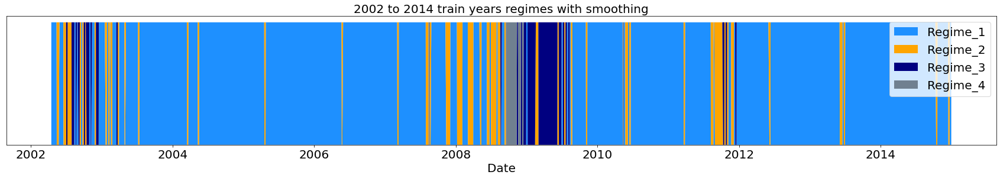

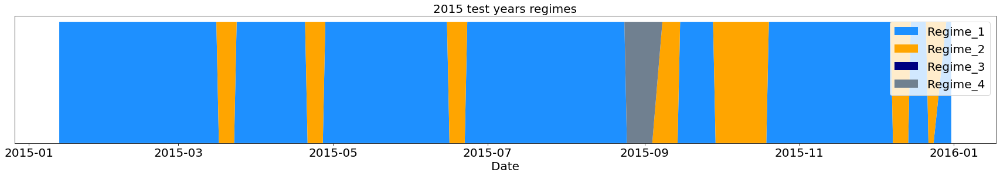

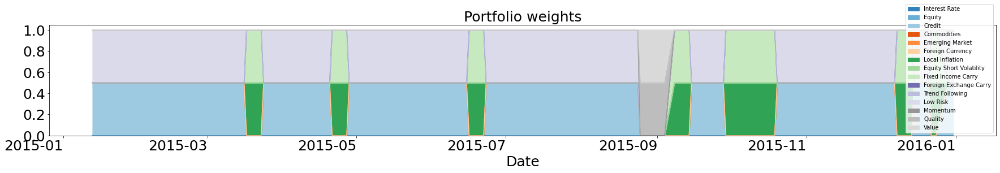

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


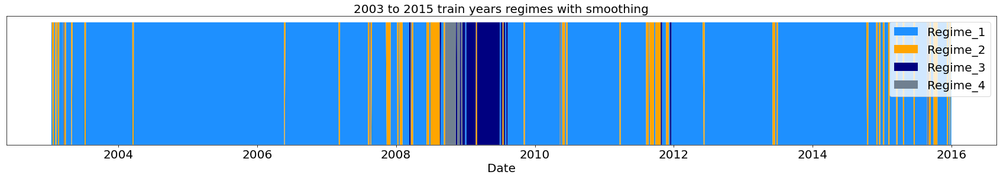

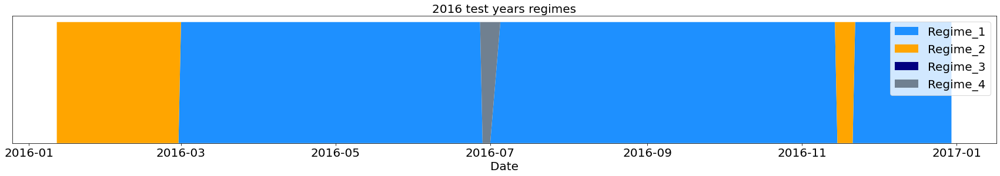

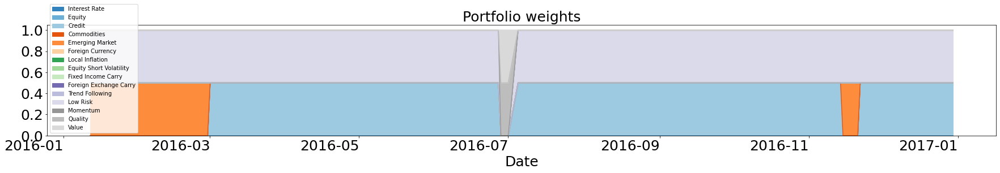

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


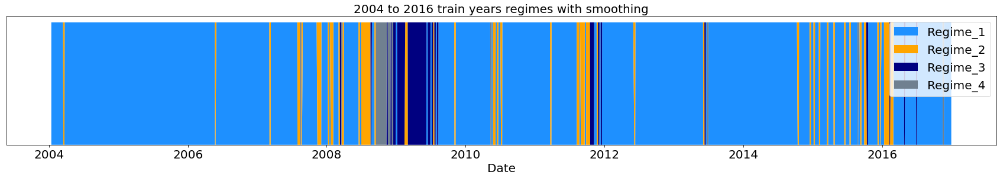

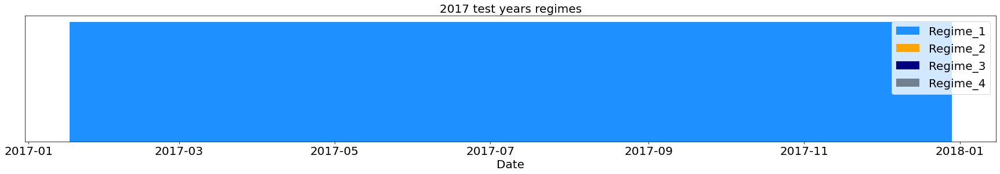

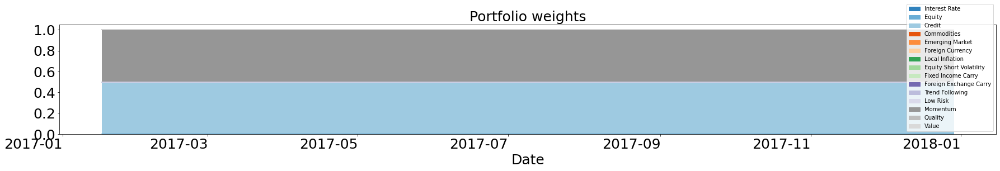

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


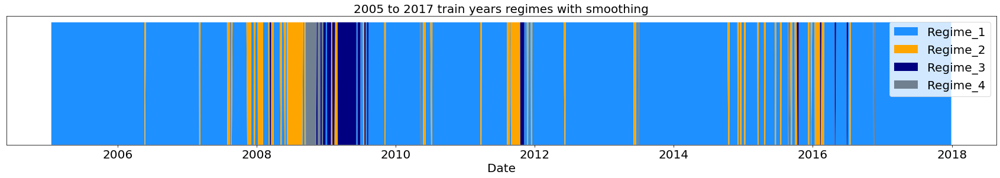

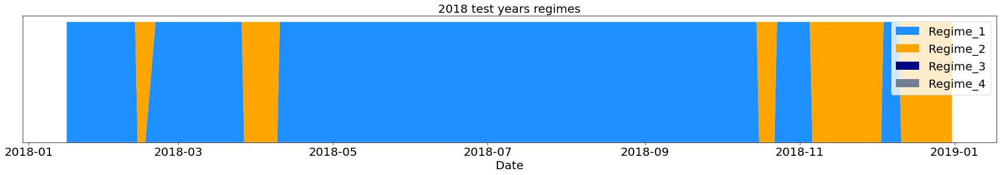

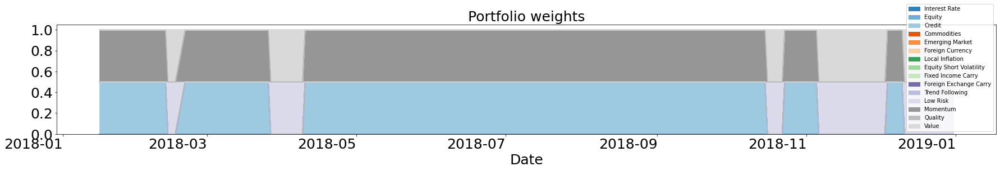

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


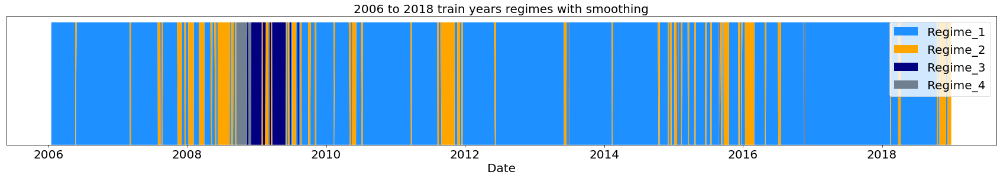

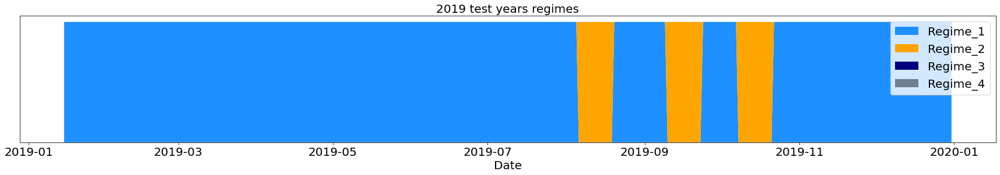

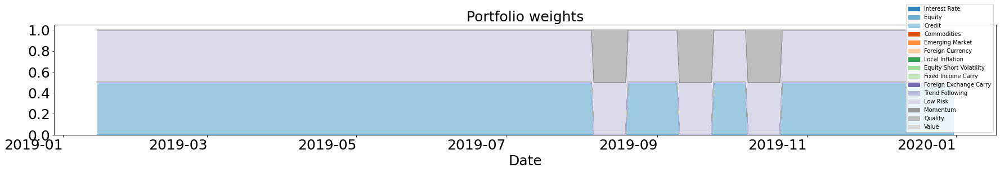

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


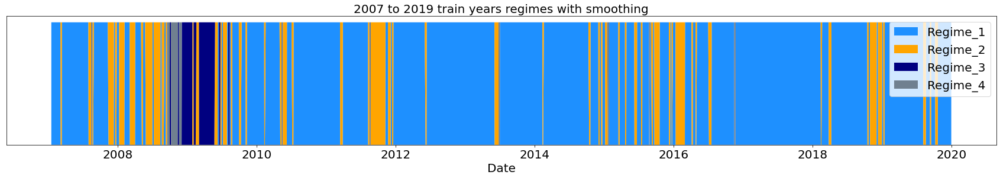

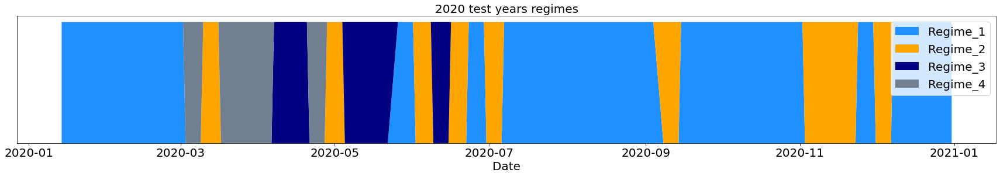

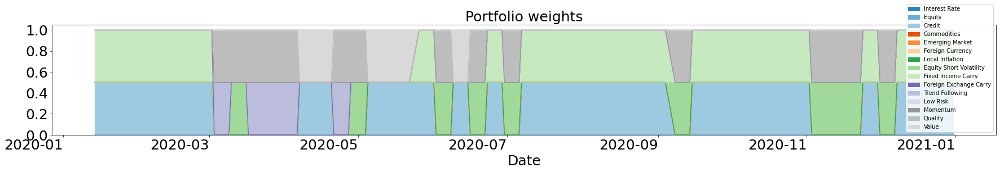

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


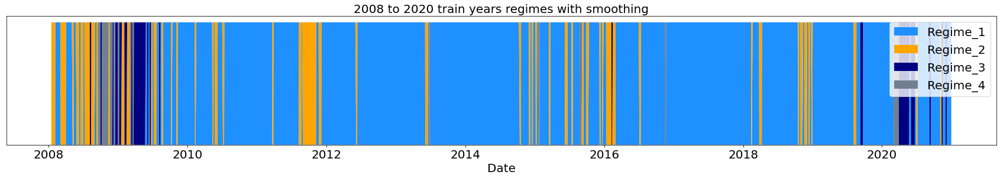

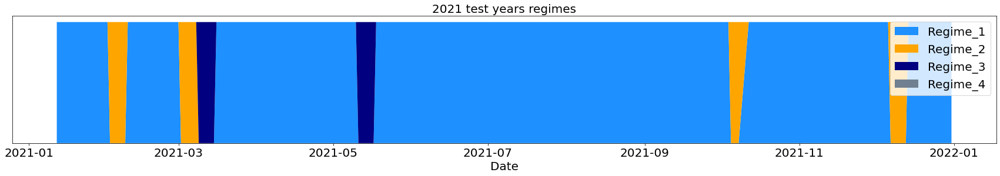

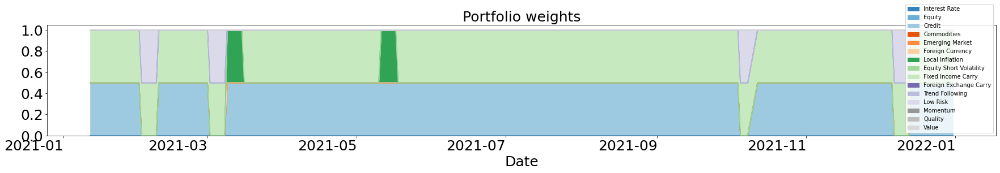

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


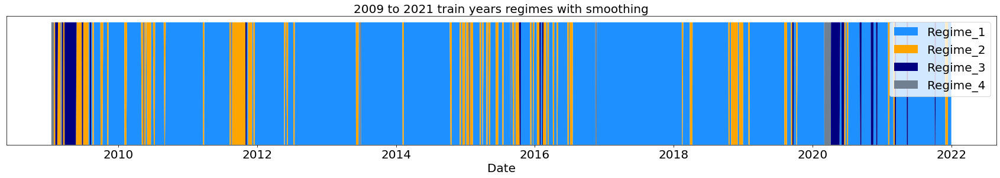

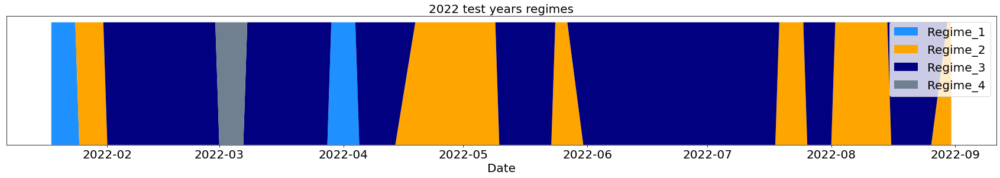

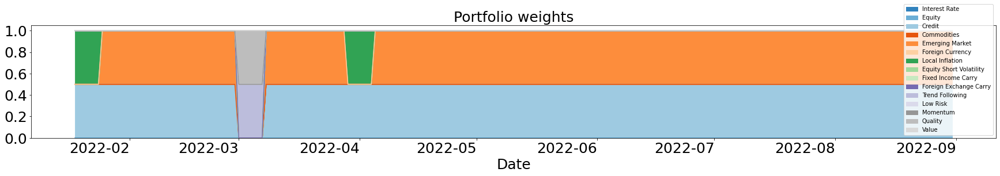

In [12]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Max_Sharpe', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = None, 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Non weighted Max Sharpe Performance
Portfolio Annual Return:  0.00414924192487276,  Baseline Annual Return: -0.009120403770928598
Portfolio Sharpe Ratio:  0.1038080118808091,  Baseline Sharpe Ratio: -0.21437949358587954
Portfolio Max Drawdown:  0.2117832131082269,  Baseline Max Drawdown: 0.15009699576028257
Portfolio Calmar Ratio:  0.029388576980778288,  Baseline Calmar Ratio: -0.05570744260796211


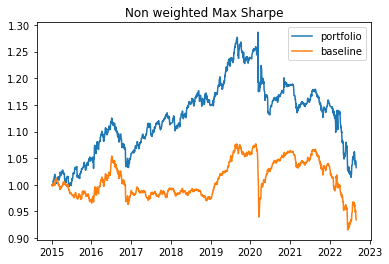

In [13]:
pnl_analysis(pnl_total, pnl_base_total, 'Non weighted Max Sharpe')

In [14]:
regime_top_sharpe = (1 + pnl_total).cumprod()
no_regime_top_sharpe = (1 + pnl_base_total).cumprod()

## **MARKOWITZ**

### **ORIGINAL**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


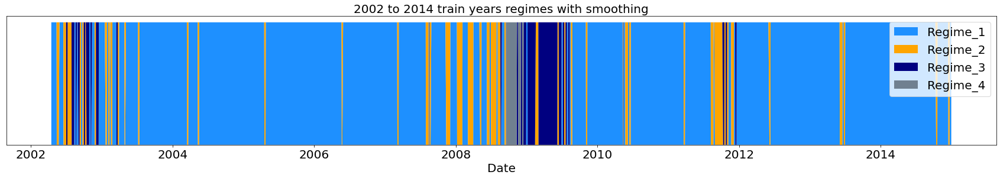

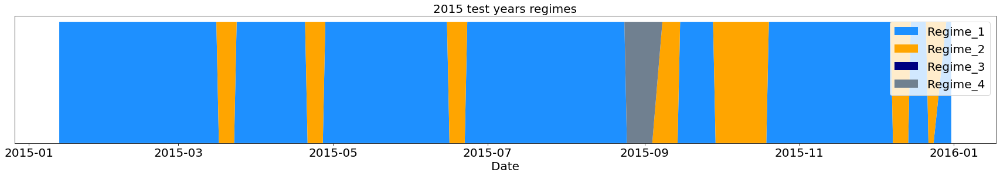

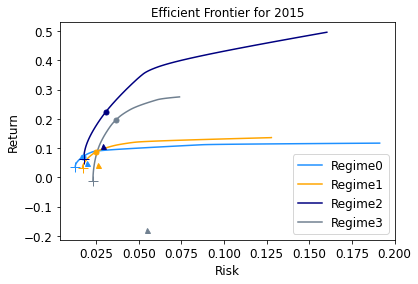

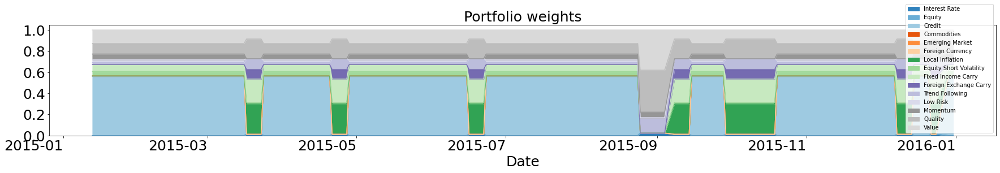

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


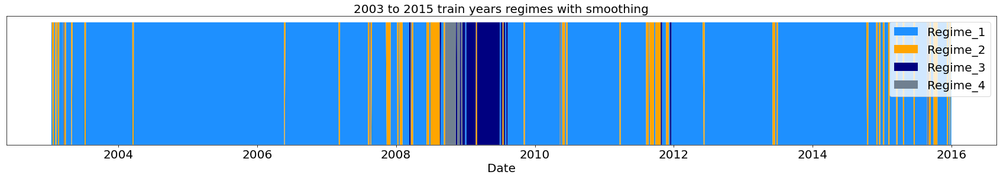

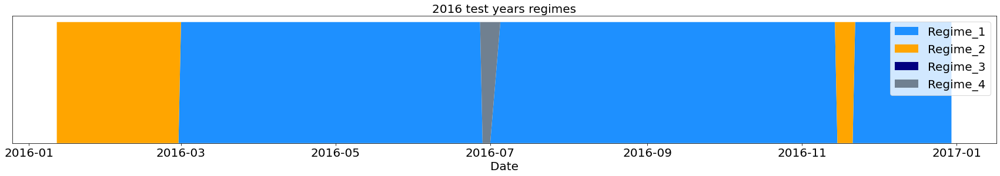

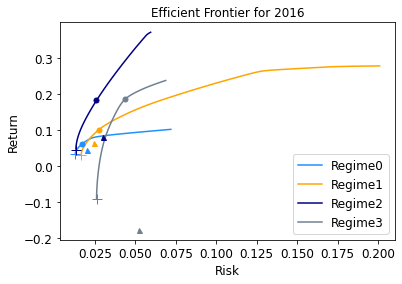

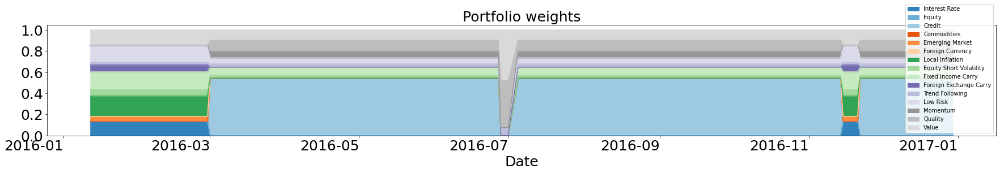

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


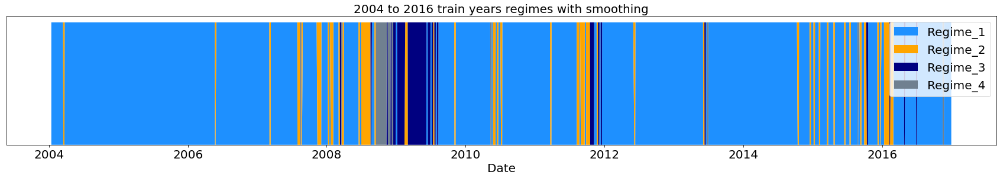

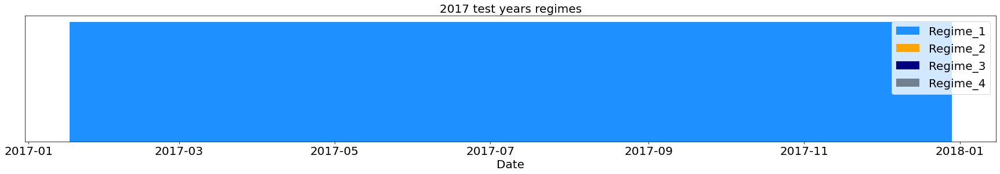

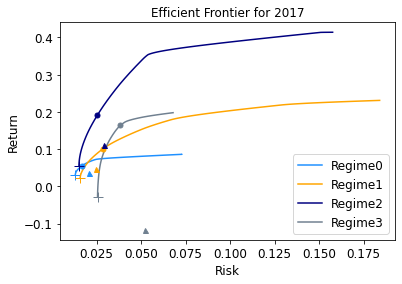

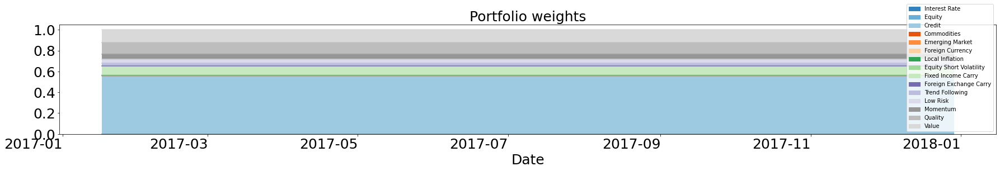

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


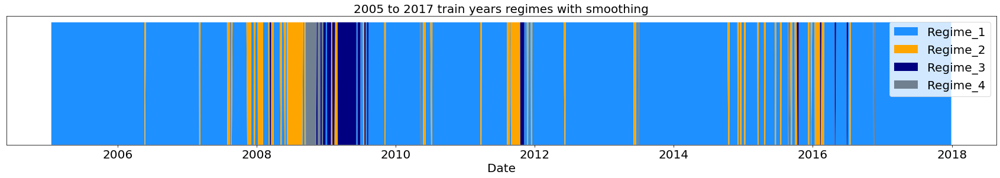

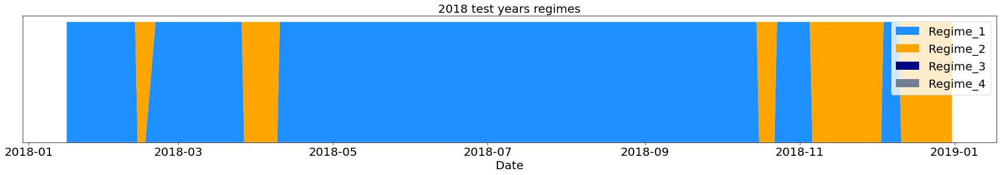

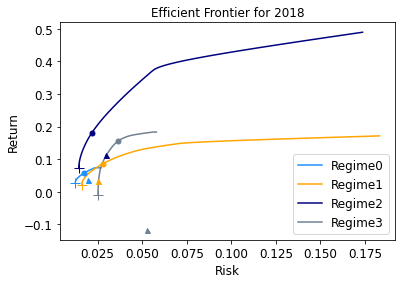

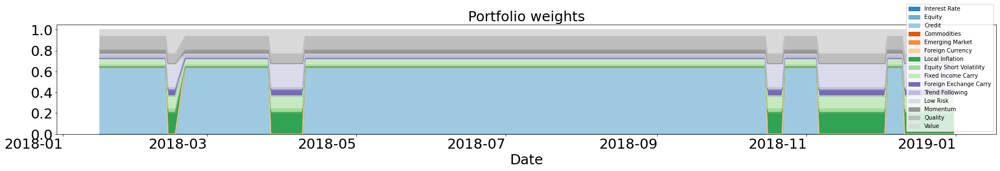

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


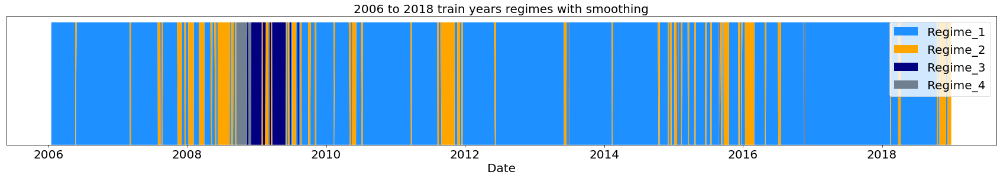

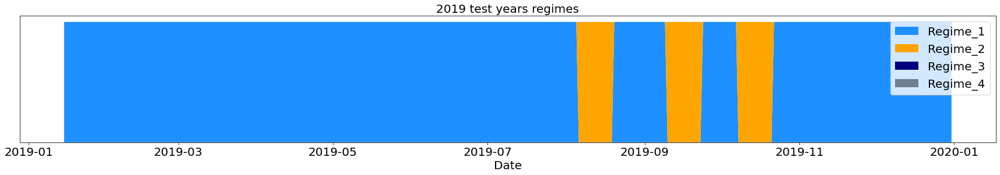

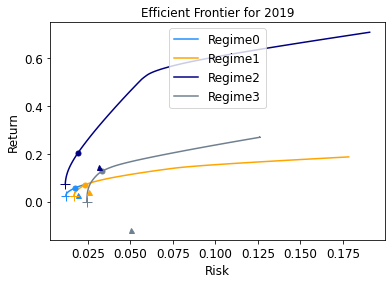

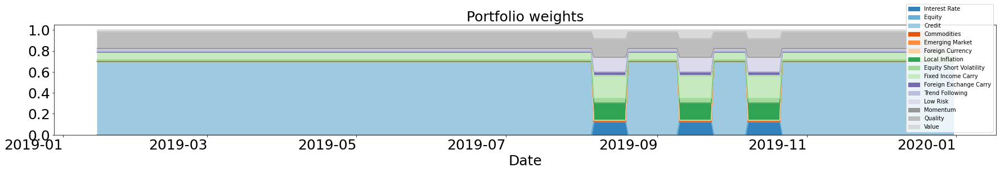

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


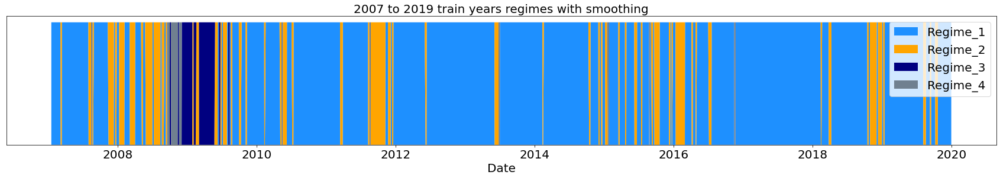

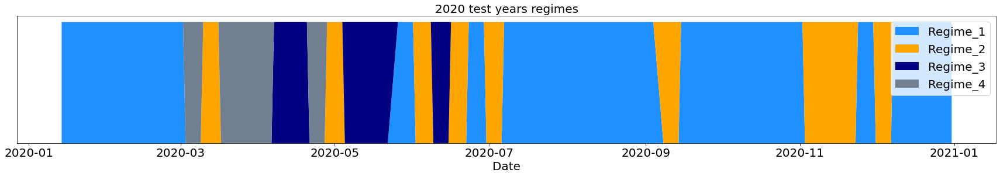

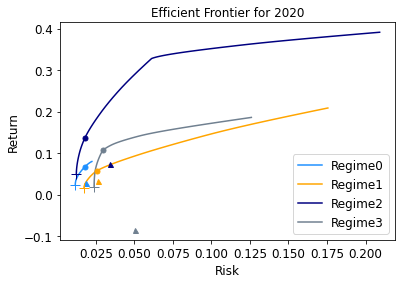

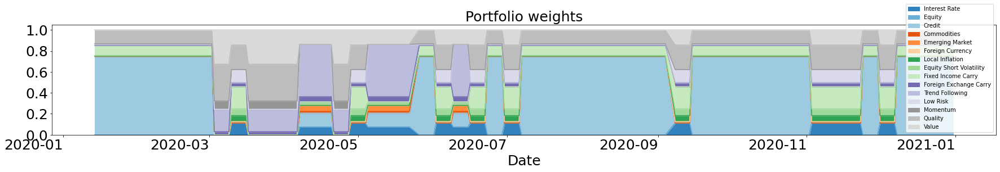

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


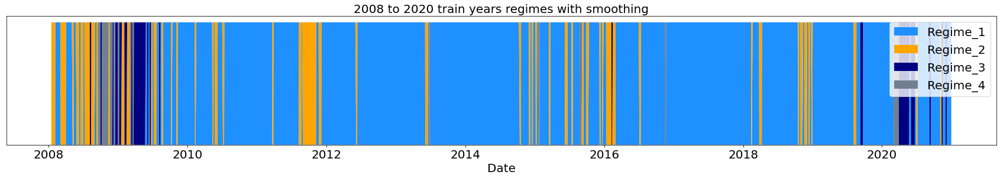

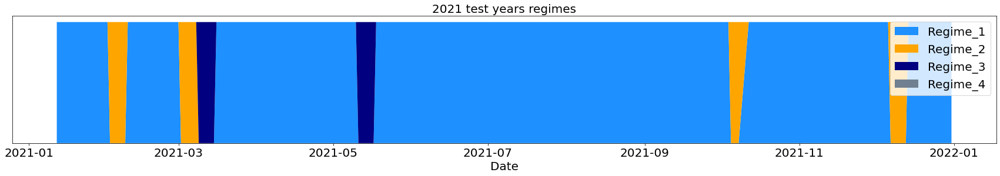

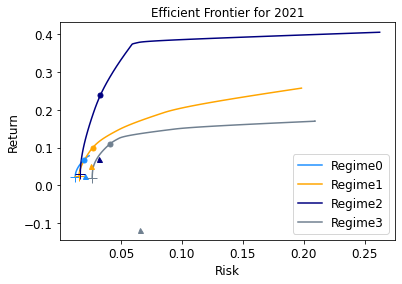

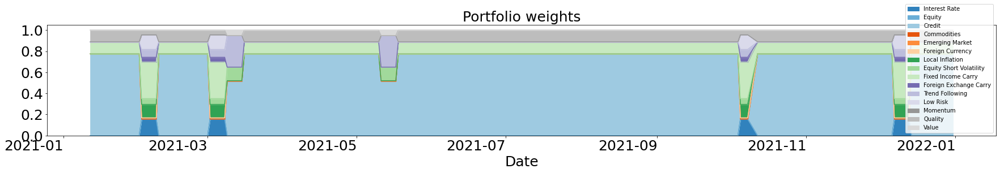

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


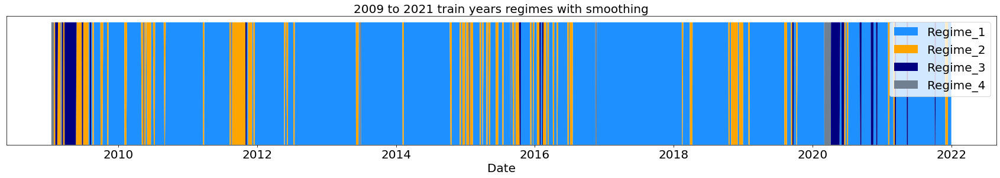

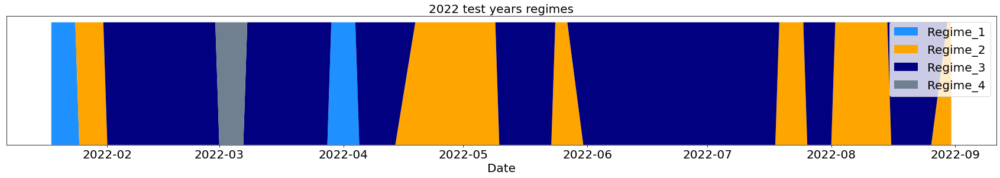

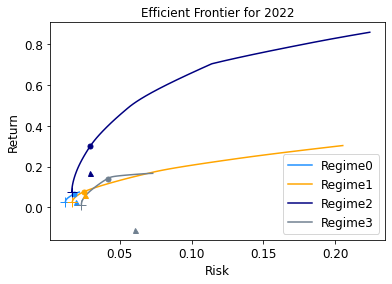

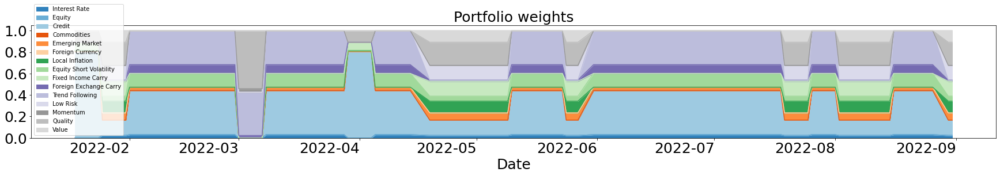

In [15]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Non-weighted Markowitz Performance
Portfolio Annual Return:  0.023027095440091516,  Baseline Annual Return: 0.002681984926596659
Portfolio Sharpe Ratio:  0.9528183253740224,  Baseline Sharpe Ratio: 0.11748385622774155
Portfolio Max Drawdown:  0.05421250067408179,  Baseline Max Drawdown: 0.11132315461956288
Portfolio Calmar Ratio:  0.4265774631711141,  Baseline Calmar Ratio: 0.02805912749399061


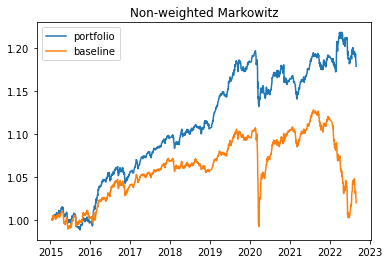

In [16]:
pnl_analysis(pnl_total, pnl_base_total, 'Non-weighted Markowitz')

In [17]:
regime_markowitz = (1 + pnl_total).cumprod()
no_regime_markowitz = (1 + pnl_base_total).cumprod()

### **WEIGHTED PORTFOLIOS WITH PROBABILITY**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


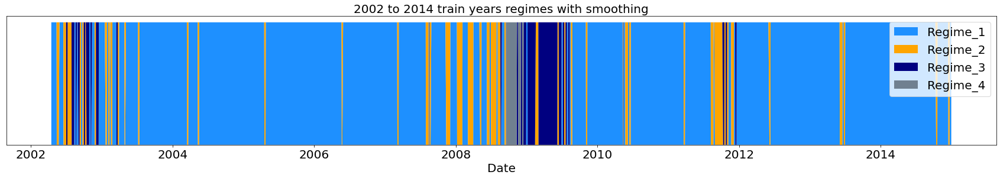

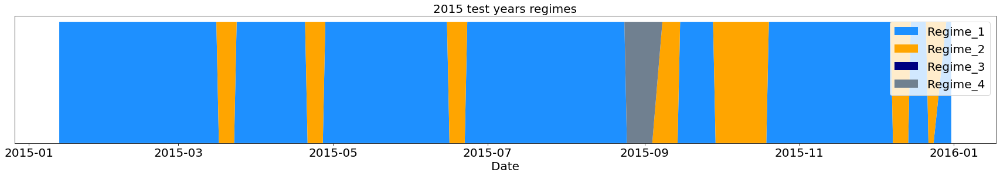

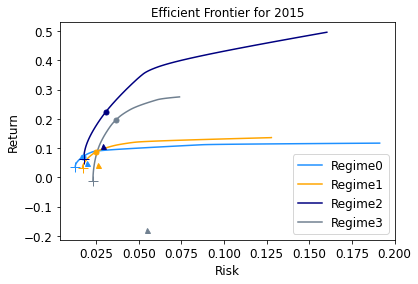

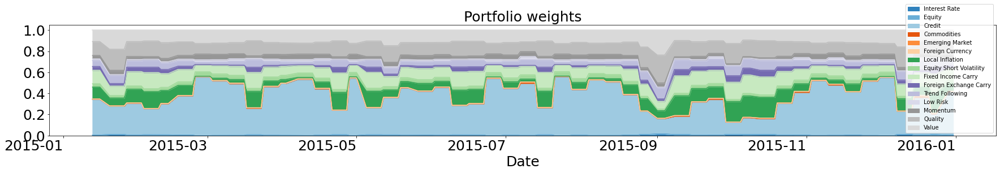

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


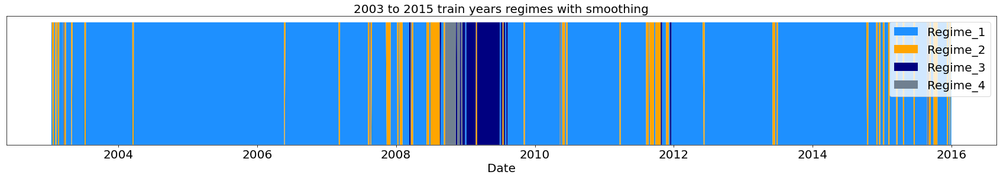

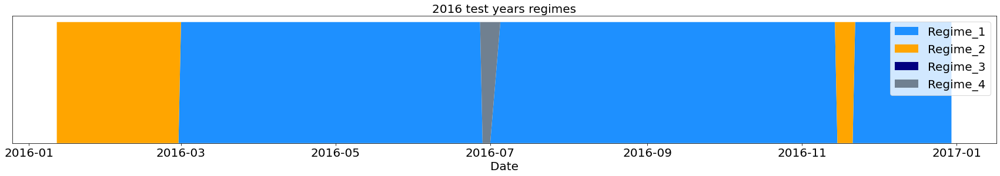

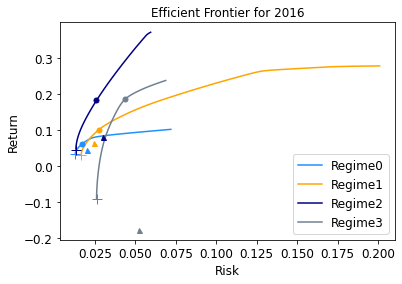

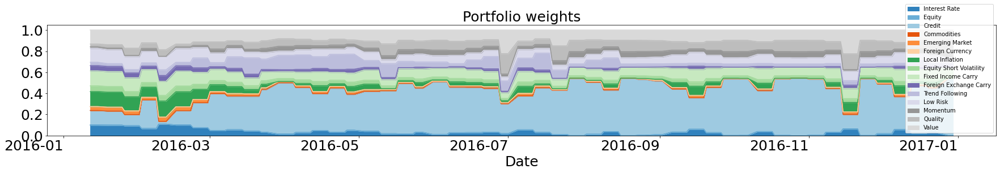

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


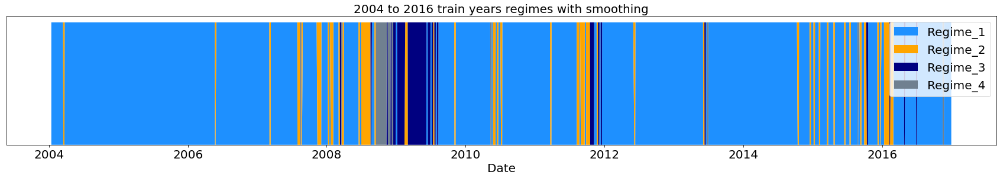

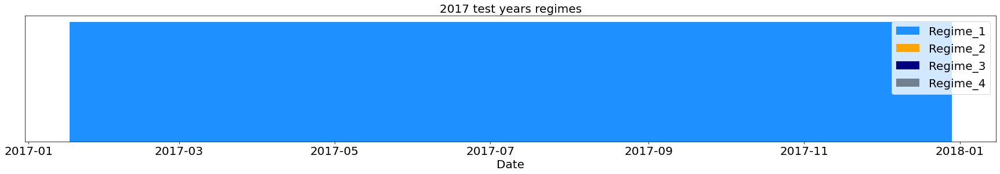

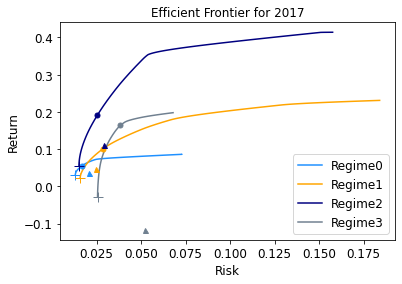

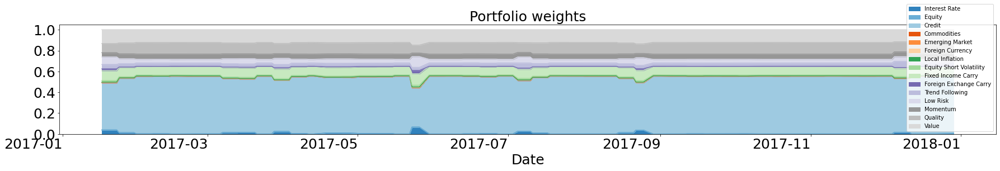

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


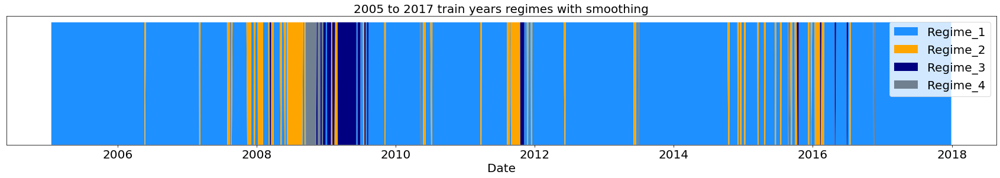

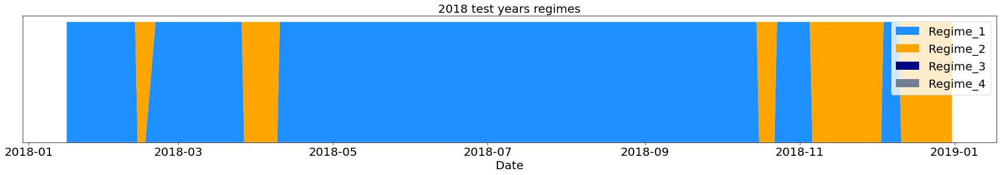

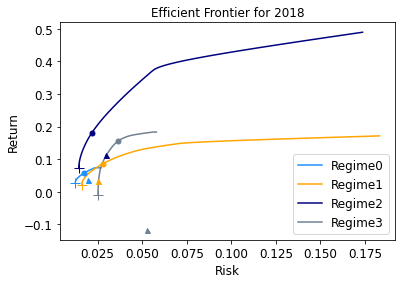

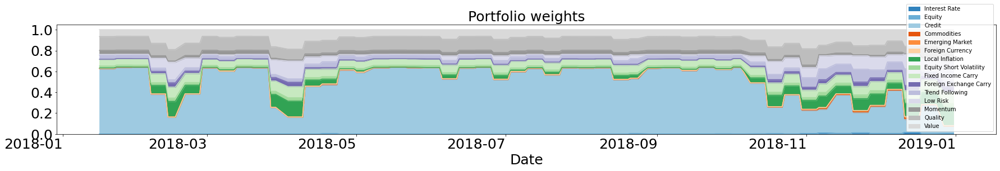

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


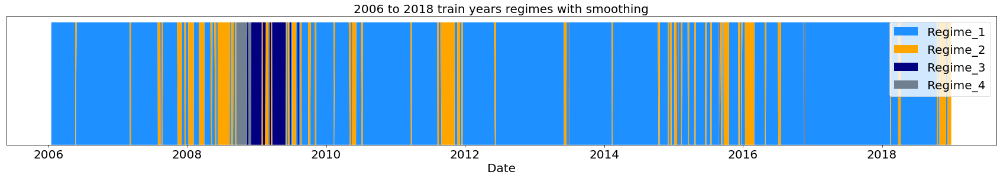

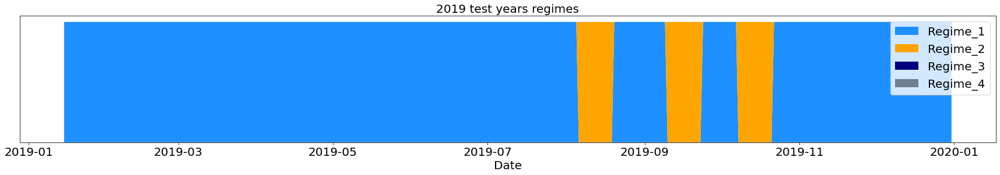

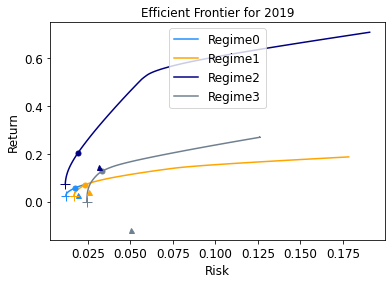

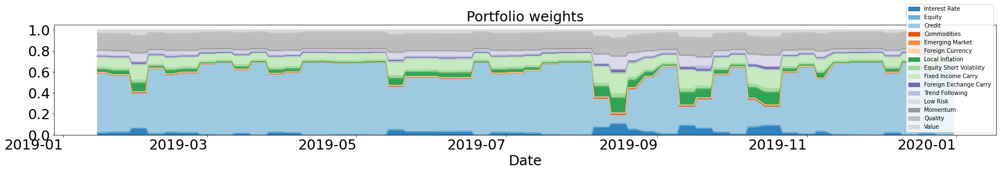

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


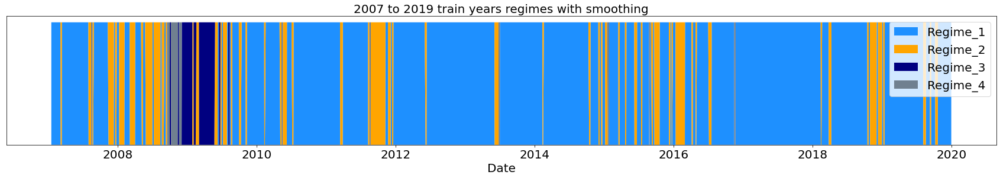

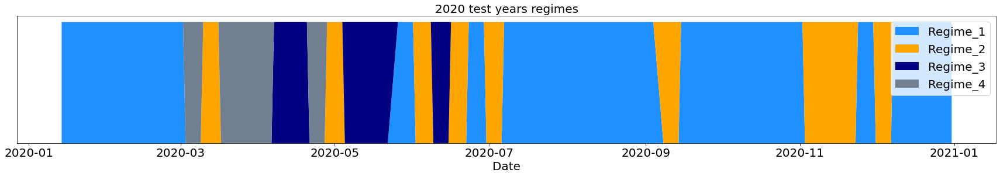

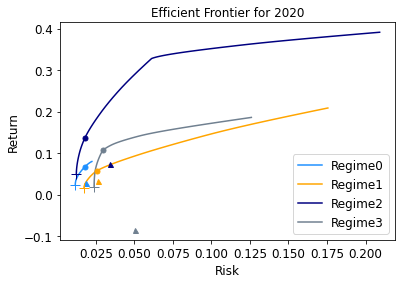

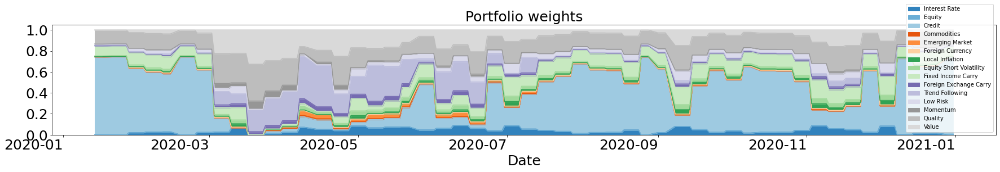

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


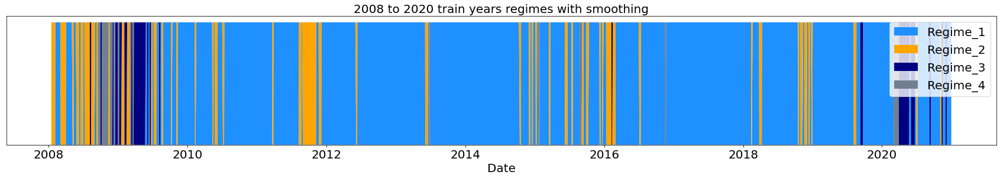

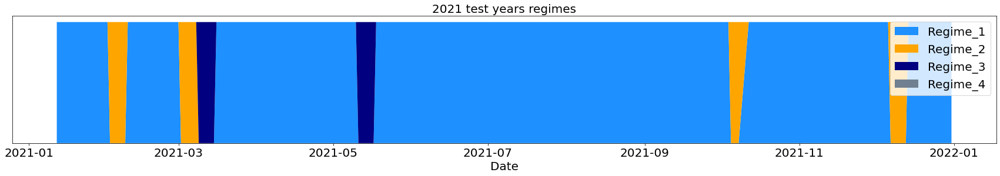

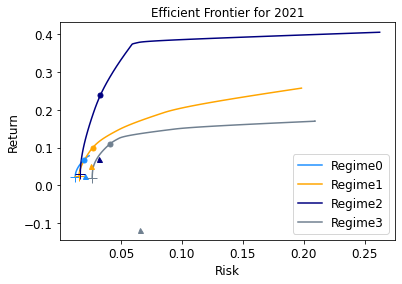

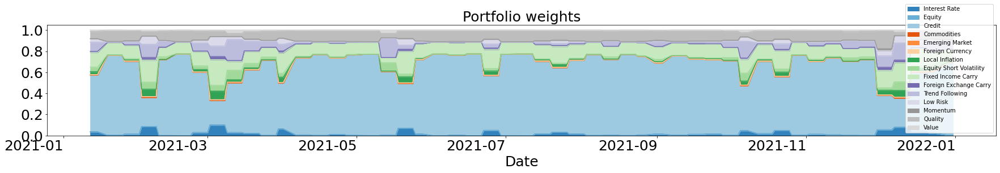

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


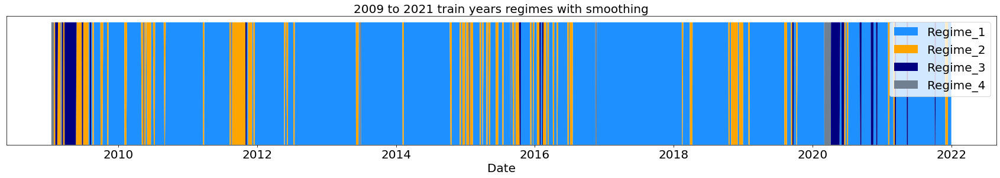

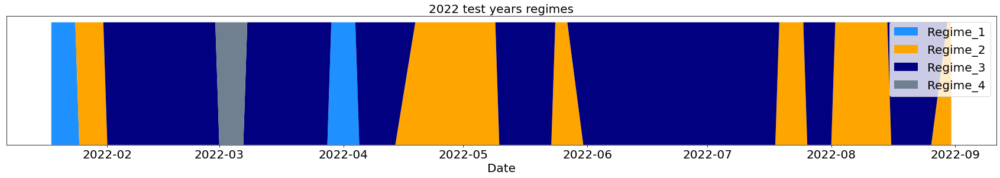

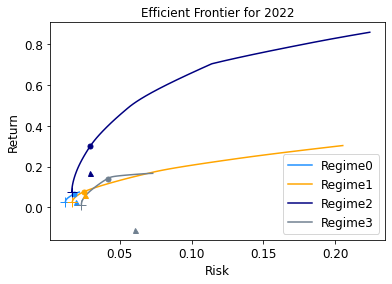

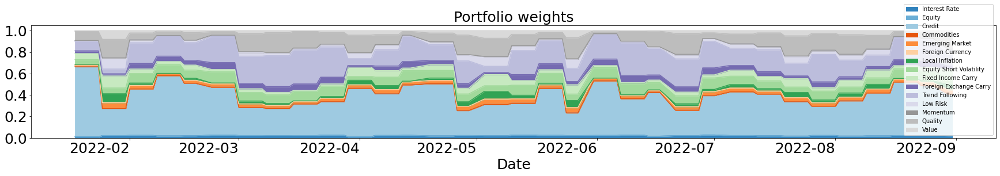

In [18]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = True, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz Performance
Portfolio Annual Return:  0.01613492733283417,  Baseline Annual Return: 0.002681984926596659
Portfolio Sharpe Ratio:  0.7576062162428145,  Baseline Sharpe Ratio: 0.11748385622774155
Portfolio Max Drawdown:  0.04490511773231032,  Baseline Max Drawdown: 0.11132315461956288
Portfolio Calmar Ratio:  0.362659481068343,  Baseline Calmar Ratio: 0.02805912749399061


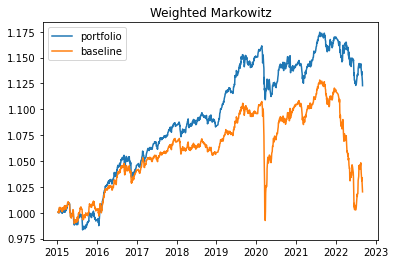

In [19]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz')

In [20]:
weighted_markowitz = (1 + pnl_total).cumprod()

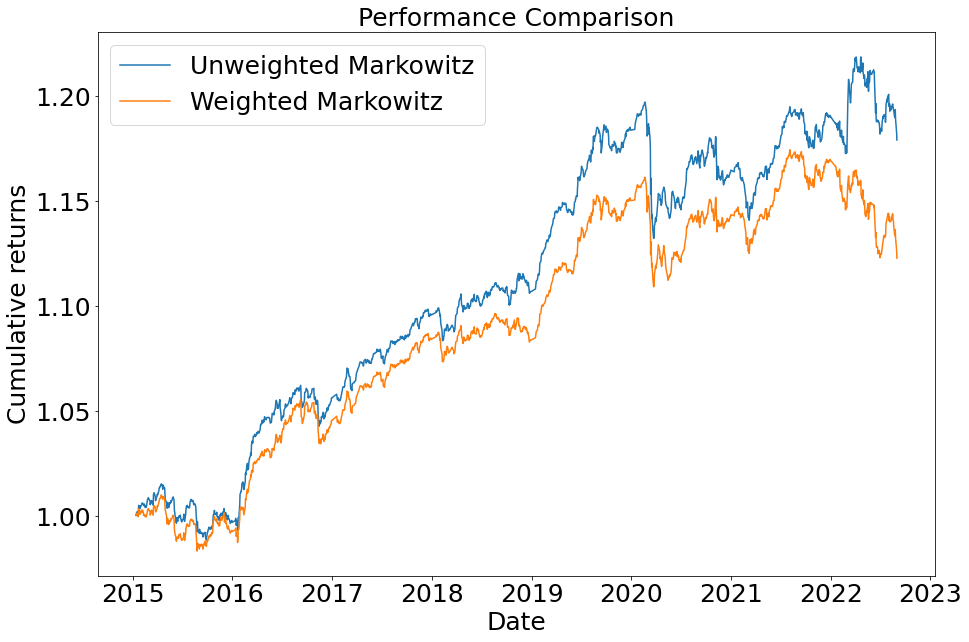

In [21]:
plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Unweighted Markowitz")
plt.plot(weighted_markowitz, label = "Weighted Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **WEEKLY DATA FOR REGIME DETECTION**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


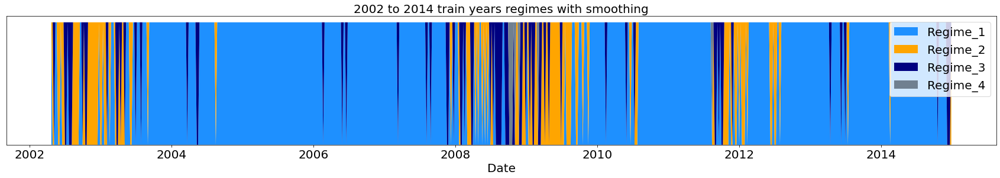

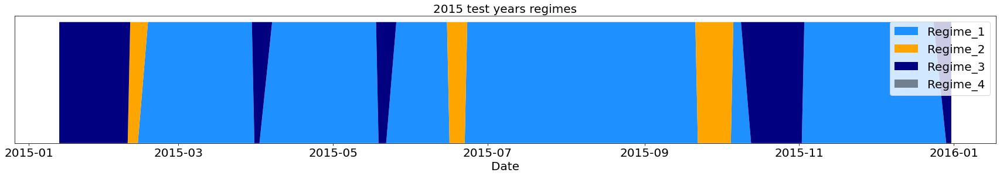

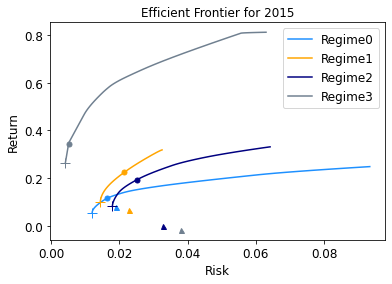

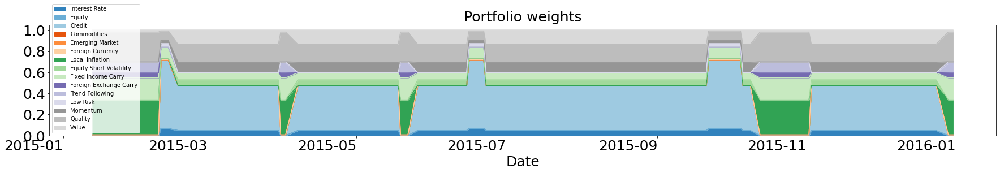

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


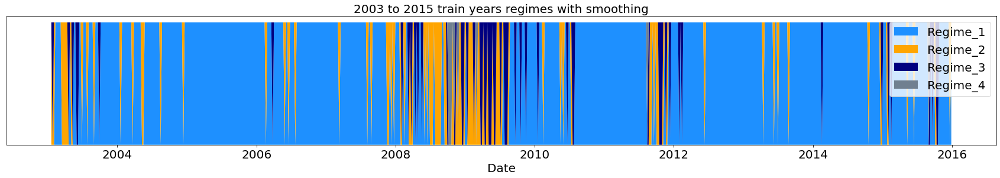

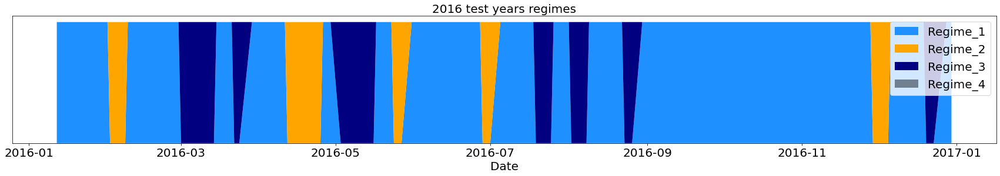

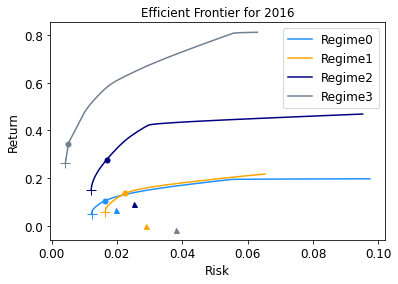

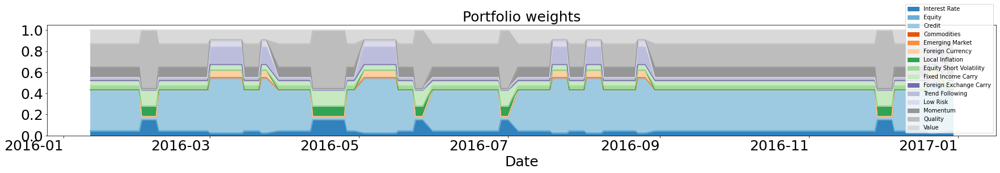

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


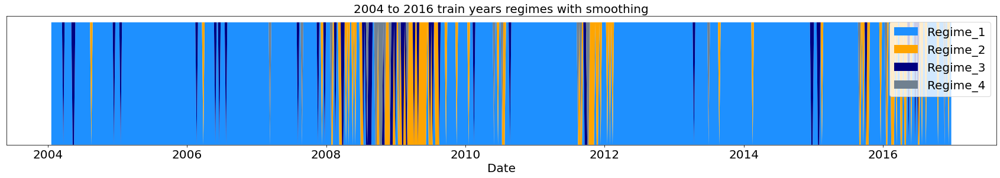

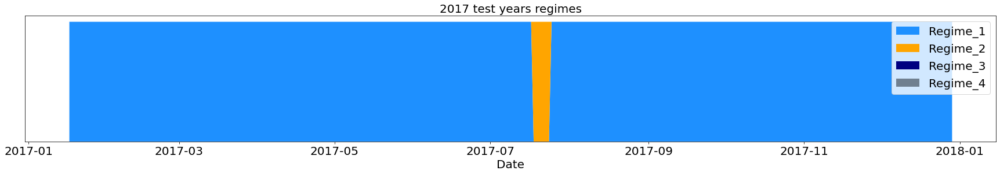

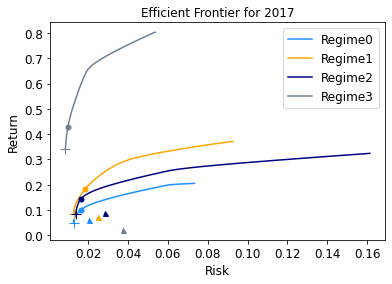

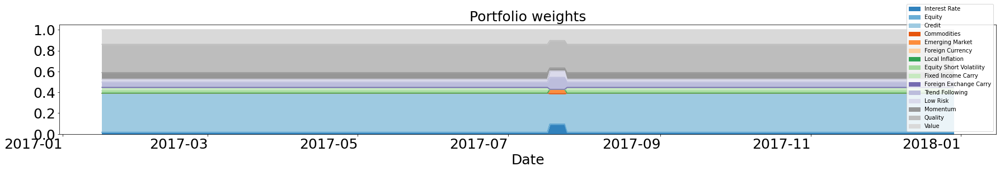

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


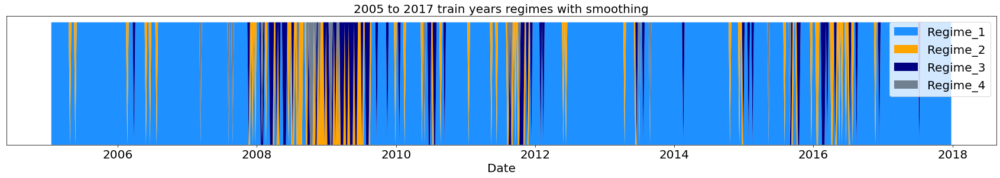

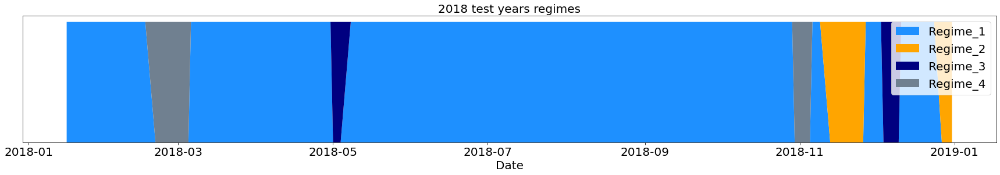

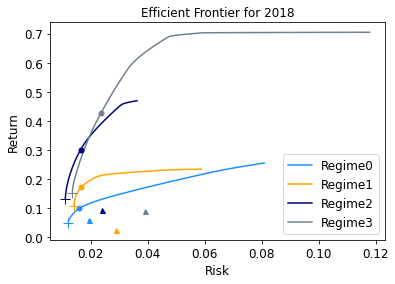

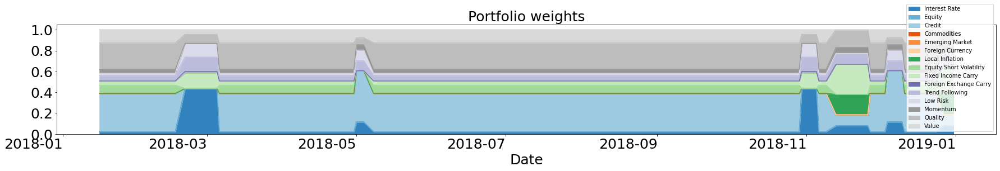

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


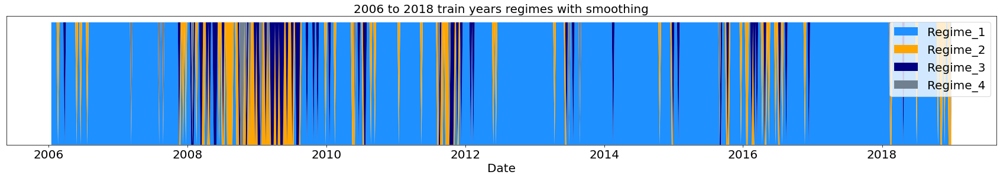

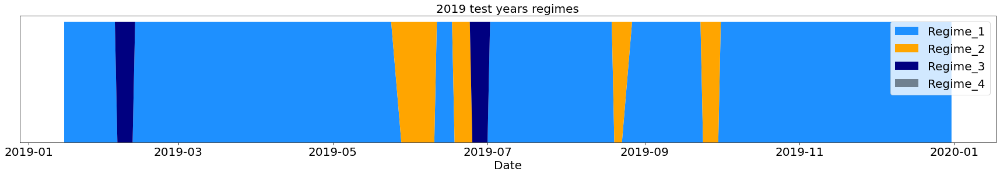

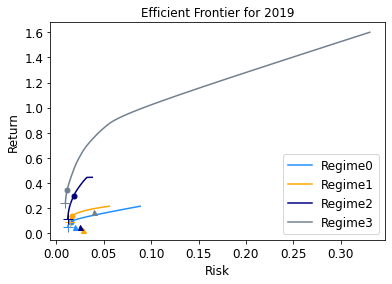

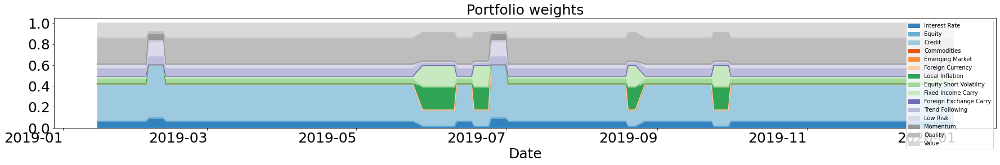

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


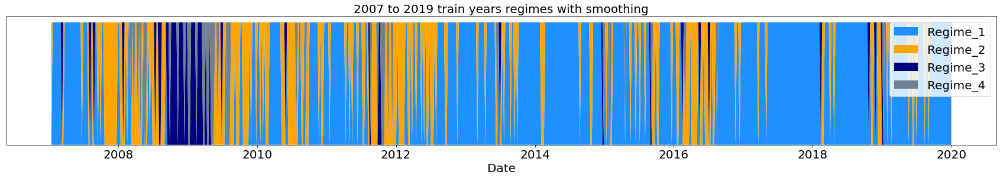

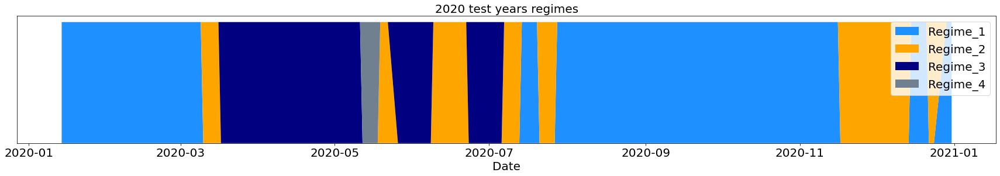

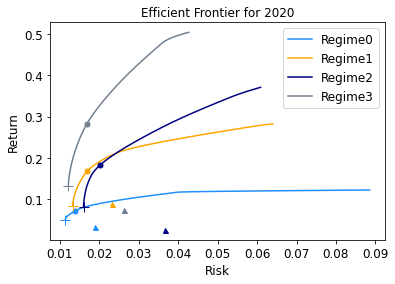

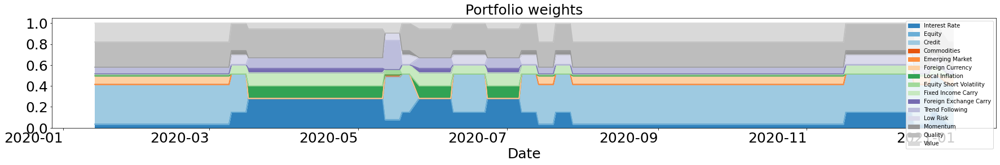

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


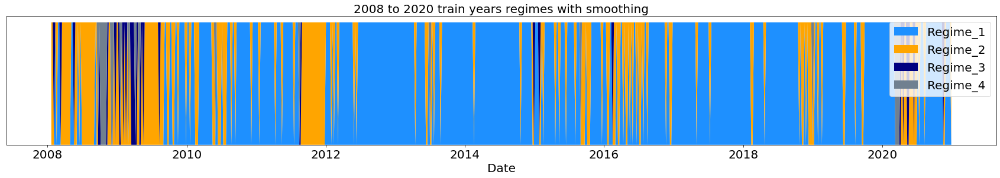

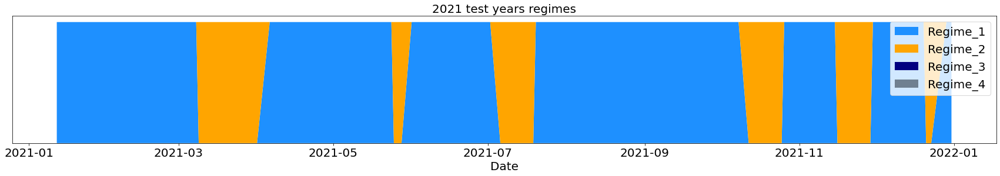

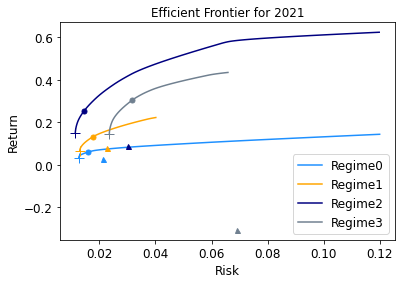

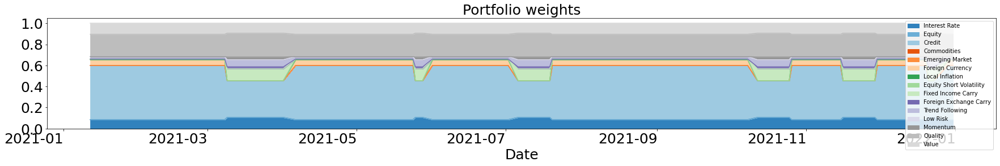

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


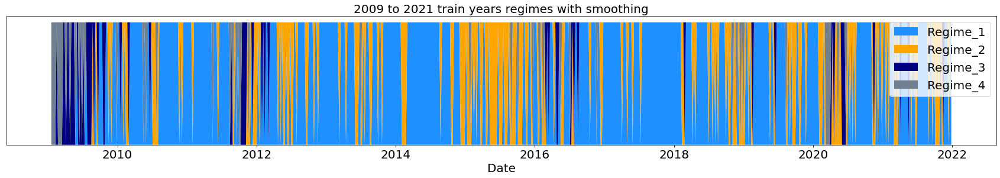

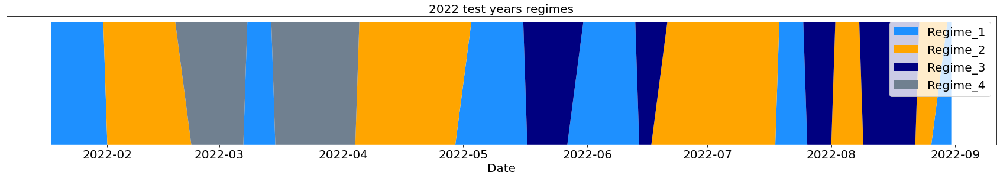

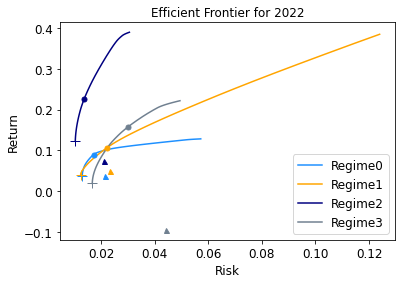

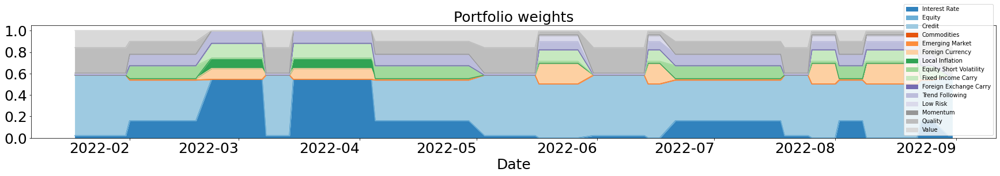

In [22]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = True, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz weekly data for detection Performance
Portfolio Annual Return:  0.0029781477140282675,  Baseline Annual Return: 0.002681984926596659
Portfolio Sharpe Ratio:  0.1375554311575555,  Baseline Sharpe Ratio: 0.11748385622774155
Portfolio Max Drawdown:  0.08229116419313354,  Baseline Max Drawdown: 0.11132315461956288
Portfolio Calmar Ratio:  0.04088738132706537,  Baseline Calmar Ratio: 0.02805912749399061


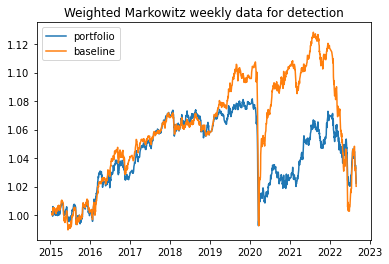

In [23]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz weekly data for detection')

In [24]:
weekly_markowitz = (1 + pnl_total).cumprod()

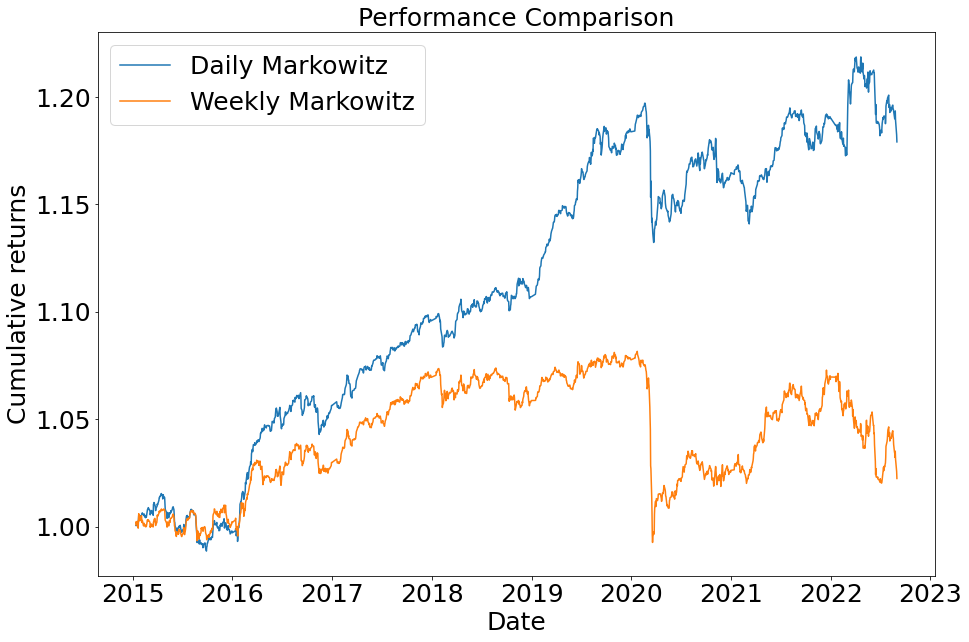

In [25]:
plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Daily Markowitz")
plt.plot(weekly_markowitz, label = "Weekly Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **EXPANDING WINDOW TRAINING**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


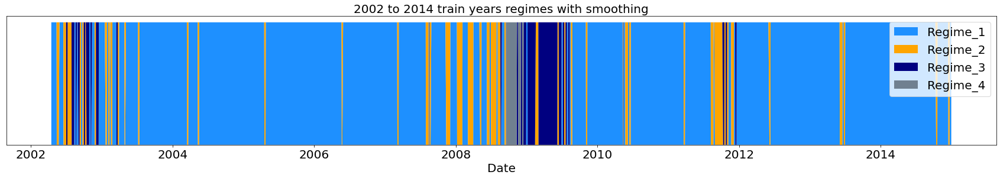

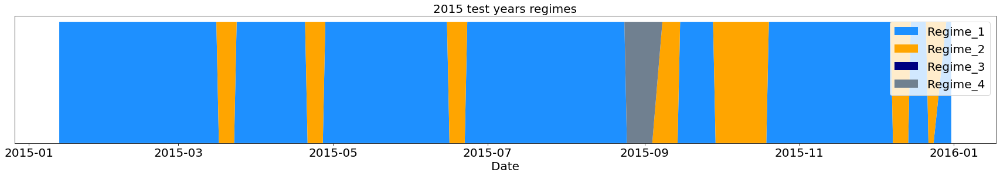

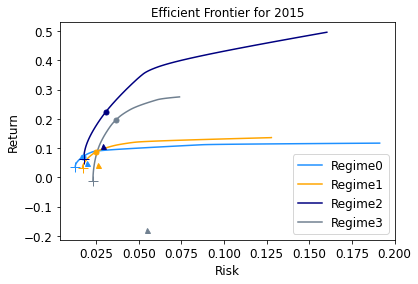

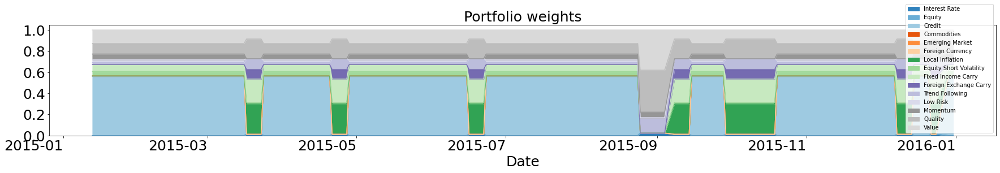

Training on years 2002 to 2015
Testing on year 2016
Optimal number of regimes: 4


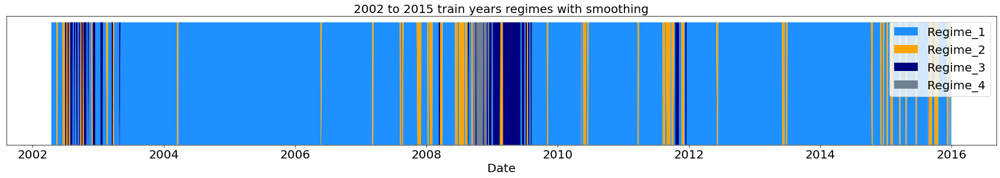

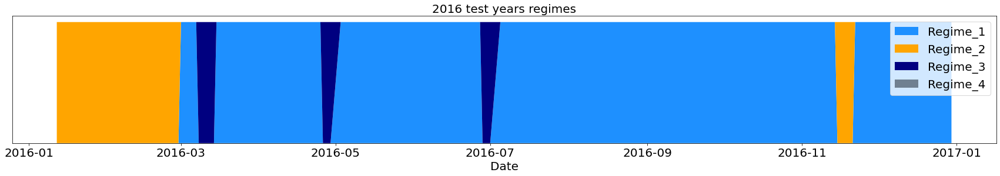

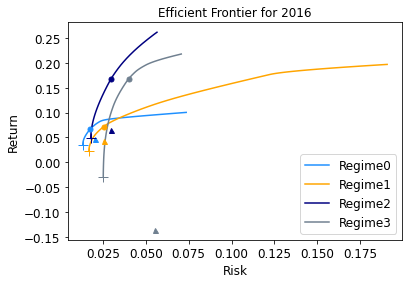

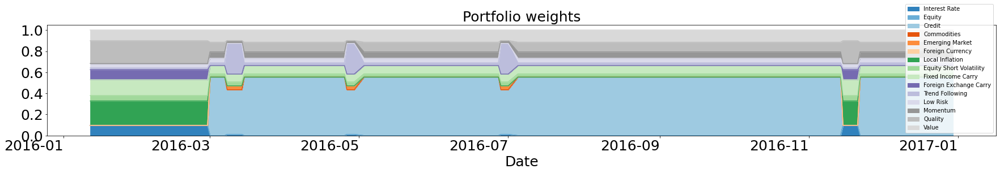

Training on years 2002 to 2016
Testing on year 2017
Optimal number of regimes: 4


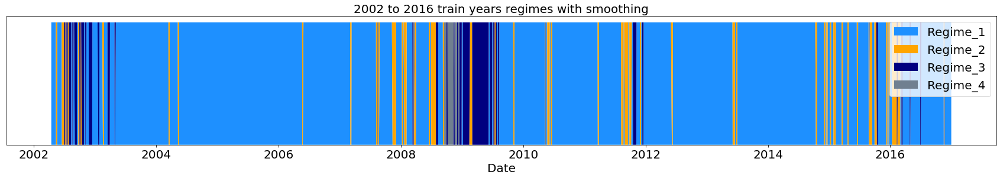

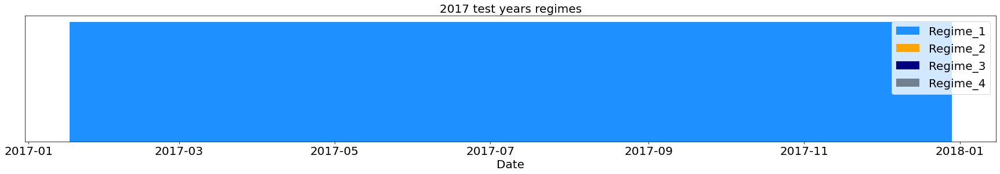

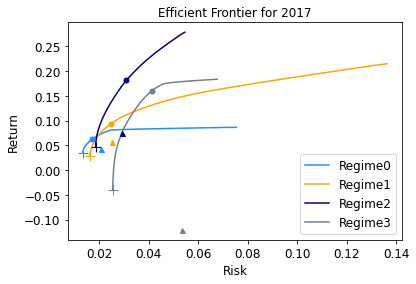

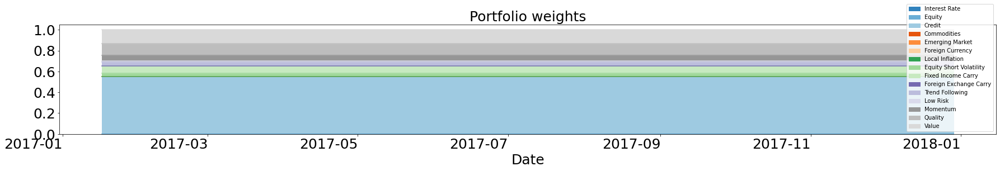

Training on years 2002 to 2017
Testing on year 2018
Optimal number of regimes: 4


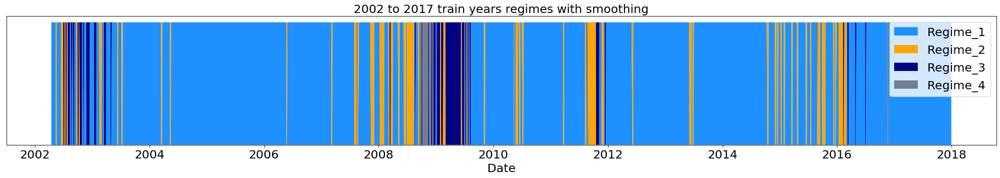

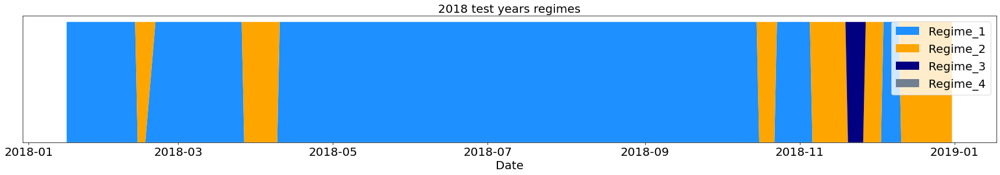

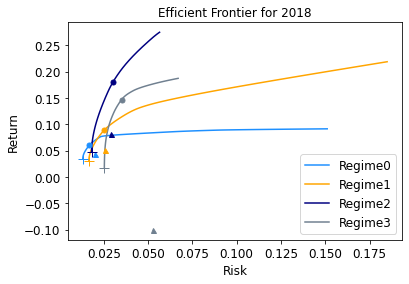

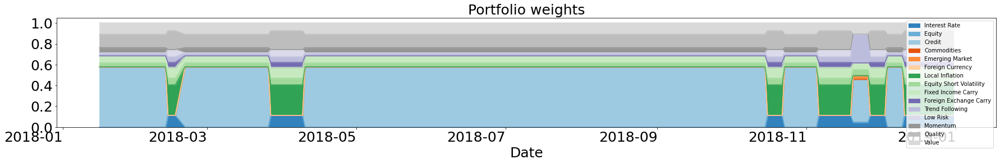

Training on years 2002 to 2018
Testing on year 2019
Optimal number of regimes: 4


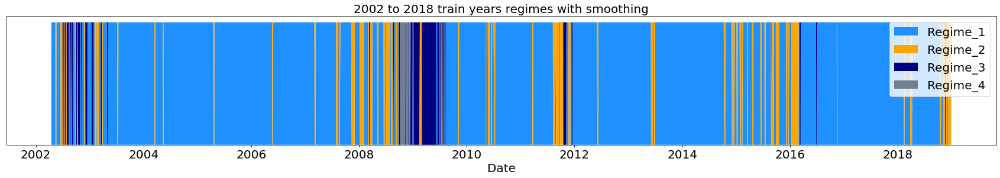

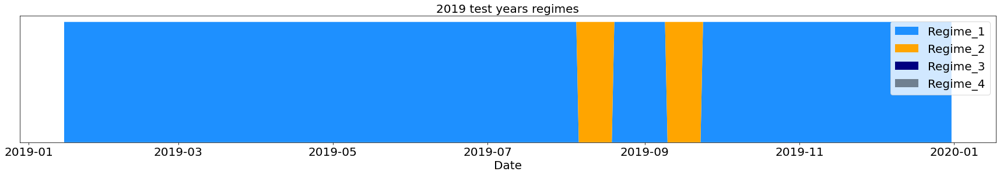

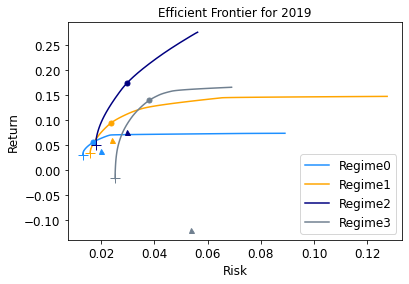

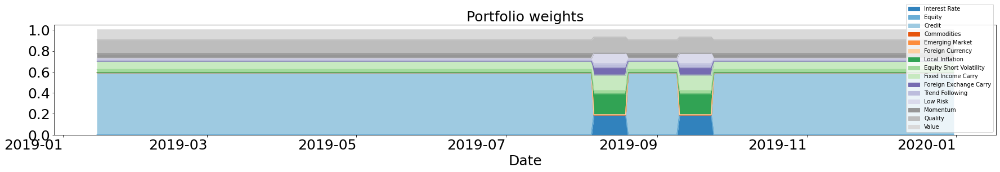

Training on years 2002 to 2019
Testing on year 2020
Optimal number of regimes: 4


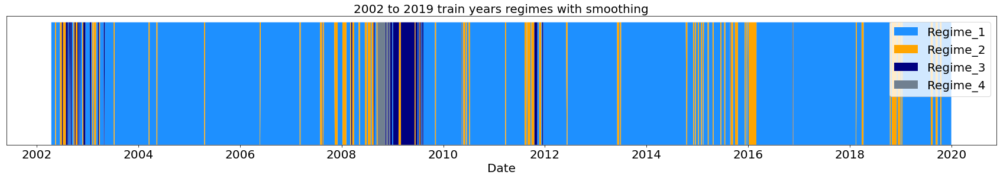

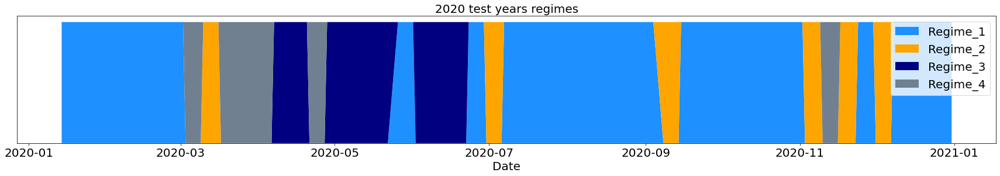

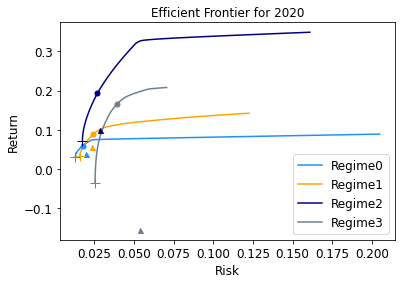

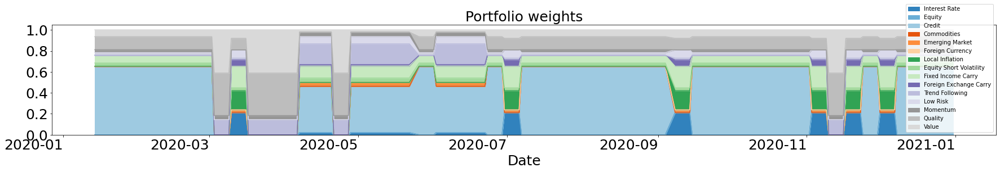

Training on years 2002 to 2020
Testing on year 2021
Optimal number of regimes: 4


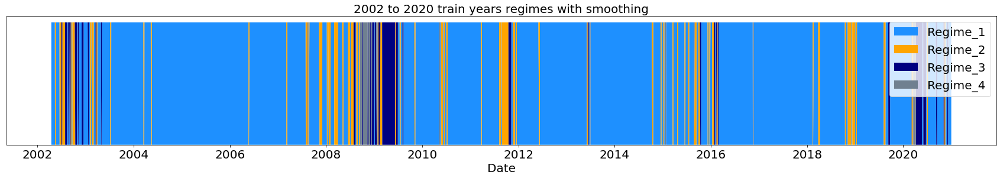

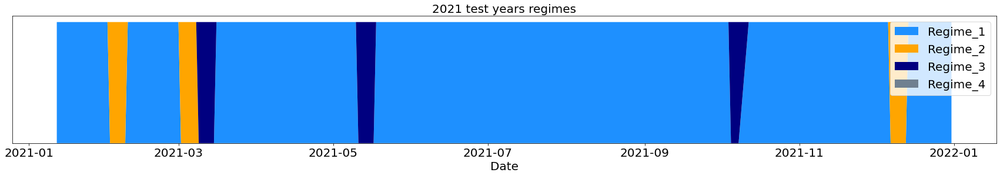

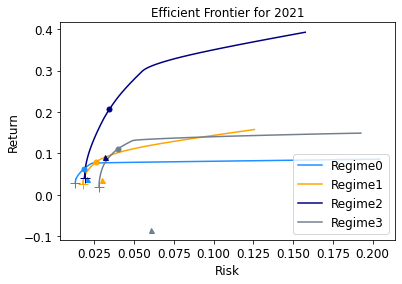

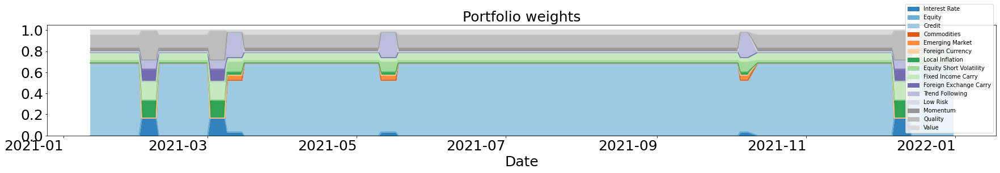

Training on years 2002 to 2021
Testing on year 2022
Optimal number of regimes: 4


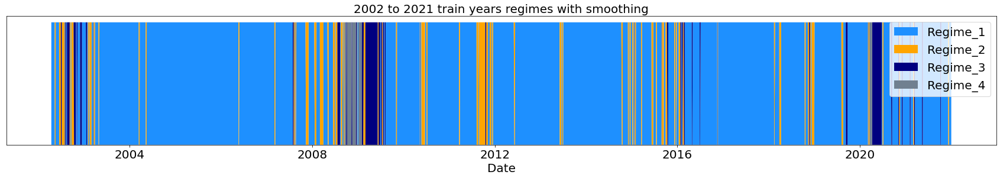

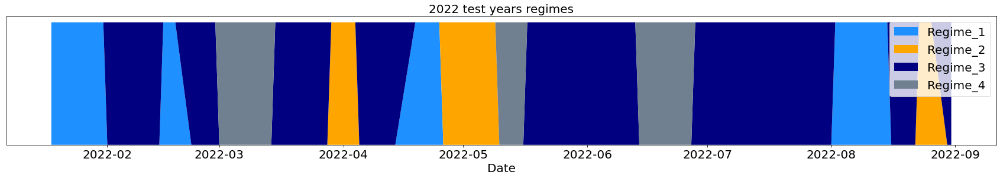

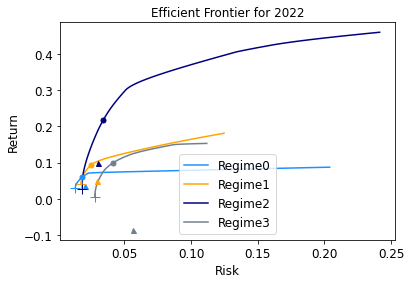

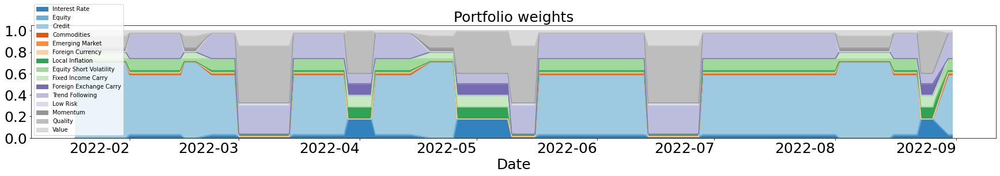

In [26]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = True, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz expanding window training Performance
Portfolio Annual Return:  0.02923374582333582,  Baseline Annual Return: 0.006281596538172174
Portfolio Sharpe Ratio:  1.2141643613223263,  Baseline Sharpe Ratio: 0.2684525119967762
Portfolio Max Drawdown:  0.062134309529565224,  Baseline Max Drawdown: 0.10304278690660396
Portfolio Calmar Ratio:  0.46944845913206135,  Baseline Calmar Ratio: 0.06464832661858196


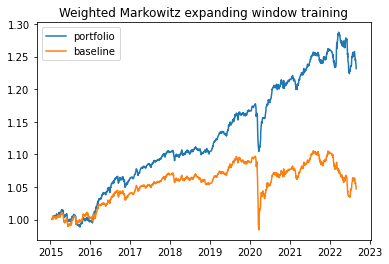

In [27]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz expanding window training')

In [28]:
expanding_markowitz = (1 + pnl_total).cumprod()

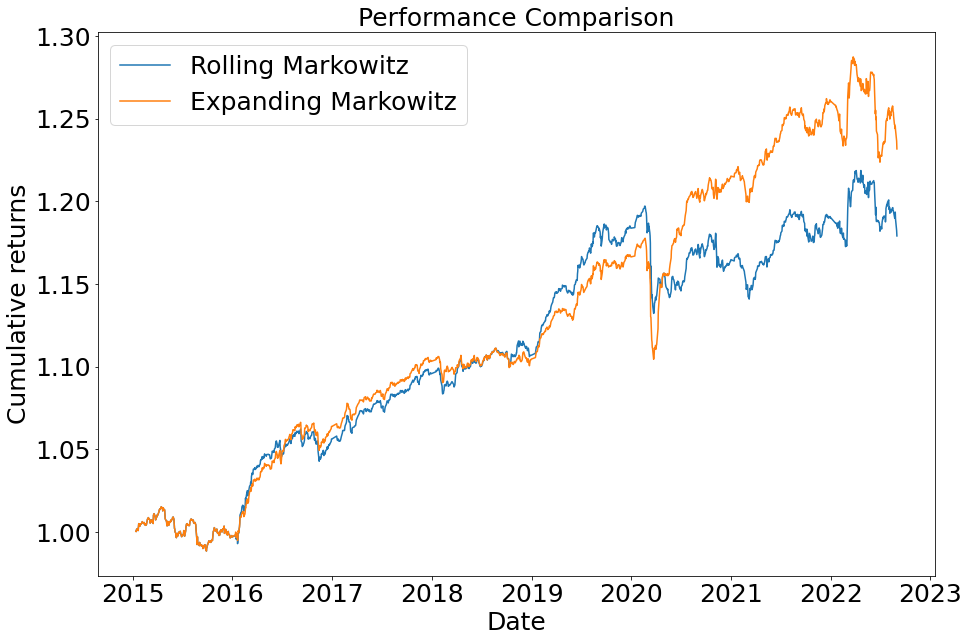

In [29]:
plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Rolling Markowitz")
plt.plot(expanding_markowitz, label = "Expanding Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **DYNAMIC NUMBER OF REGIMES**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 3


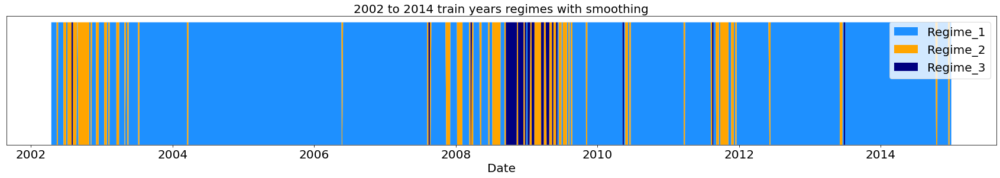

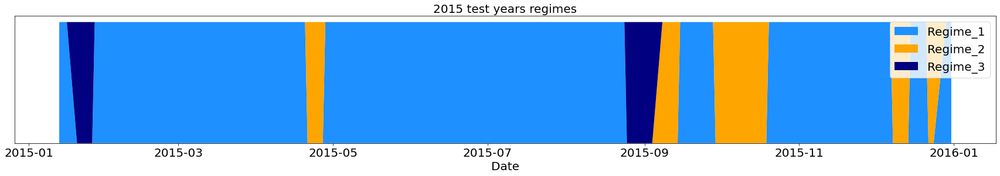

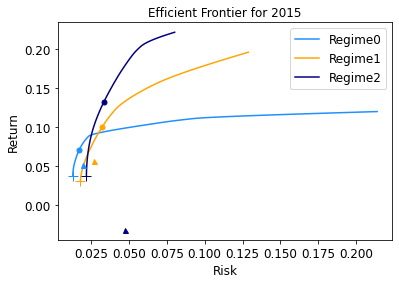

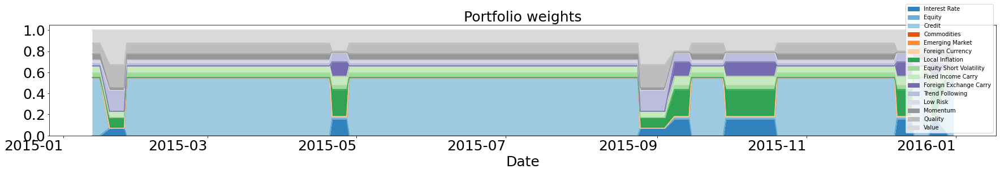

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 3


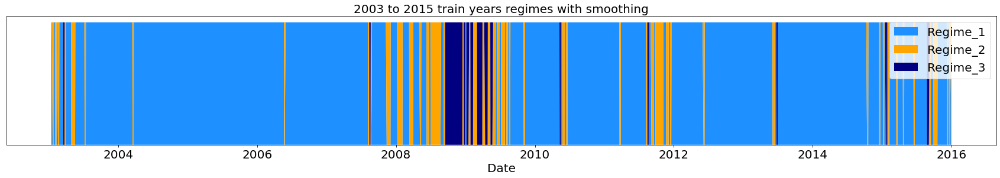

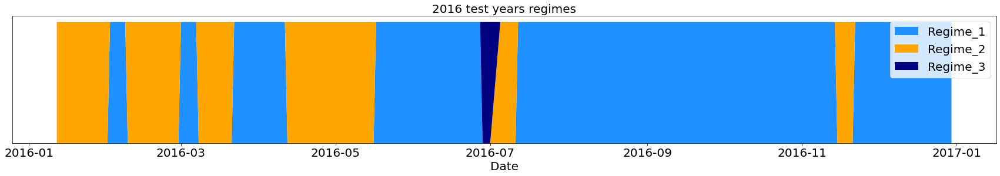

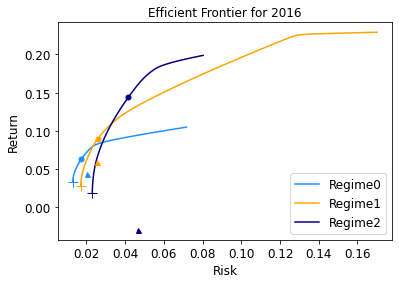

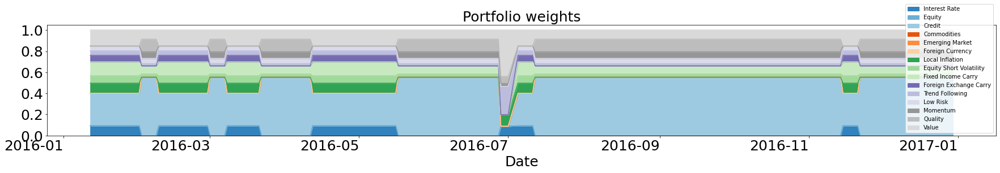

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 3


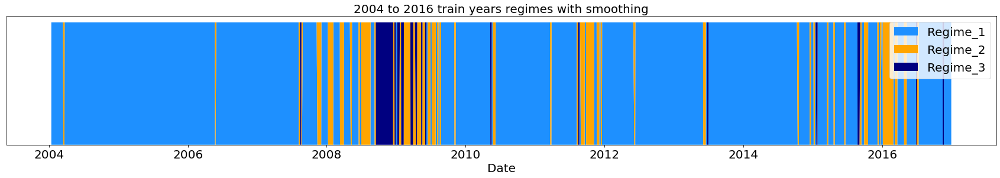

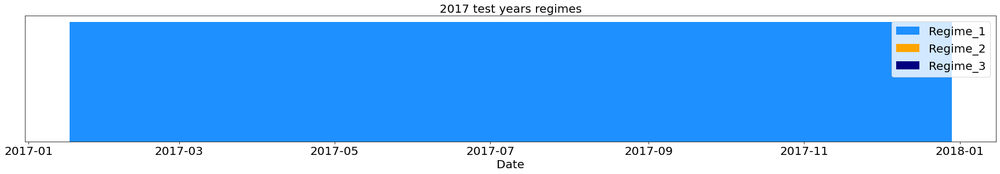

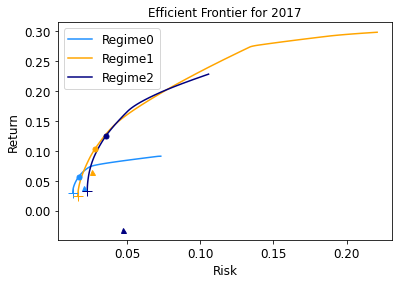

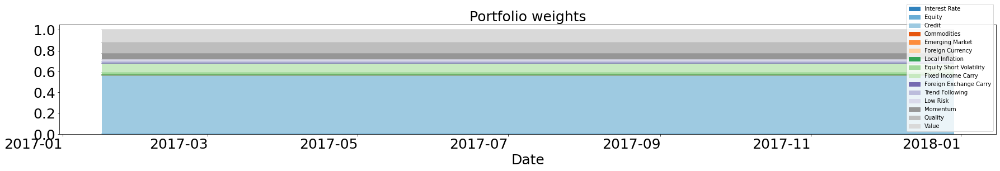

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 3


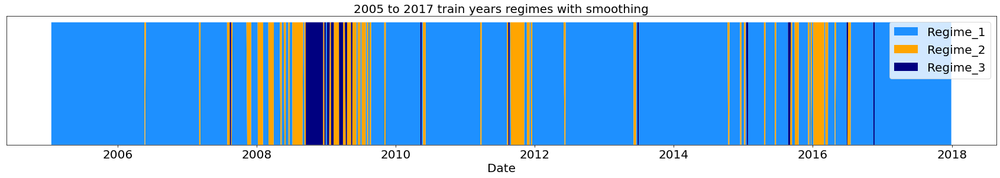

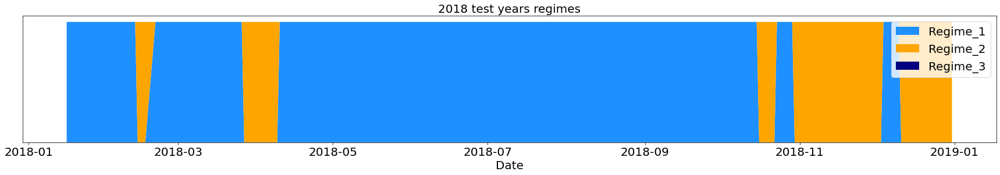

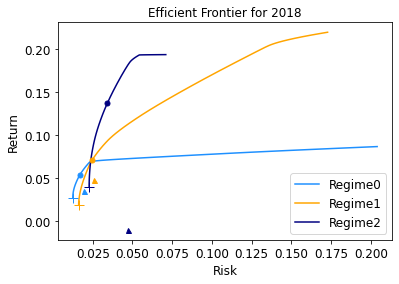

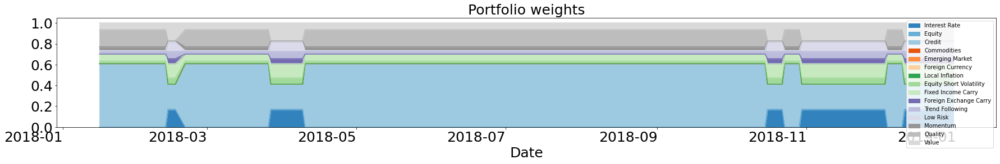

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 3


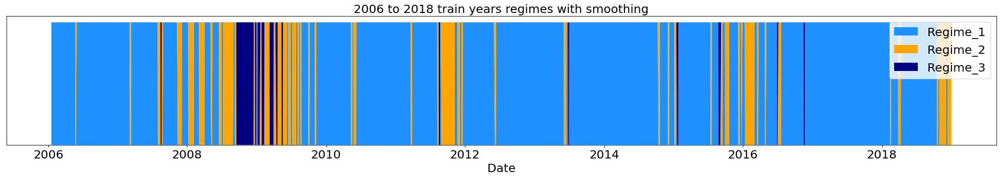

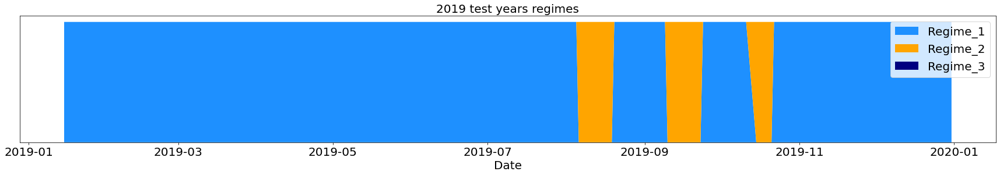

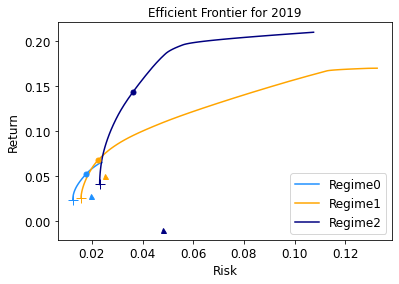

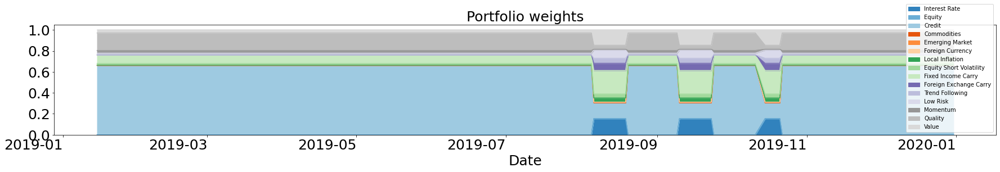

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 3


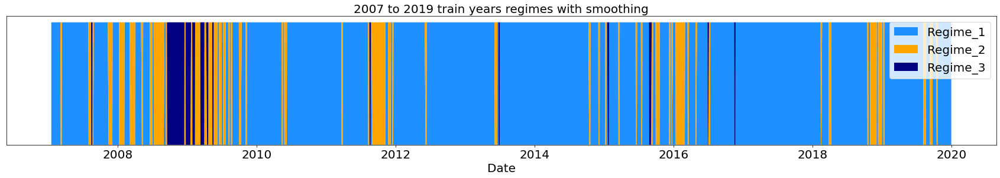

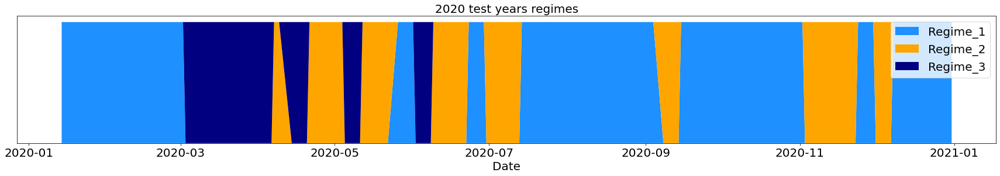

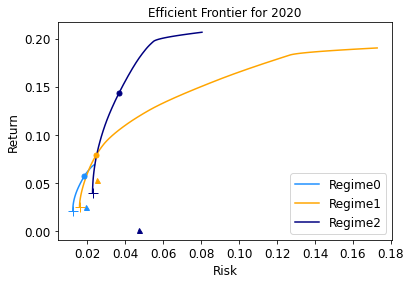

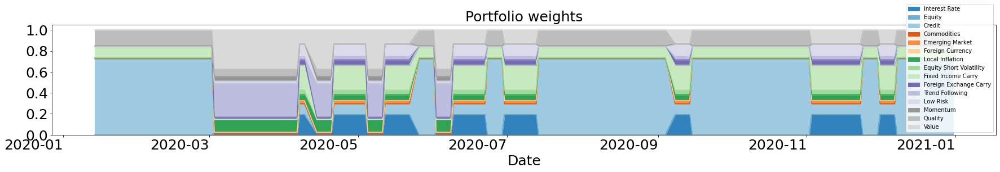

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


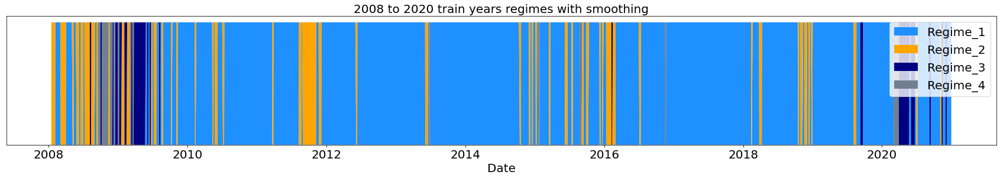

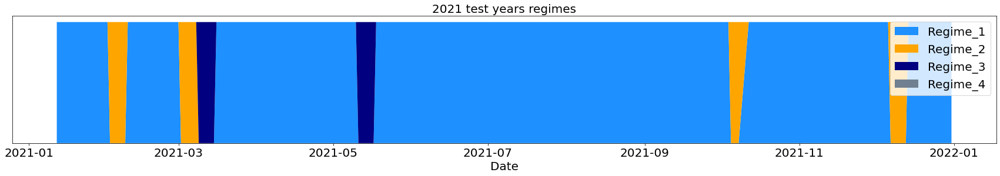

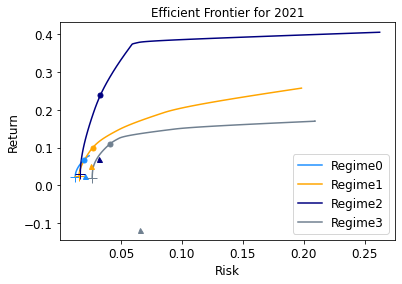

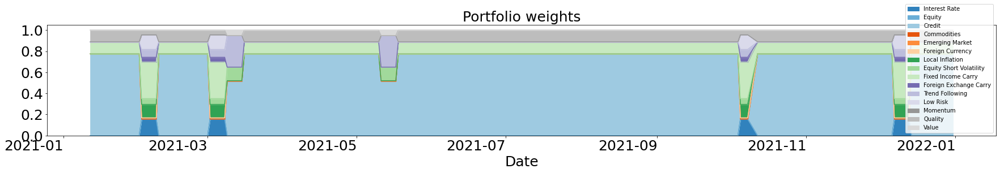

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


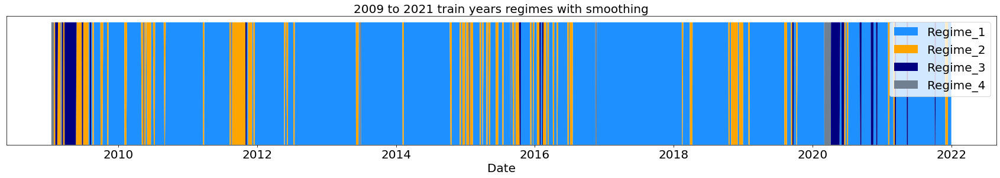

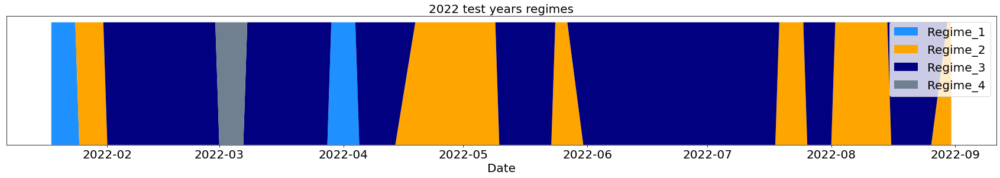

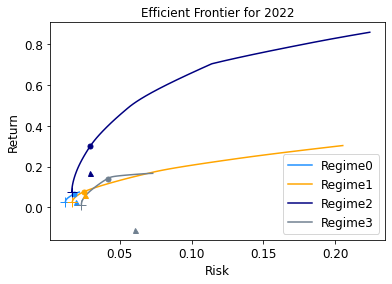

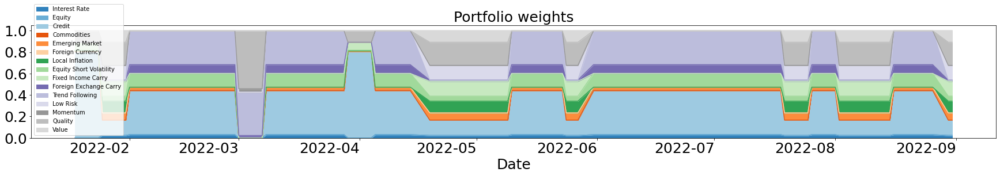

In [30]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = None, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz fix 4 regimes Performance
Portfolio Annual Return:  0.02269677133185266,  Baseline Annual Return: 0.002681984926596659
Portfolio Sharpe Ratio:  0.990292220581448,  Baseline Sharpe Ratio: 0.11748385622774155
Portfolio Max Drawdown:  0.0530000251460464,  Baseline Max Drawdown: 0.11132315461956288
Portfolio Calmar Ratio:  0.42978267771067347,  Baseline Calmar Ratio: 0.02805912749399061


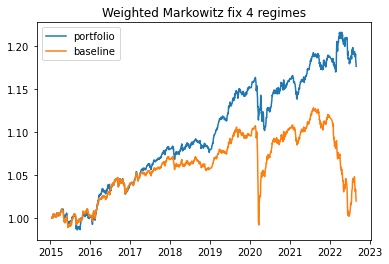

In [31]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz fix 4 regimes')

In [32]:
dynamic_markowitz = (1 + pnl_total).cumprod()

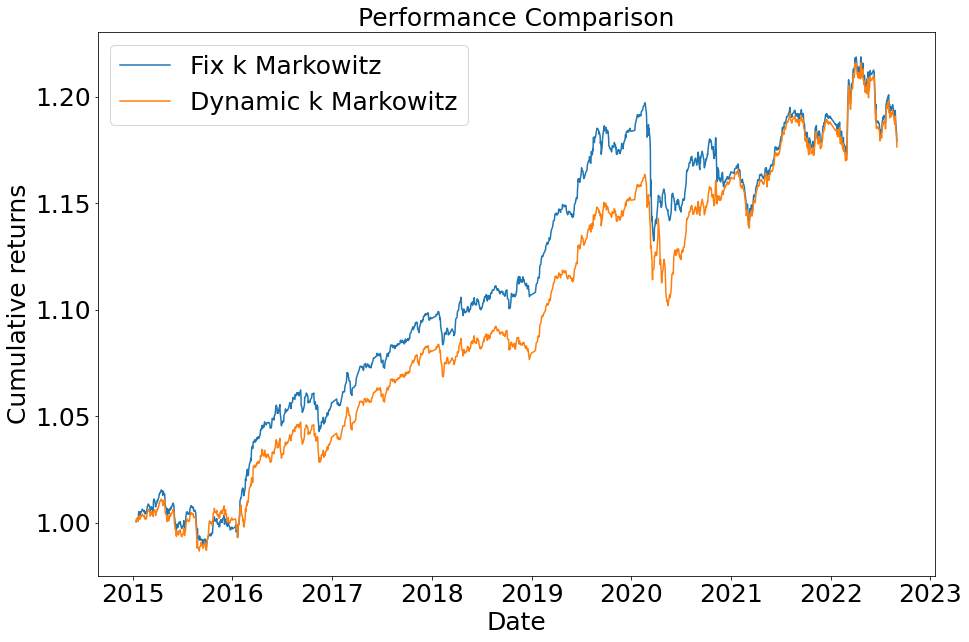

In [33]:
plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Fix k Markowitz")
plt.plot(dynamic_markowitz, label = "Dynamic k Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **MARKOWITZ VARIATIONS**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


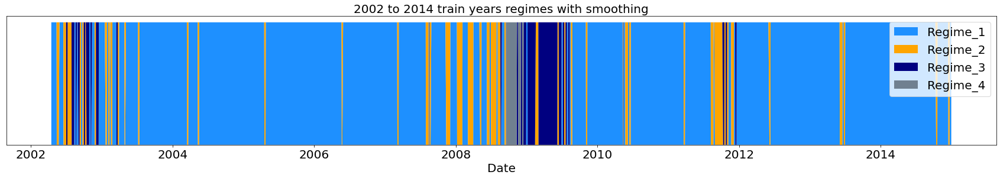

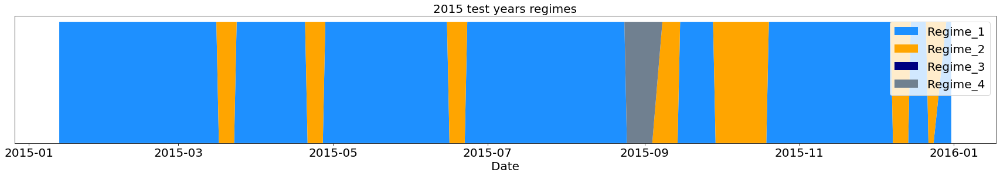

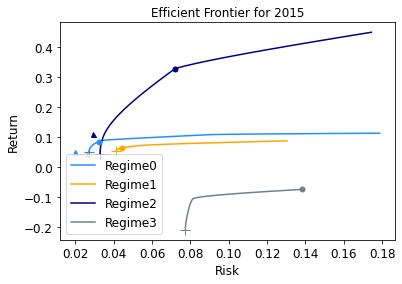

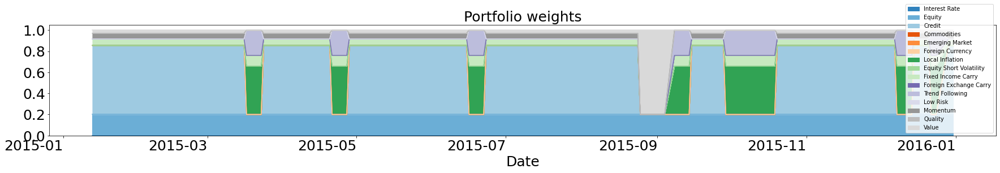

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


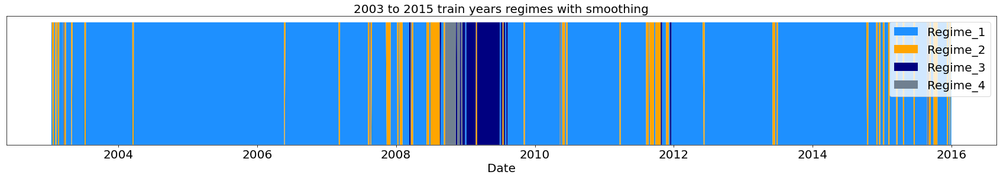

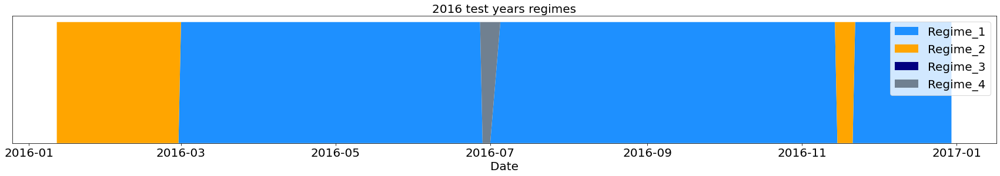

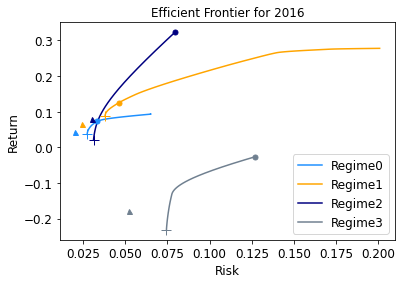

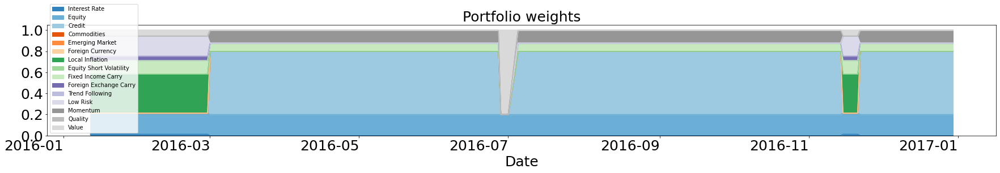

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


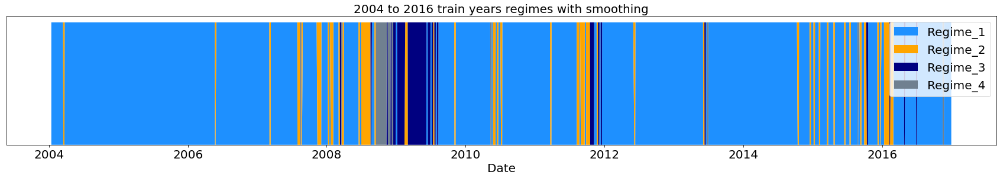

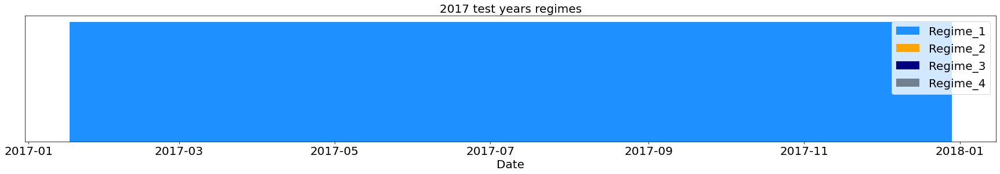

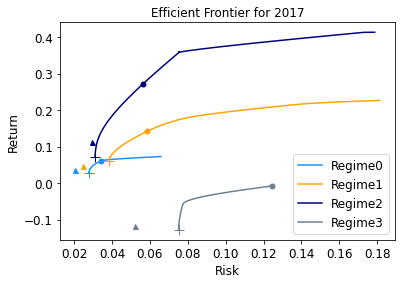

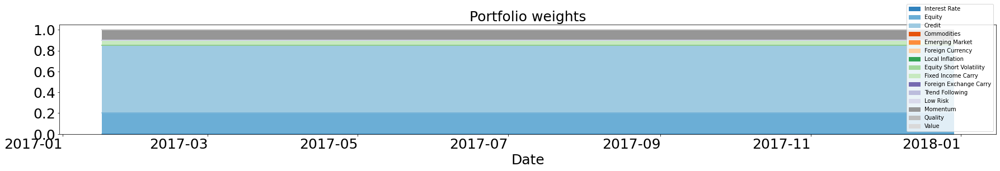

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


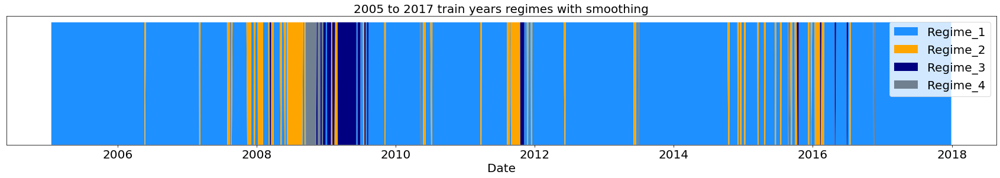

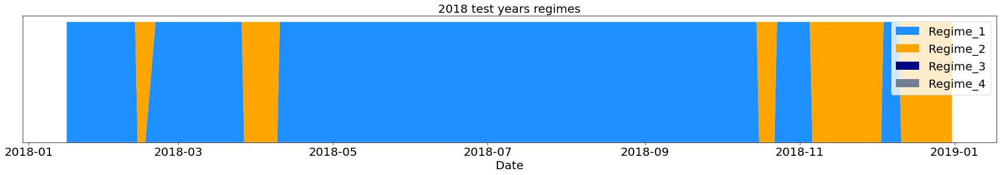

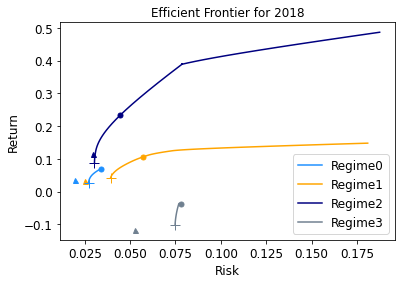

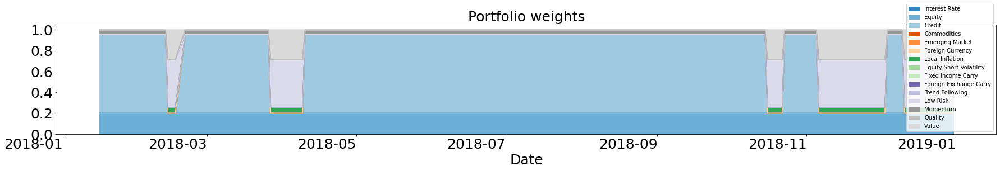

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


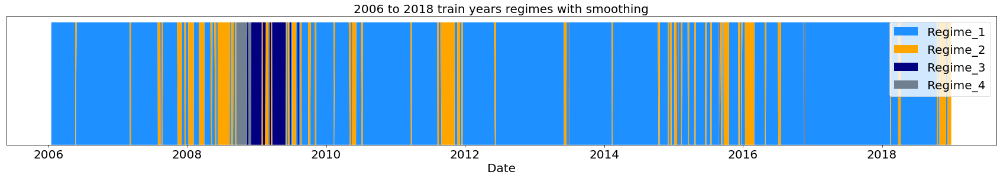

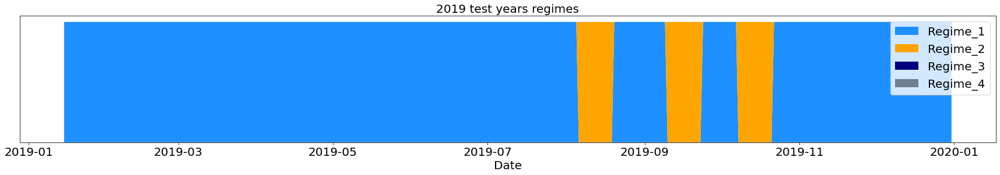

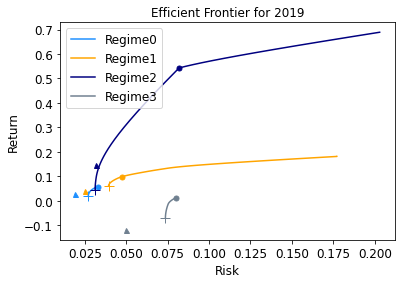

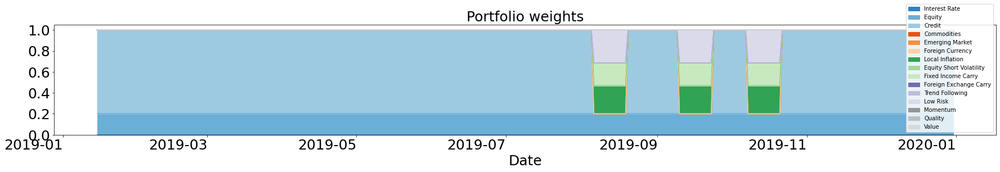

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


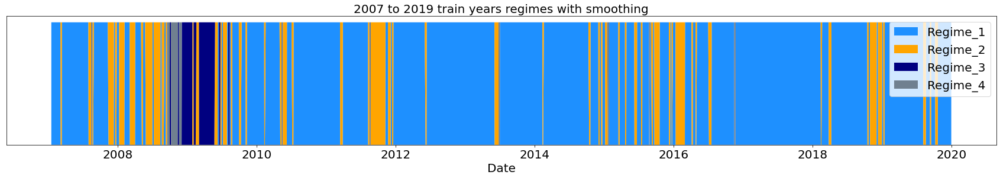

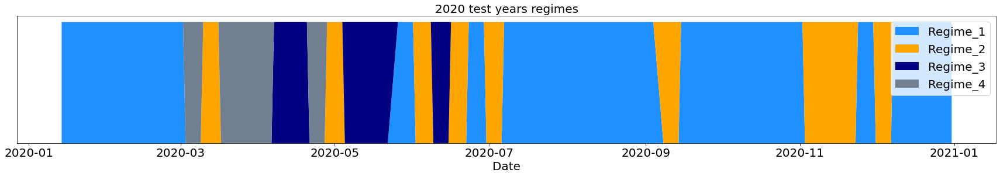

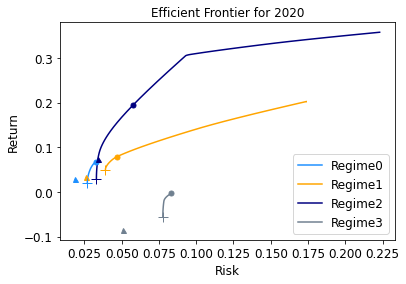

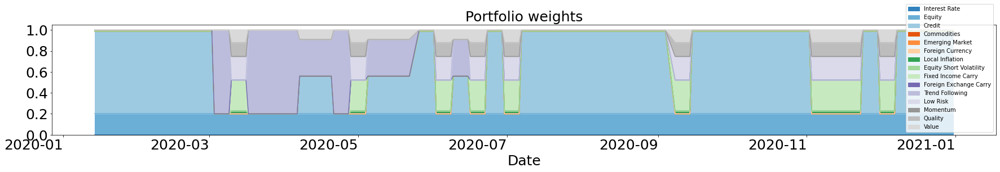

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


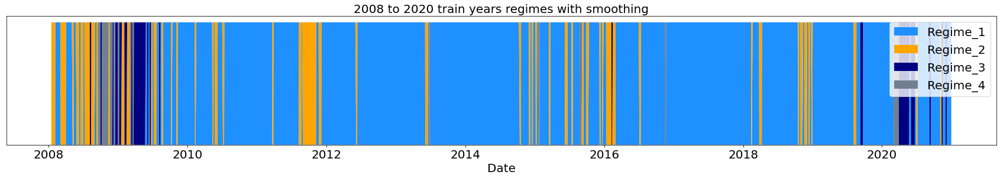

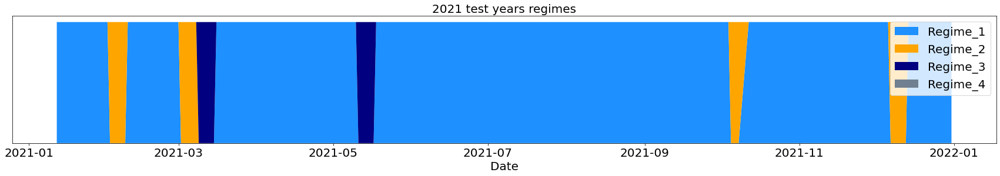

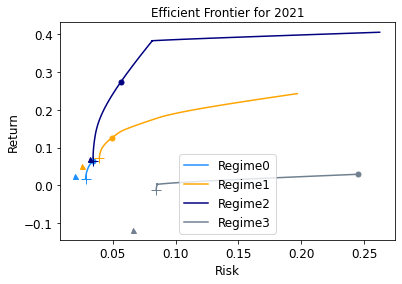

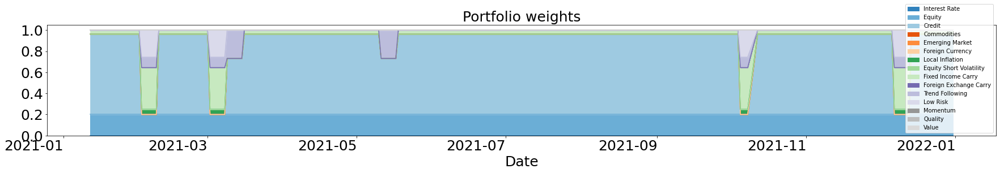

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


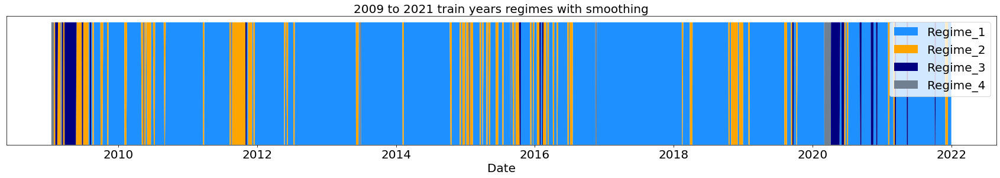

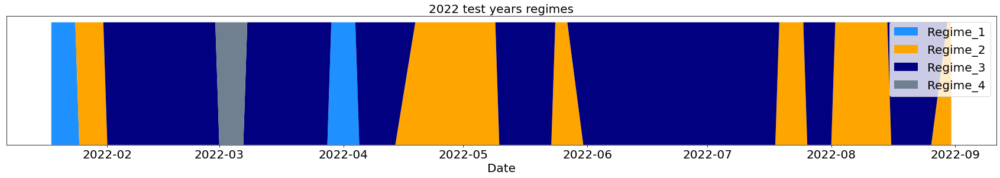

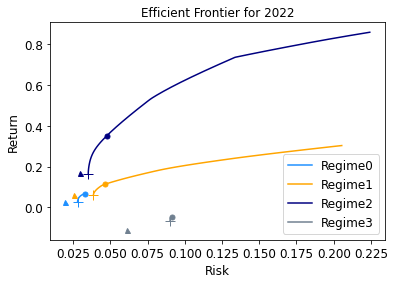

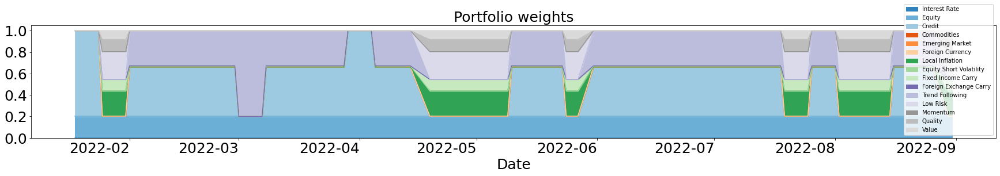

Non-weighted Markowitz min eq=0.2 Performance
Portfolio Annual Return:  0.03237105559930997,  Baseline Annual Return: 0.014939126099095423
Portfolio Sharpe Ratio:  0.7659803262812037,  Baseline Sharpe Ratio: 0.3251121392817188
Portfolio Max Drawdown:  0.10557451854576849,  Baseline Max Drawdown: 0.18878701562003408
Portfolio Calmar Ratio:  0.31157936275604053,  Baseline Calmar Ratio: 0.08566918090132102


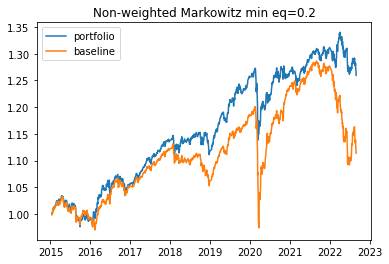

In [34]:
# min weights to equities
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4,
                        portfolio_sub_type = "equity_min",
                        min_ret = None, 
                        max_var = None,
                        min_weight = 0.2)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

pnl_analysis(pnl_total, pnl_base_total, 'Non-weighted Markowitz min eq=0.2')

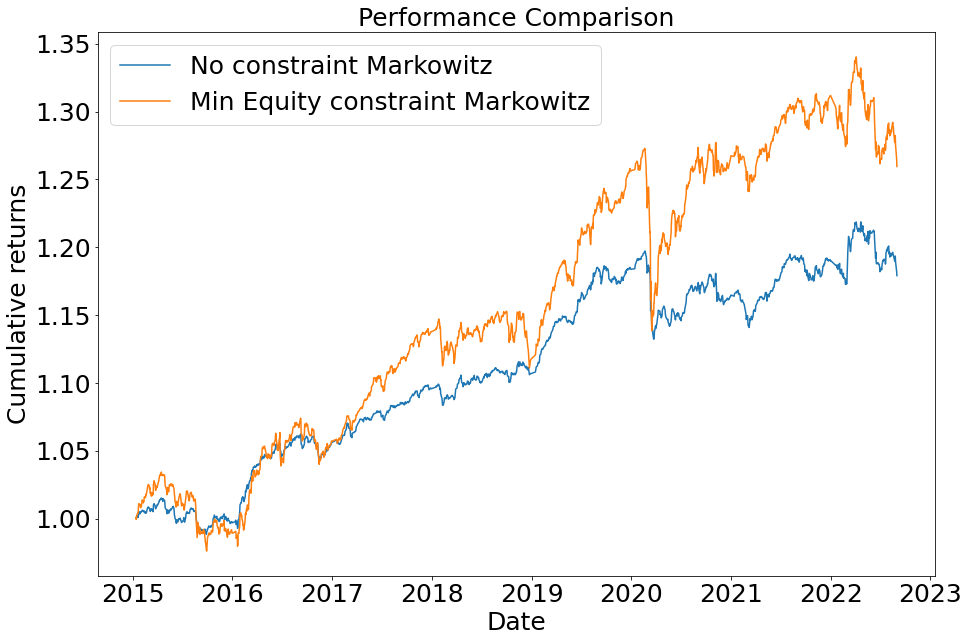

In [35]:
min_eq_markowitz = (1 + pnl_total).cumprod()

plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "No constraint Markowitz")
plt.plot(min_eq_markowitz, label = "Min Equity constraint Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


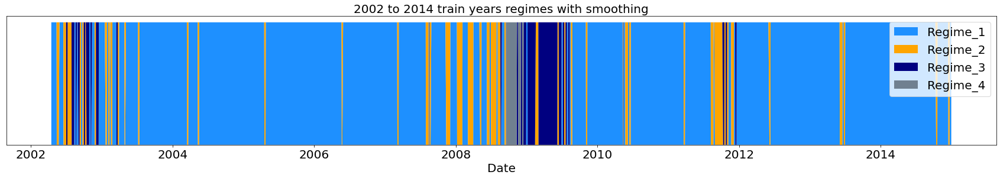

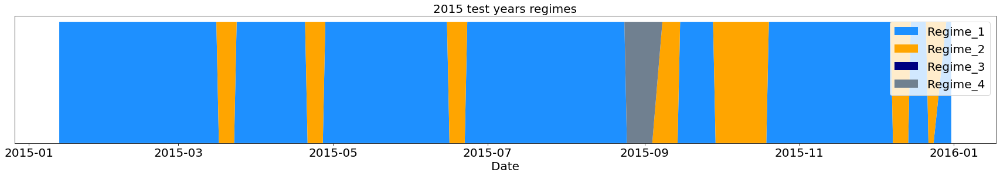

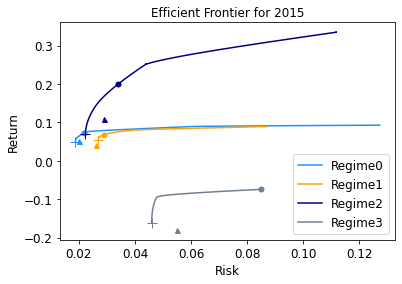

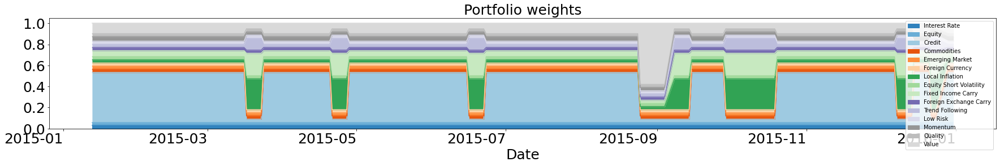

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


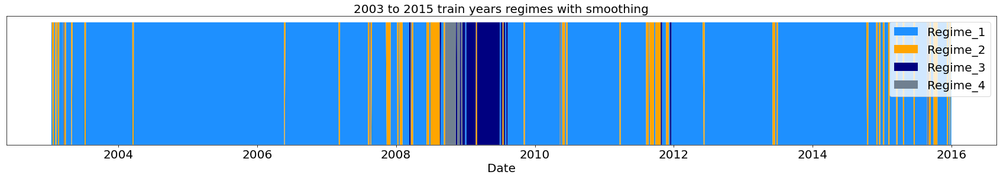

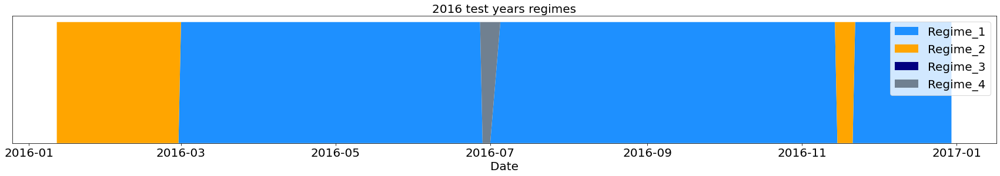

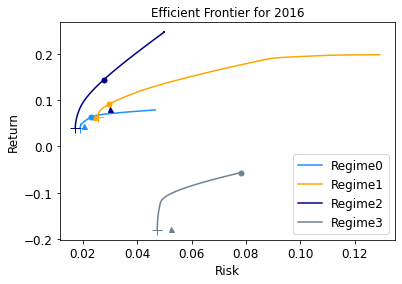

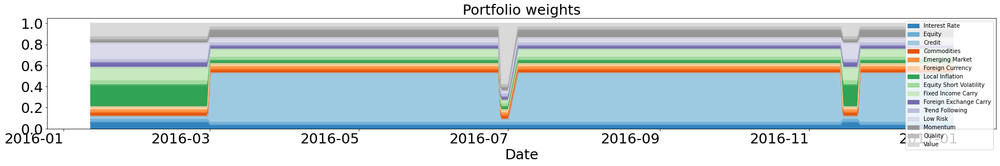

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


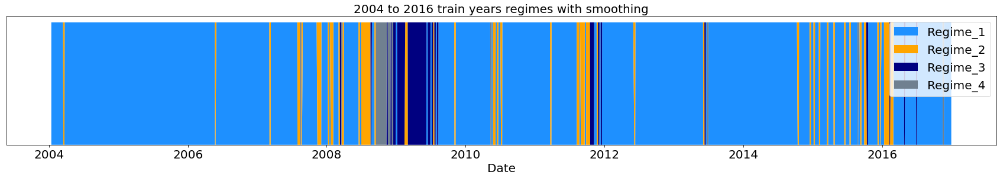

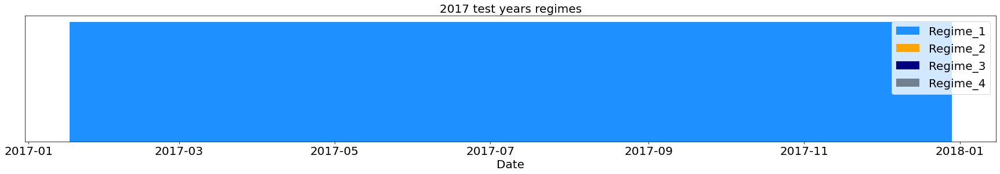

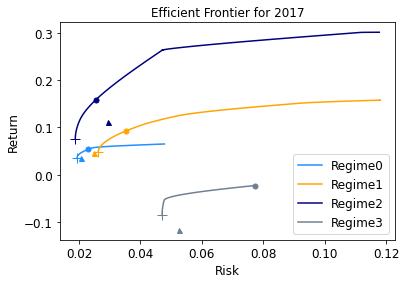

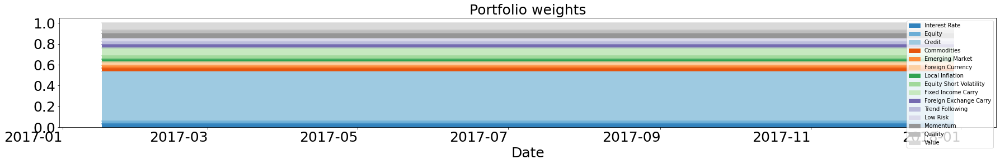

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


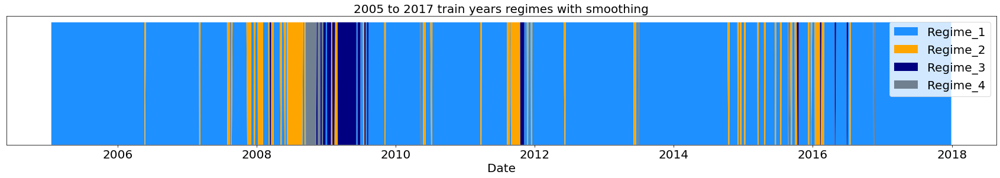

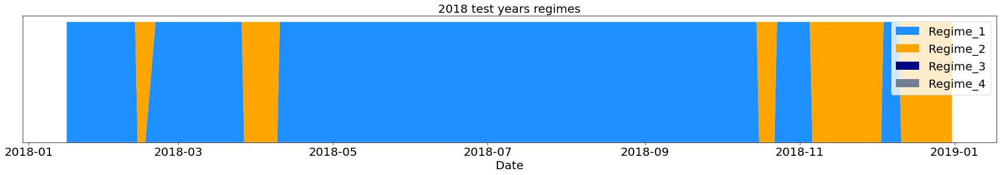

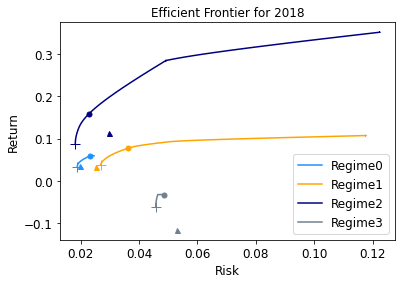

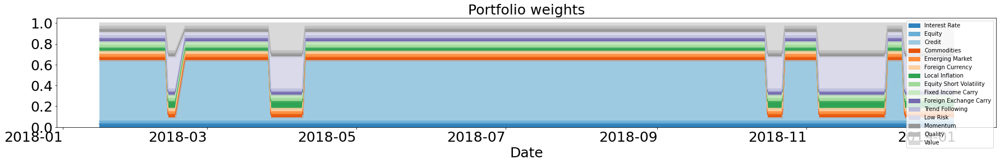

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


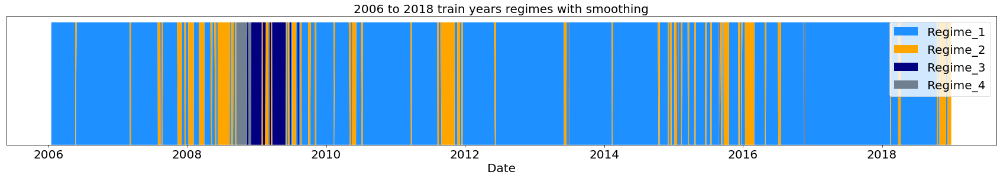

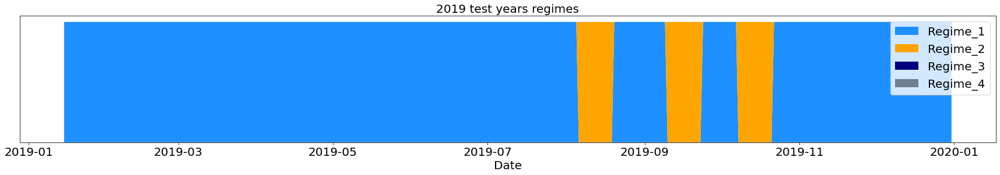

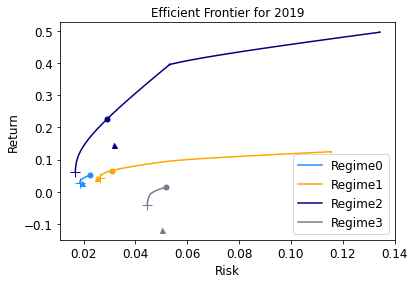

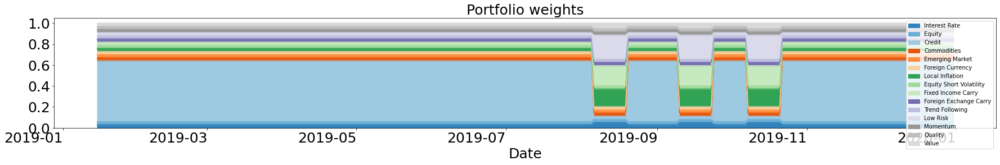

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


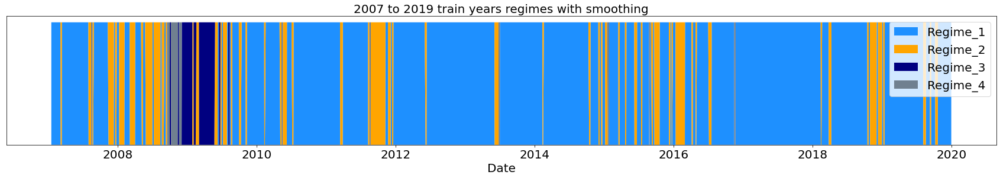

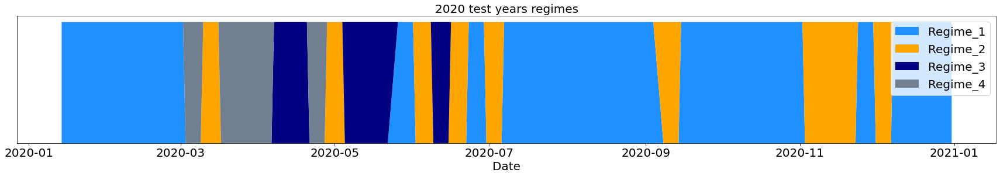

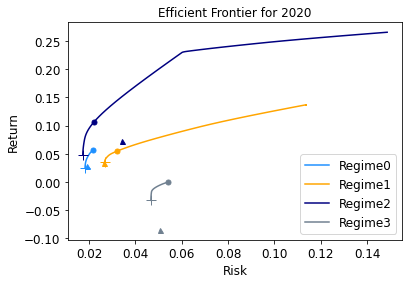

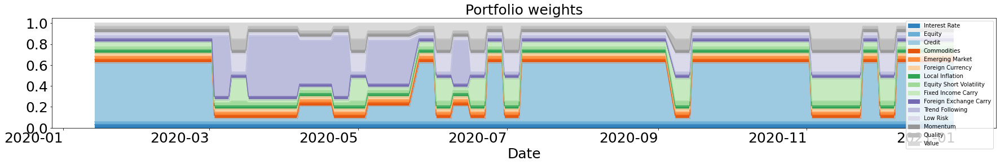

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


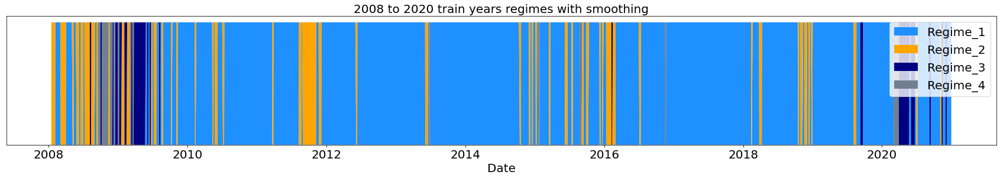

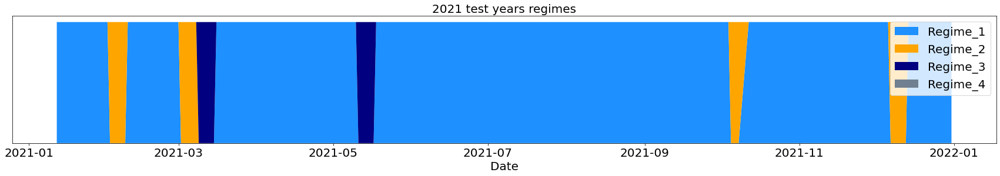

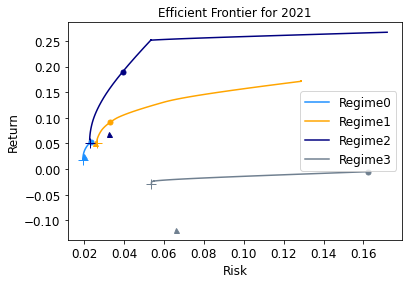

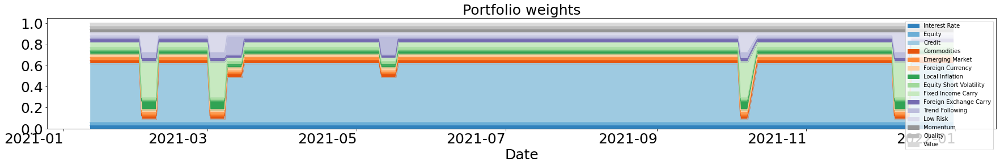

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


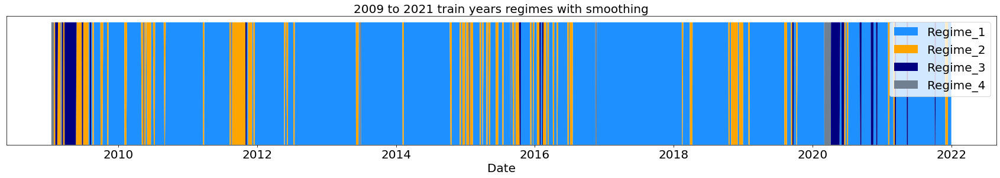

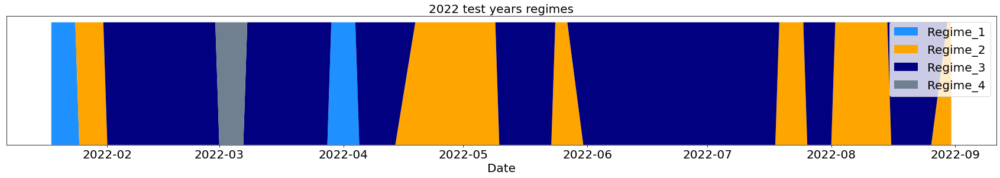

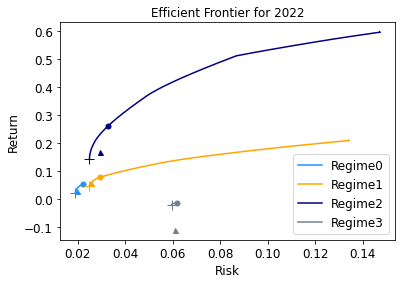

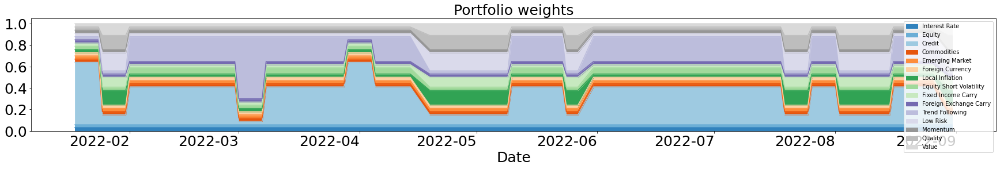

Non-weighted Markowitz min all=0.03 Performance
Portfolio Annual Return:  0.02416986022359824,  Baseline Annual Return: 0.01134587860344527
Portfolio Sharpe Ratio:  0.8039240991268912,  Baseline Sharpe Ratio: 0.35985031694142117
Portfolio Max Drawdown:  0.07992010820753326,  Baseline Max Drawdown: 0.13622998753928317
Portfolio Calmar Ratio:  0.30461758696065555,  Baseline Calmar Ratio: 0.08682525478184999


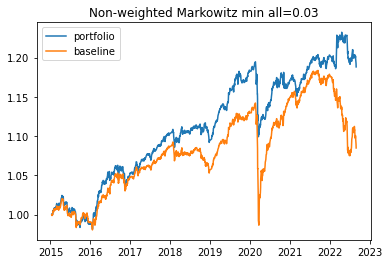

In [36]:
# min weights to all
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = "all_min",
                        min_ret = None, 
                        max_var = None, 
                        min_weight = 0.03)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

pnl_analysis(pnl_total, pnl_base_total, 'Non-weighted Markowitz min all=0.03')

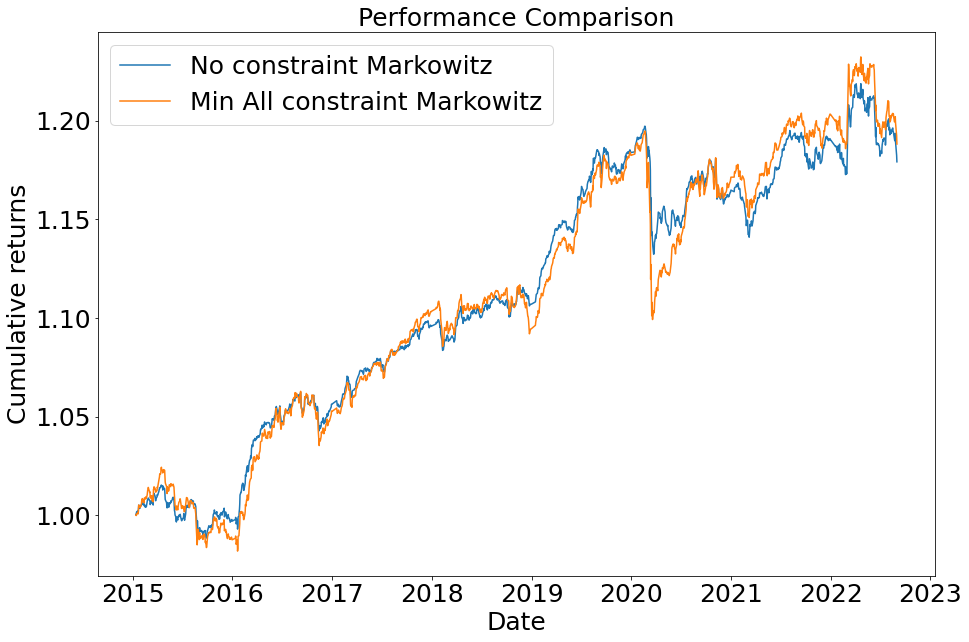

In [37]:
min_all_markowitz = (1 + pnl_total).cumprod()

plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "No constraint Markowitz")
plt.plot(min_all_markowitz, label = "Min All constraint Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

In [38]:
# maximize returns wrt max risk allowed

In [39]:
# minimize risk wrt min returns constraint

In [40]:
# index tracking

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


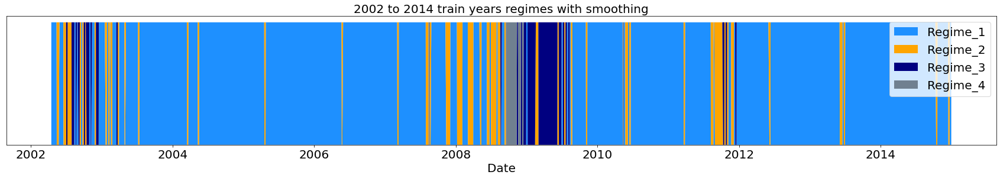

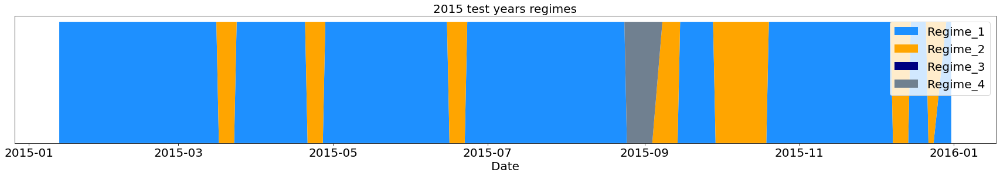

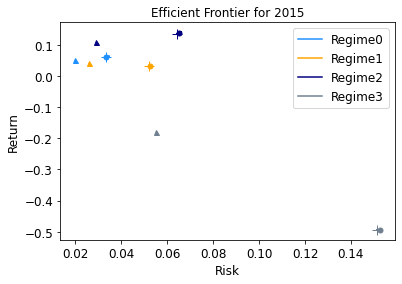

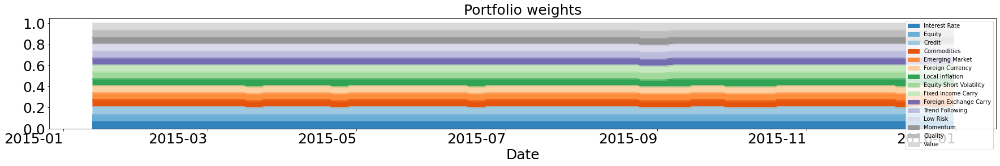

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


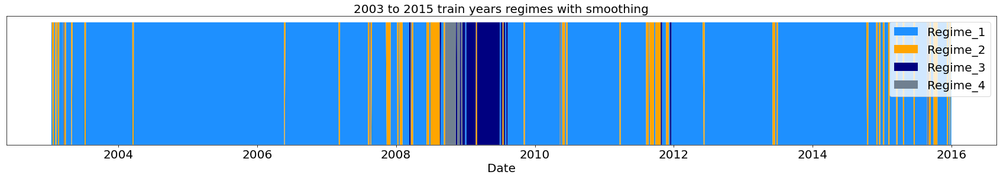

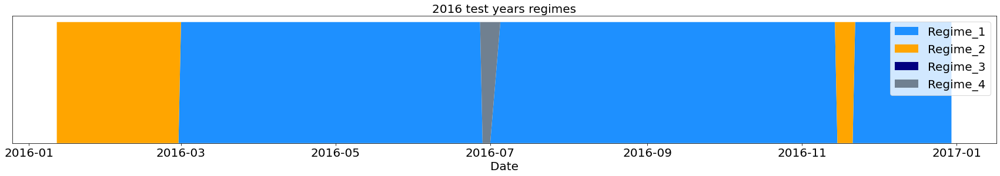

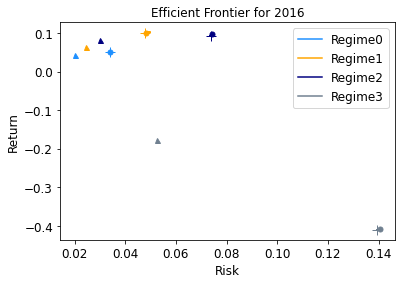

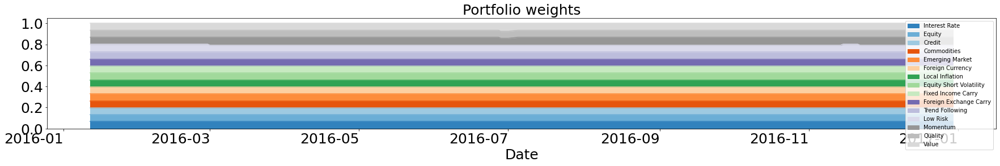

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


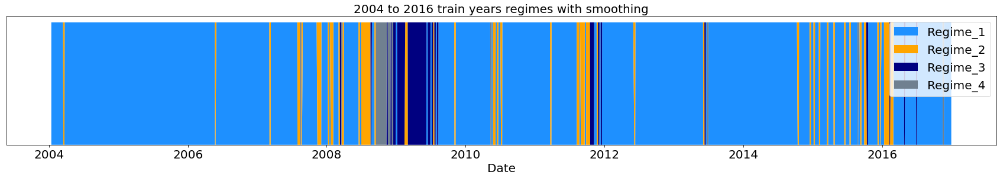

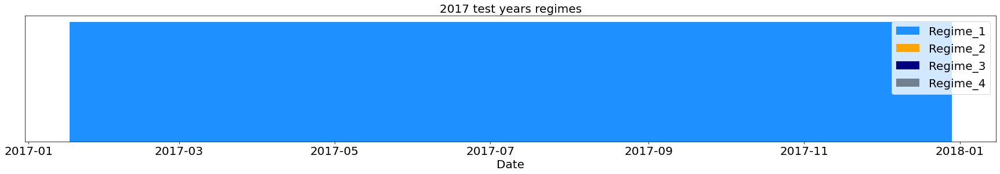

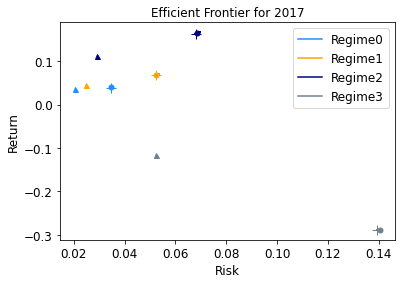

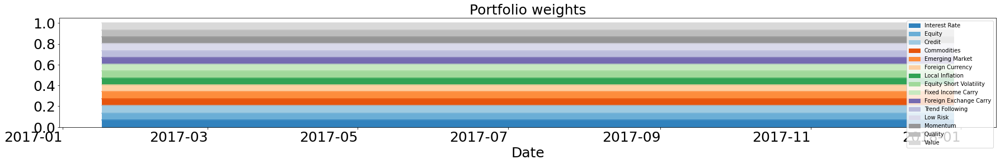

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


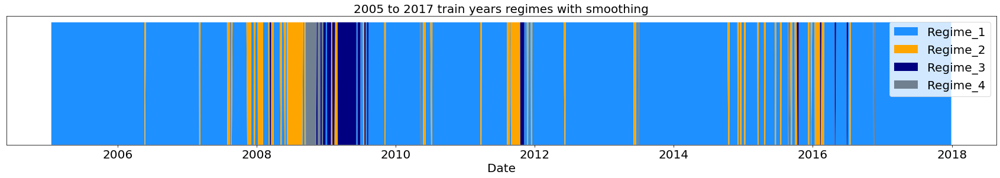

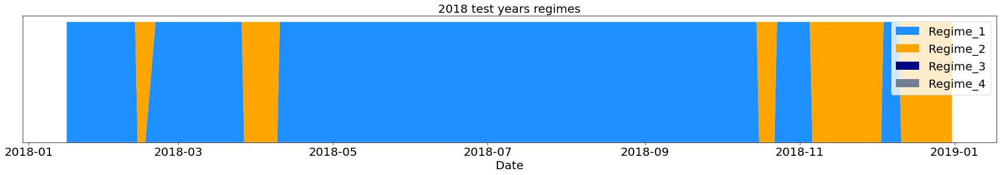

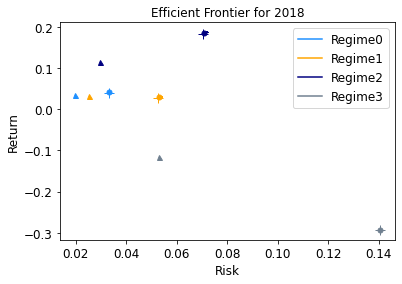

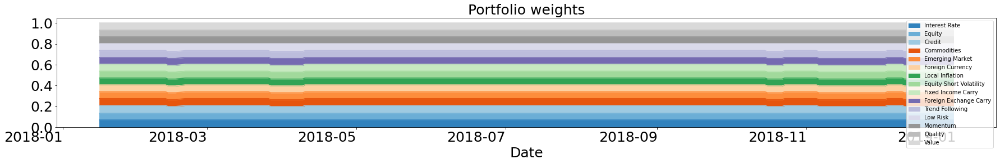

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


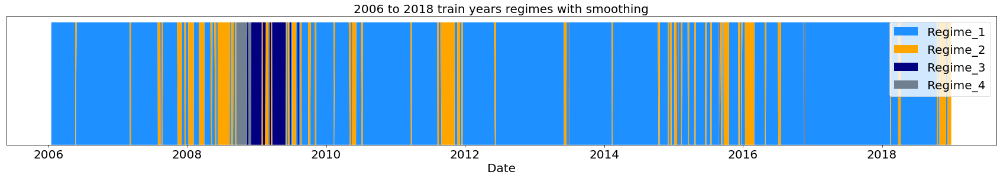

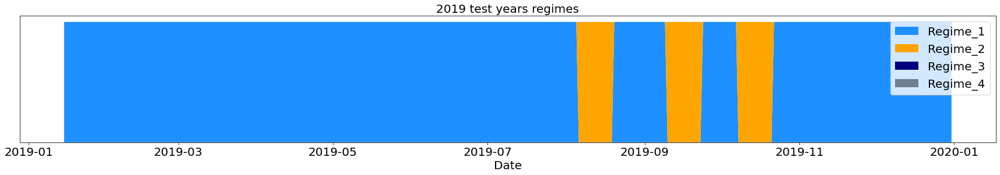

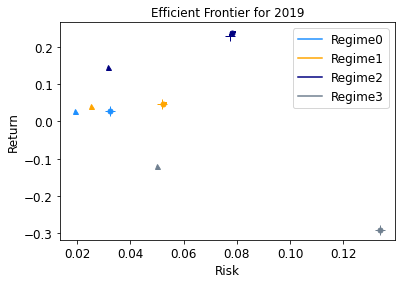

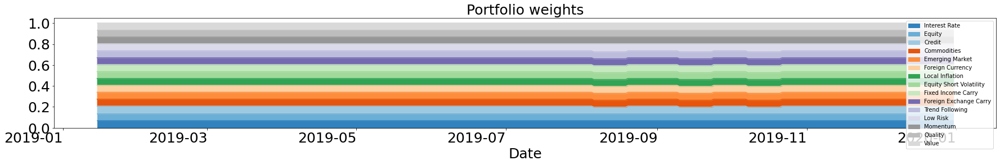

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


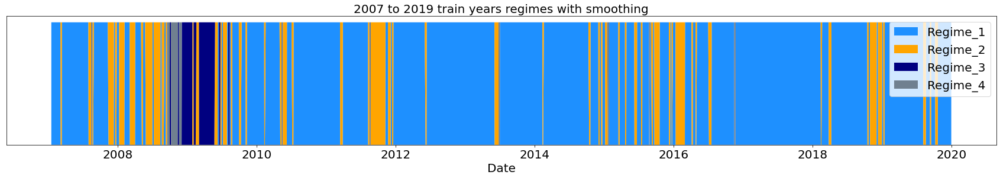

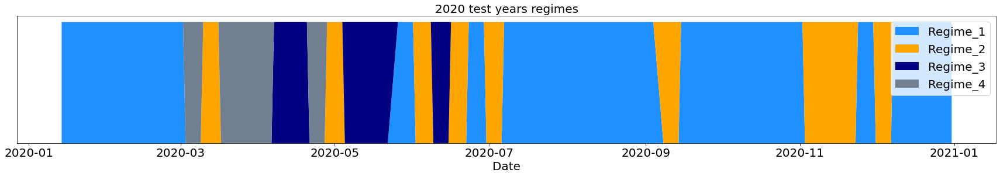

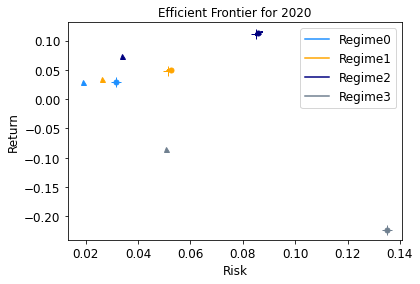

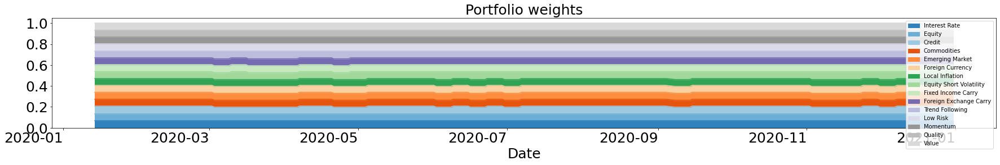

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


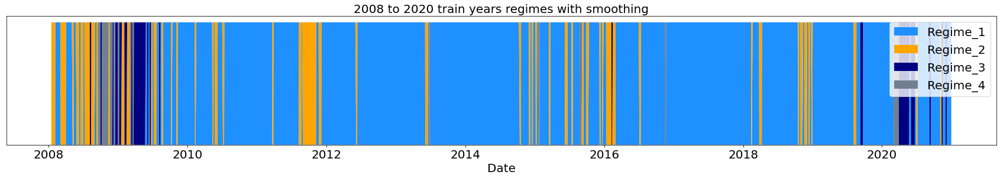

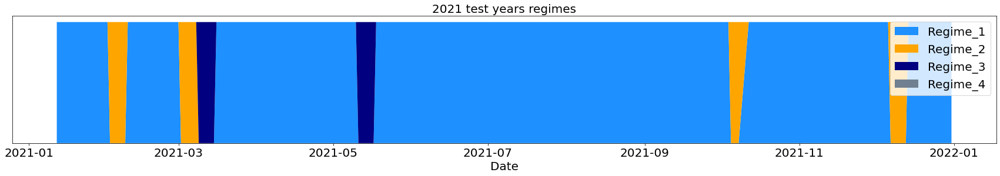

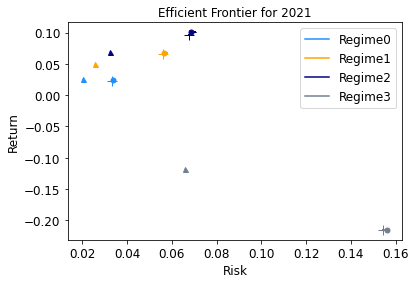

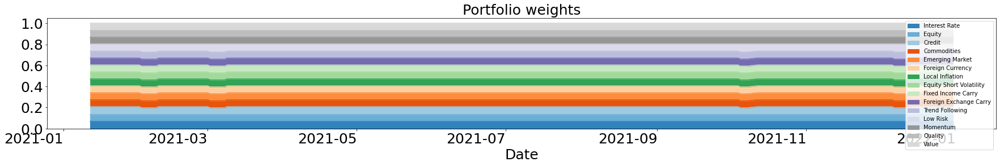

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


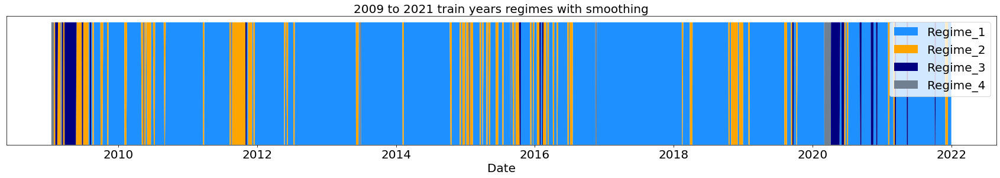

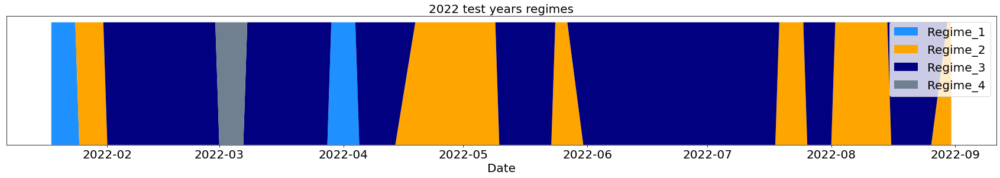

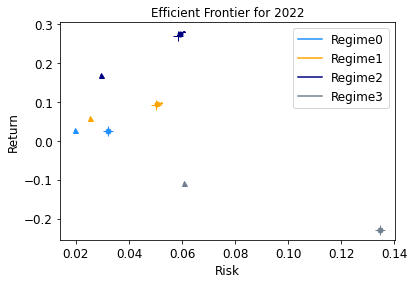

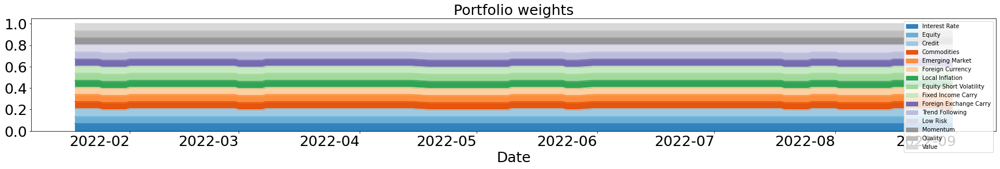

Non-weighted Markowitz Performance
Portfolio Annual Return:  0.019458546110143304,  Baseline Annual Return: 0.019538402288661105
Portfolio Sharpe Ratio:  0.4619961502538384,  Baseline Sharpe Ratio: 0.4656963785725976
Portfolio Max Drawdown:  0.1394221718416545,  Baseline Max Drawdown: 0.13981119767086392
Portfolio Calmar Ratio:  0.1446600043784787,  Baseline Calmar Ratio: 0.14475493680068732


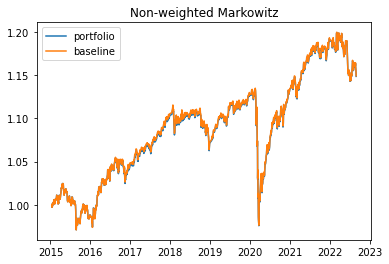

In [41]:
# same weights
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = final_df, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = "all_min",
                        min_ret = None,
                        max_var = None,
                        min_weight=0.066)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

pnl_analysis(pnl_total, pnl_base_total, 'Non-weighted Markowitz')

In [42]:
equal_weight = (1 + pnl_total).cumprod()

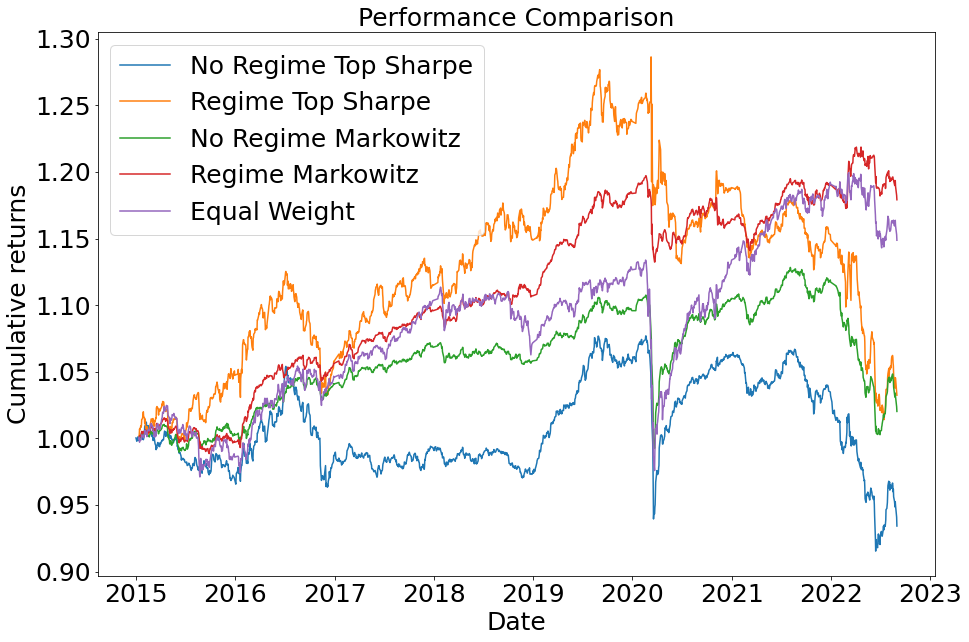

In [43]:
plt.figure(figsize = (15, 10))
plt.plot(no_regime_top_sharpe, label = "No Regime Top Sharpe")
plt.plot(regime_top_sharpe, label = "Regime Top Sharpe")
plt.plot(no_regime_markowitz, label = "No Regime Markowitz")
plt.plot(regime_markowitz, label = "Regime Markowitz")
plt.plot(equal_weight, label = "Equal Weight")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **WITHOUT CREDIT**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


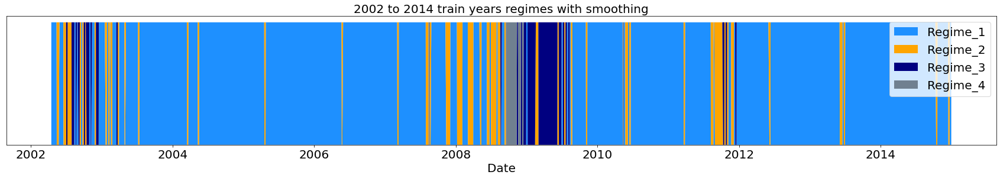

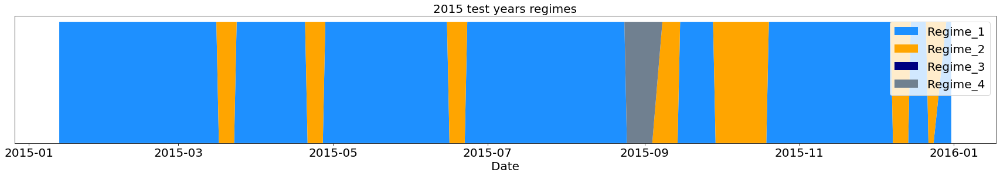

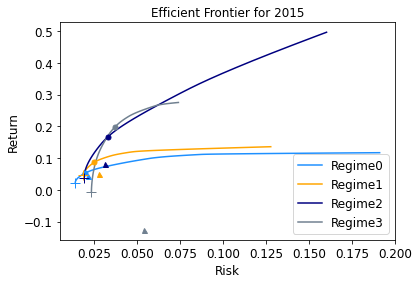

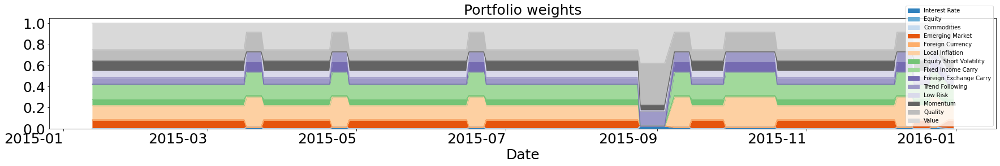

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


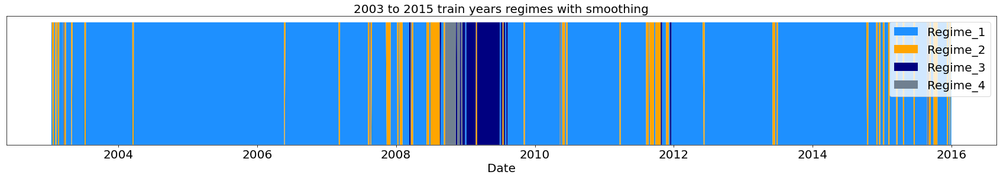

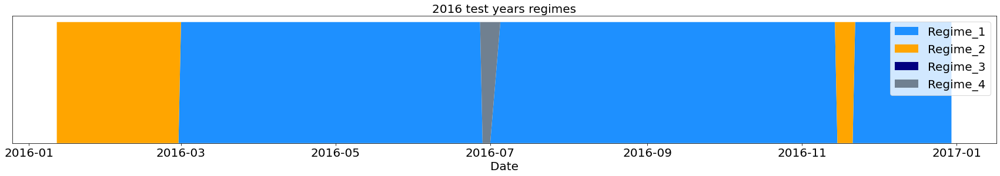

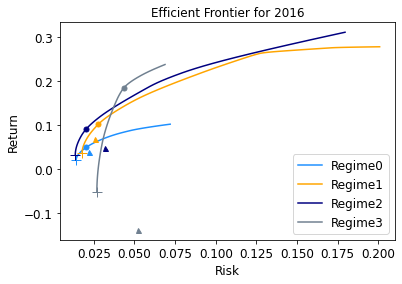

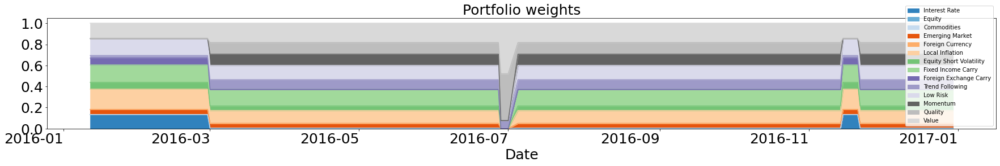

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


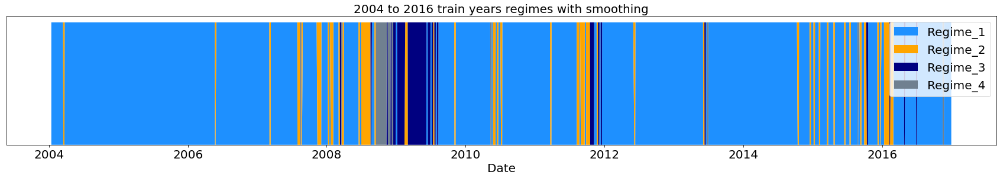

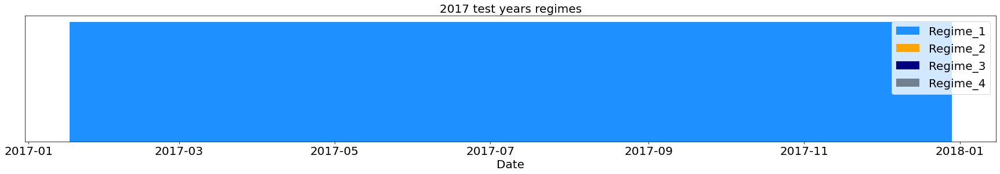

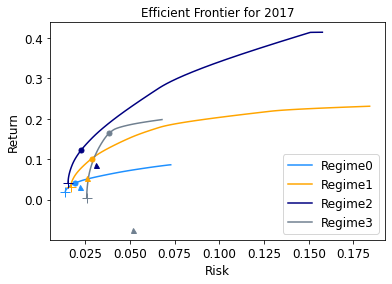

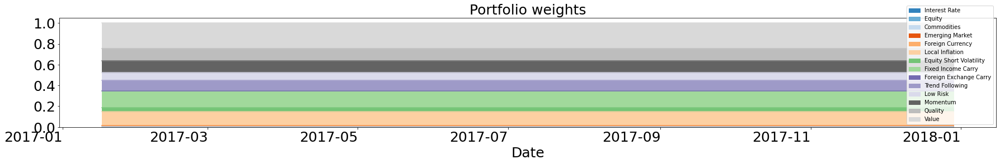

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


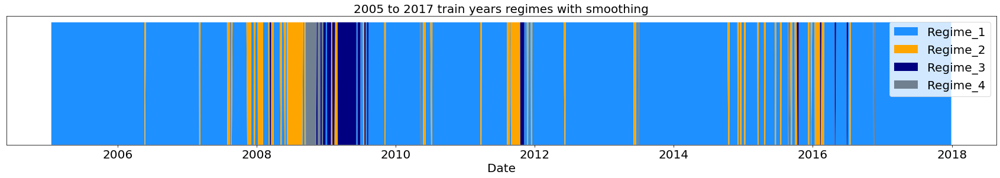

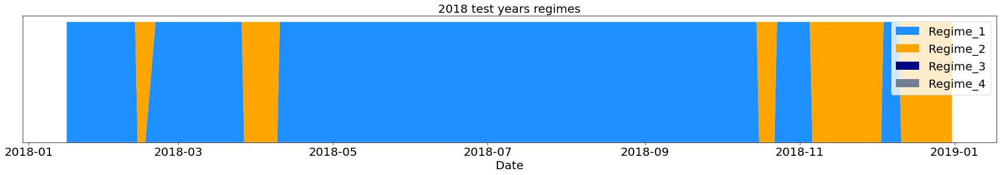

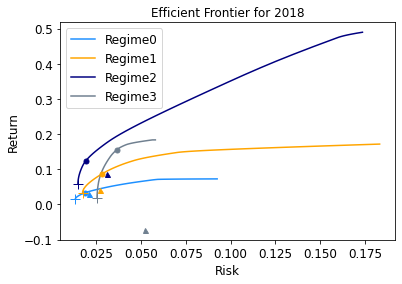

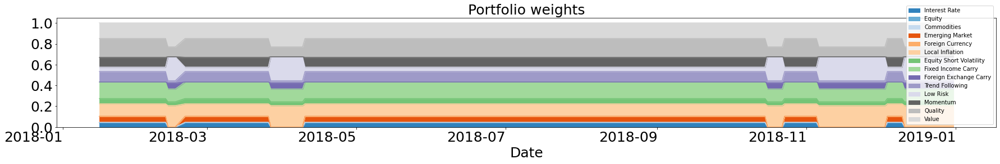

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


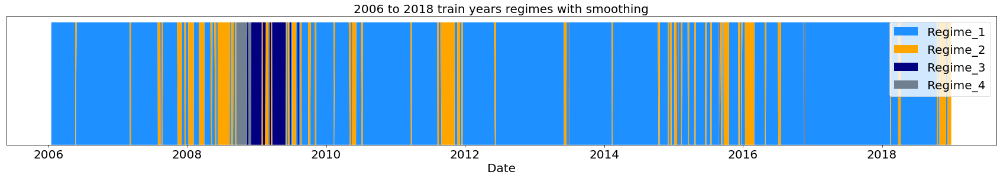

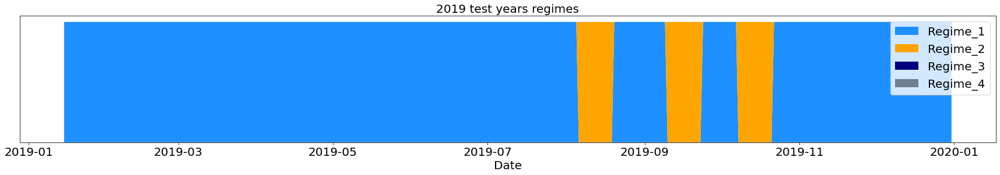

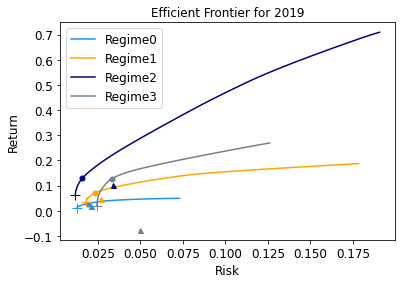

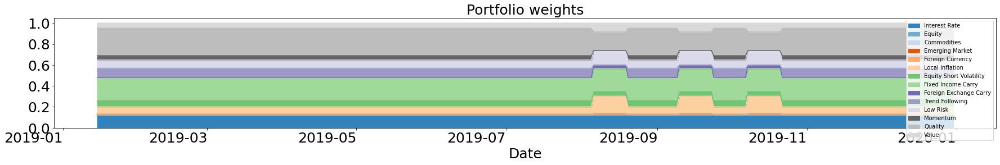

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


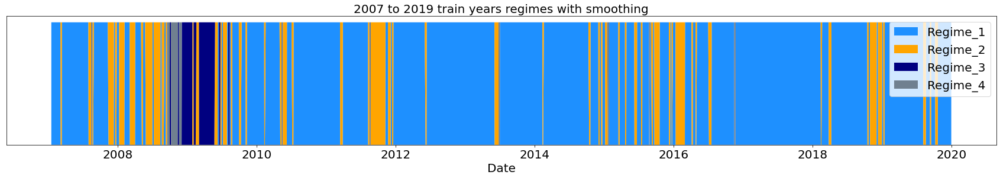

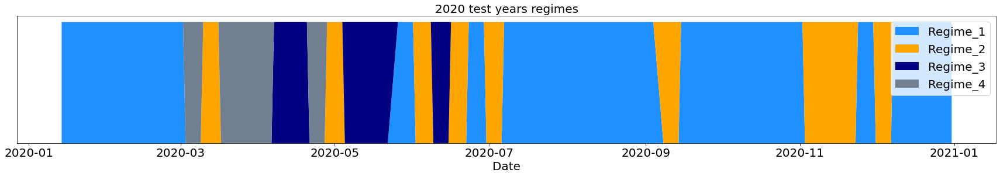

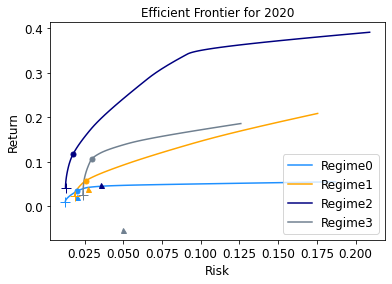

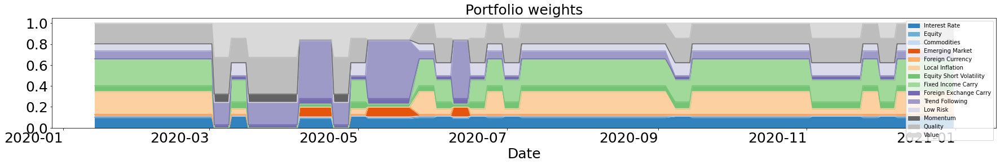

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


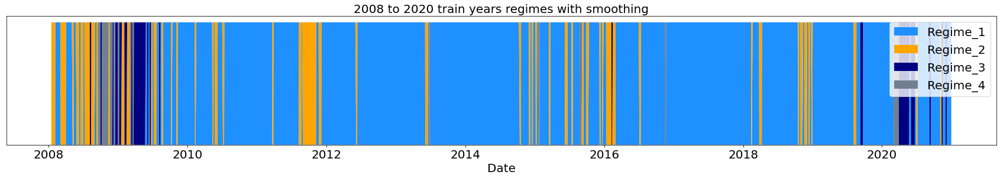

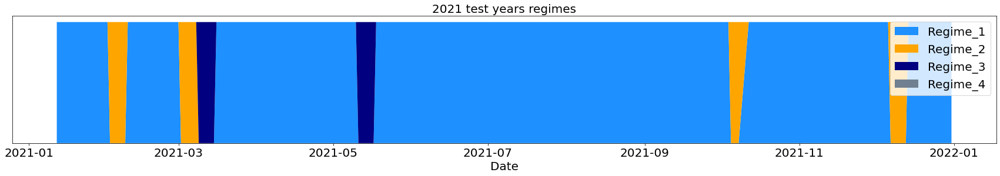

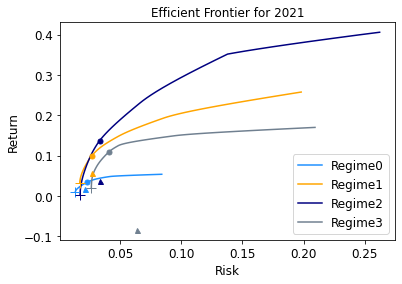

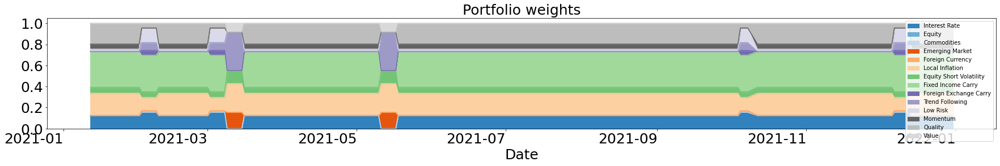

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


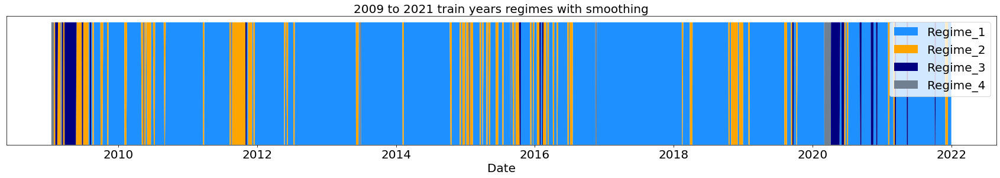

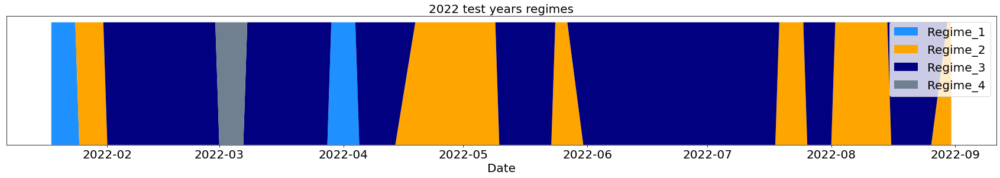

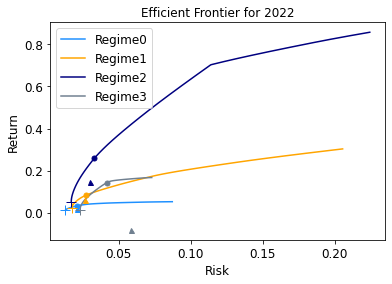

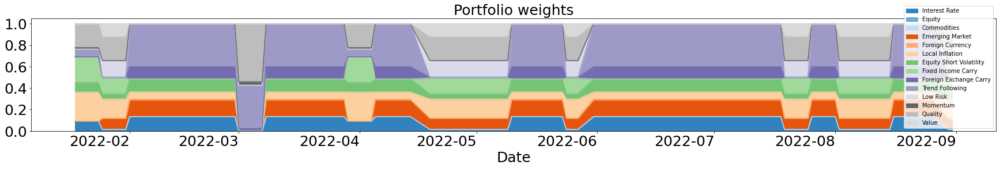

In [44]:
no_credit = final_df.drop(["Credit"], axis = 1)

train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = no_credit, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz no credit Performance
Portfolio Annual Return:  0.004597850268392323,  Baseline Annual Return: -0.004508597748170473
Portfolio Sharpe Ratio:  0.18025270922658443,  Baseline Sharpe Ratio: -0.1474522334240597
Portfolio Max Drawdown:  0.08118331427307923,  Baseline Max Drawdown: 0.09908483807165536
Portfolio Calmar Ratio:  0.06224721105547785,  Baseline Calmar Ratio: -0.040948045261646734


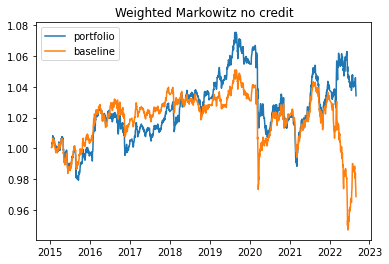

In [45]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz no credit')

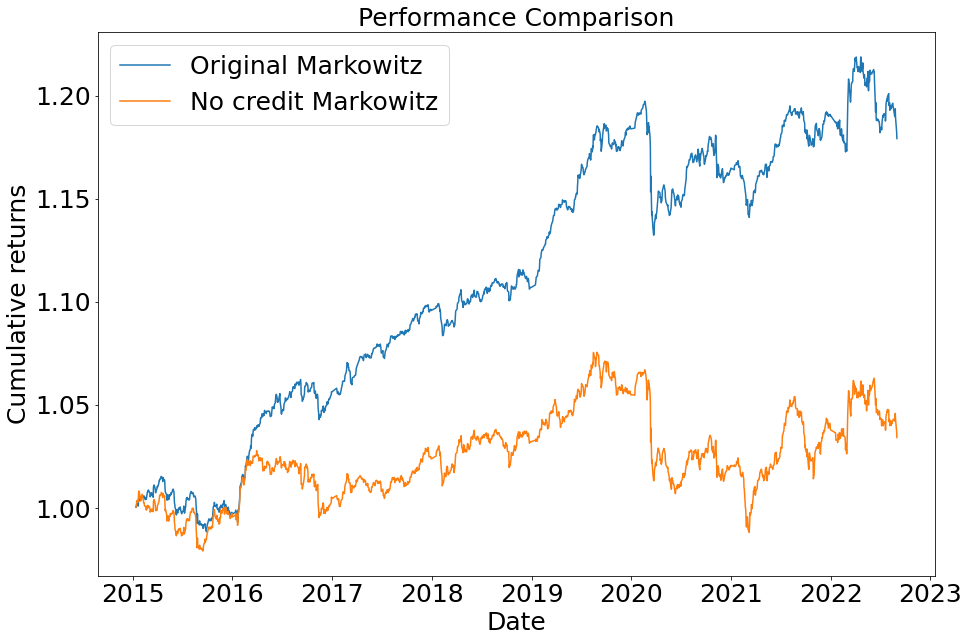

In [46]:
no_credit_markowitz = (1 + pnl_total).cumprod()

plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Original Markowitz")
plt.plot(no_credit_markowitz, label = "No credit Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

### **WITHOUT CREDIT AND EQUITY STYLES**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


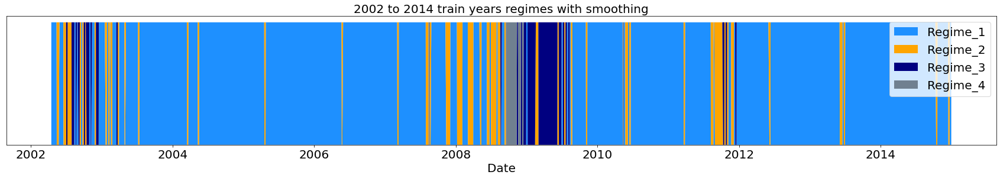

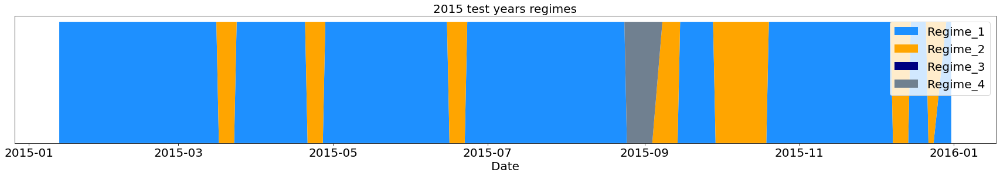

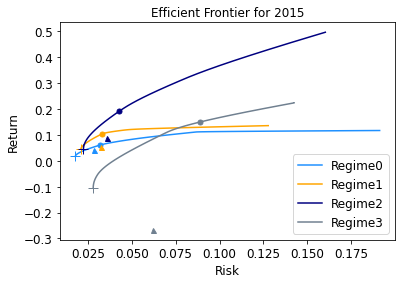

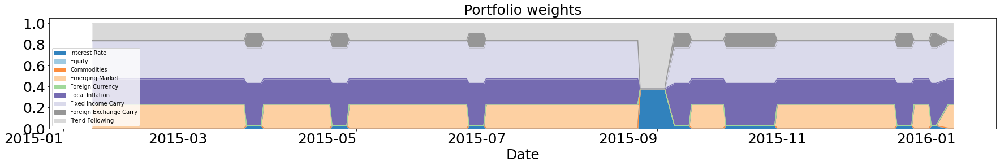

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


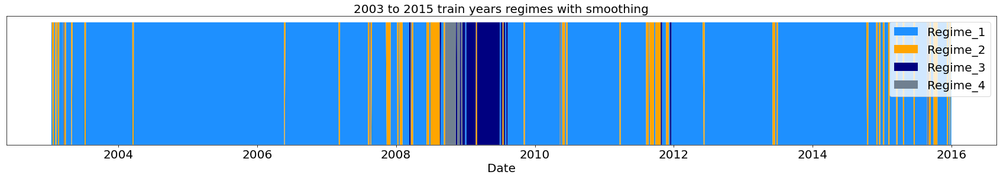

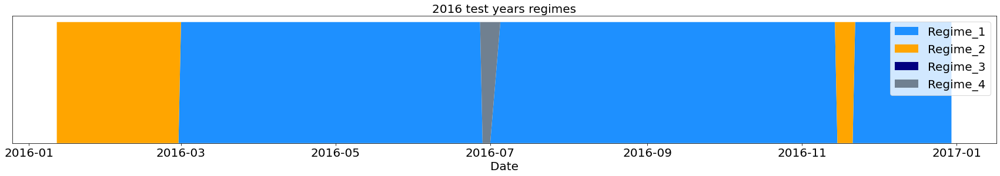

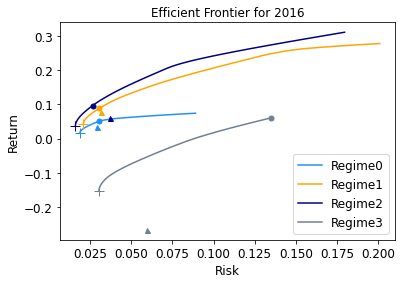

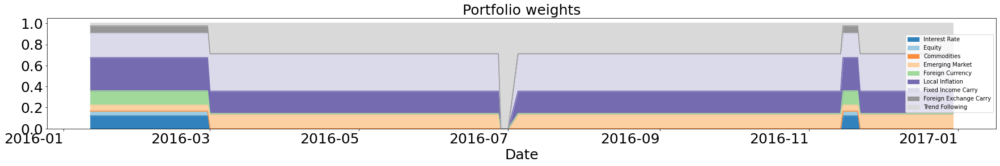

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


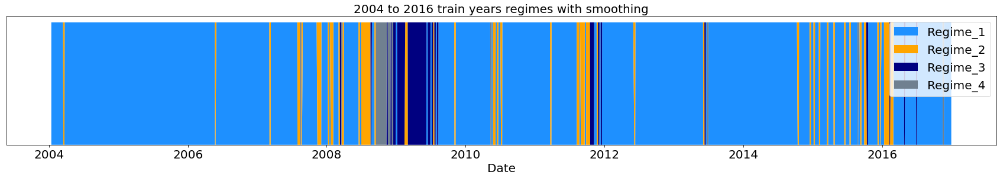

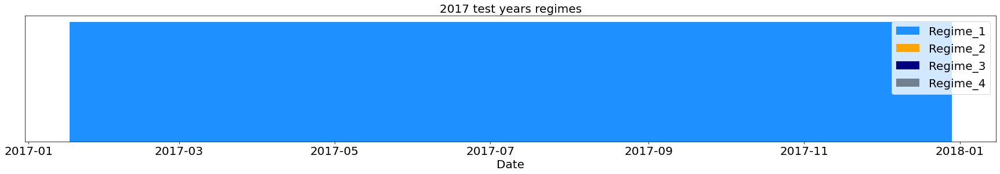

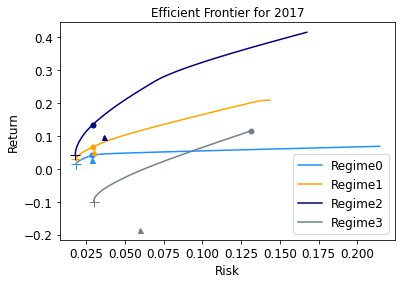

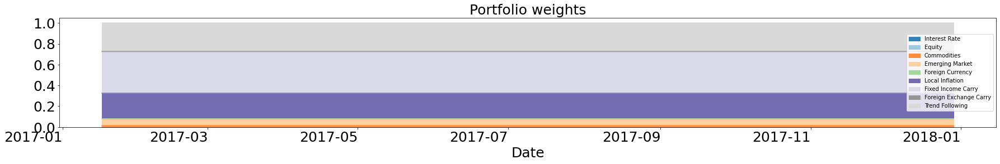

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


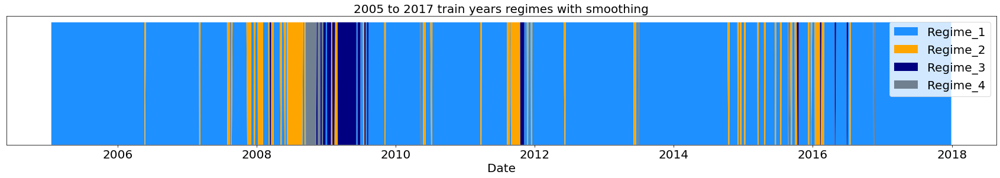

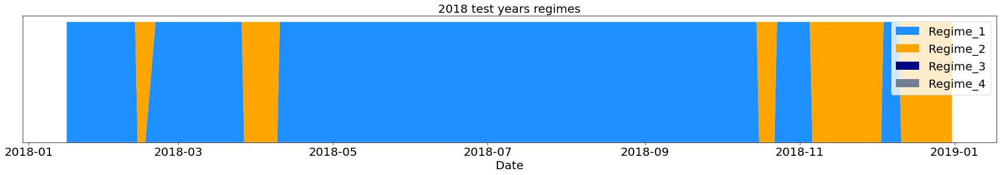

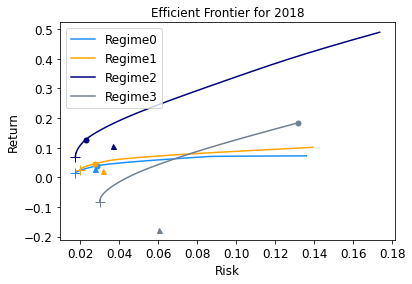

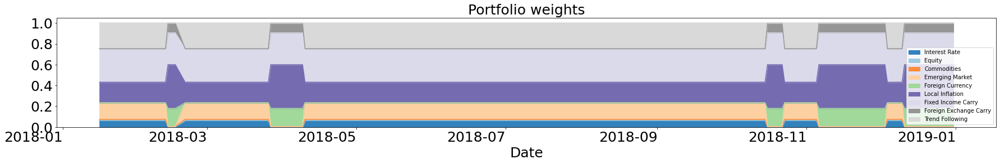

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


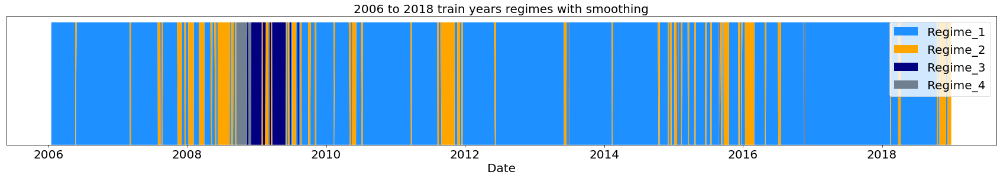

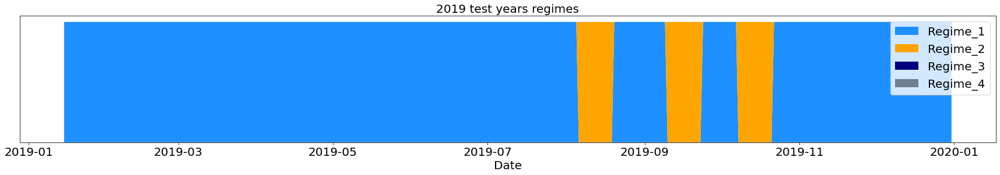

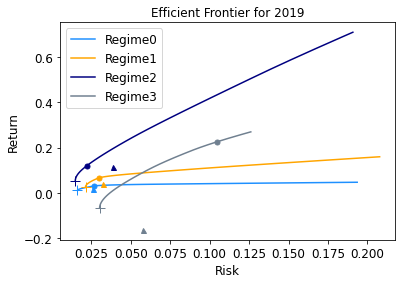

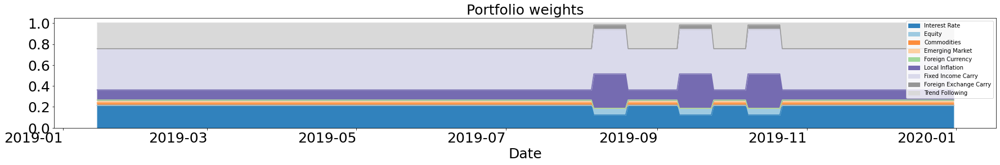

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


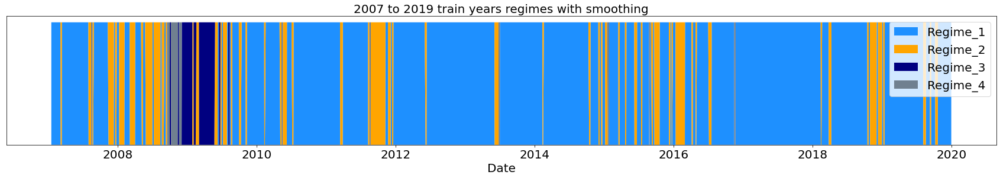

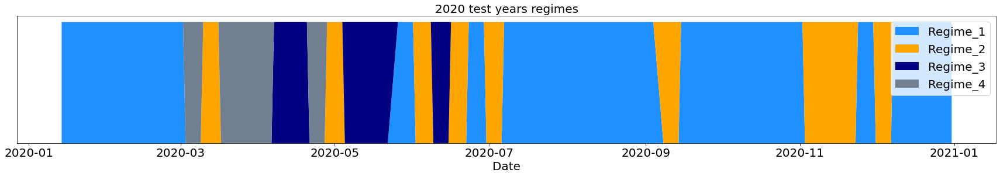

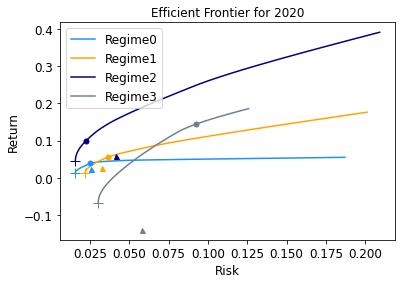

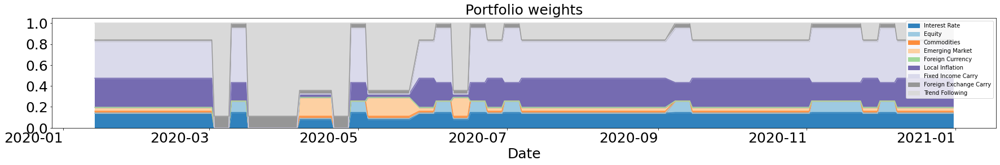

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


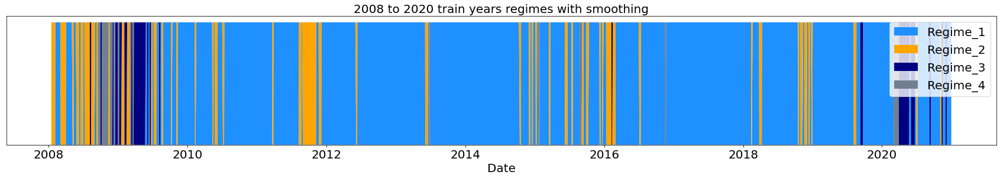

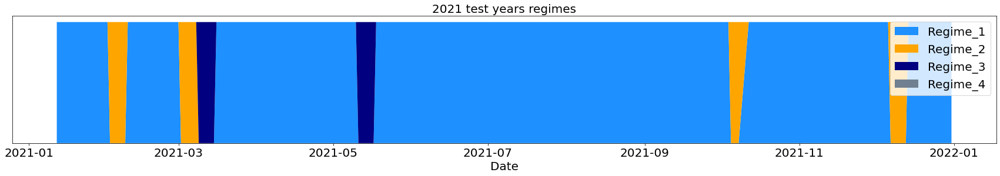

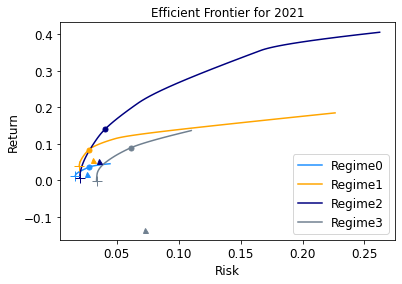

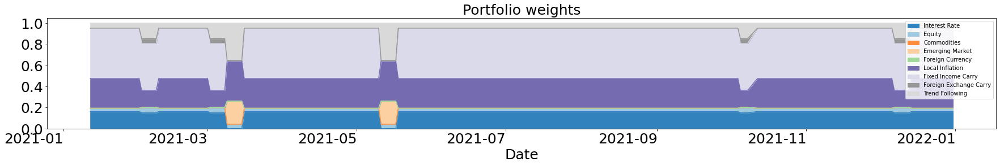

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


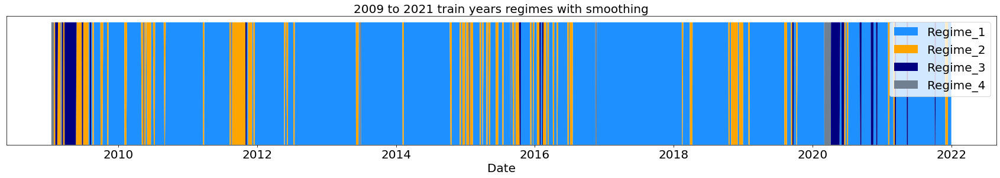

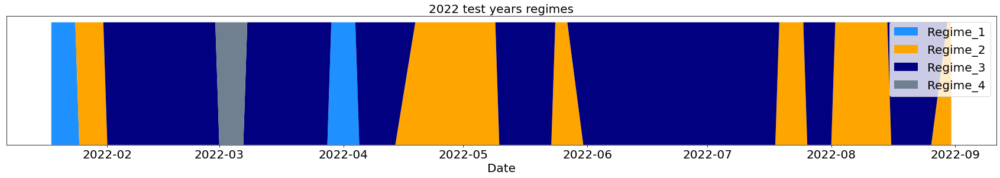

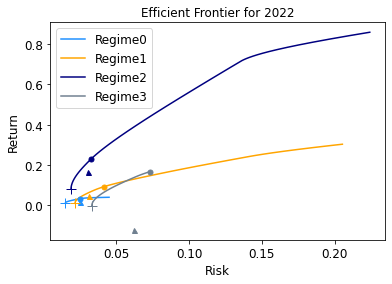

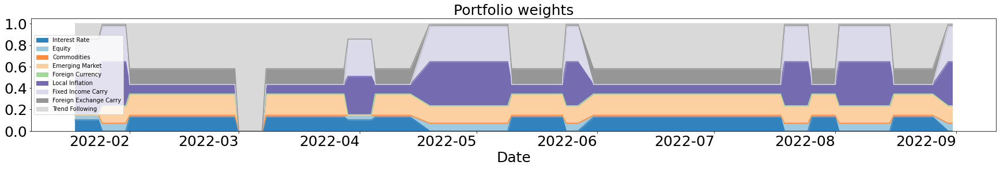

In [47]:
no_credit_styles = final_df.drop(['Credit', 'Equity Short Volatility', 
                          'Low Risk', 'Momentum', 'Quality', 'Value'], axis = 1)

train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = final_df, 
                        invest_factor = no_credit_styles, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz no credit and equity styles Performance
Portfolio Annual Return:  0.006248211992755159,  Baseline Annual Return: 0.0005693115244203018
Portfolio Sharpe Ratio:  0.19659507697271528,  Baseline Sharpe Ratio: 0.03765211081954629
Portfolio Max Drawdown:  0.07550350539851758,  Baseline Max Drawdown: 0.13584146389758878
Portfolio Calmar Ratio:  0.09332521463386384,  Baseline Calmar Ratio: 0.009249364985085991


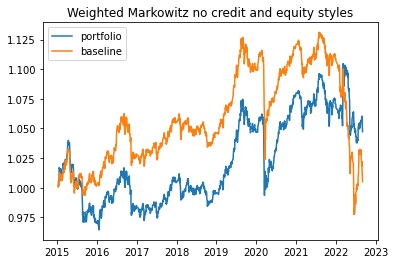

In [48]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz no credit and equity styles')

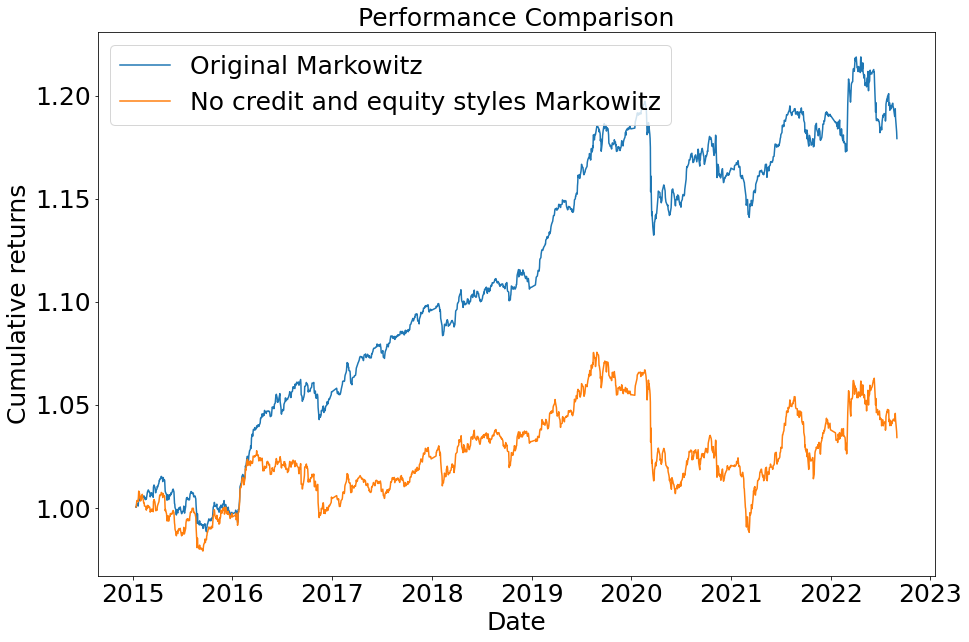

In [49]:
no_credit_styles_markowitz = (1 + pnl_total).cumprod()

plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Original Markowitz")
plt.plot(no_credit_markowitz, label = "No credit and equity styles Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()

# **US FACTORS DETECTION, US FACTORS INVEST**

Training on years 2002 to 2014
Testing on year 2015
Optimal number of regimes: 4


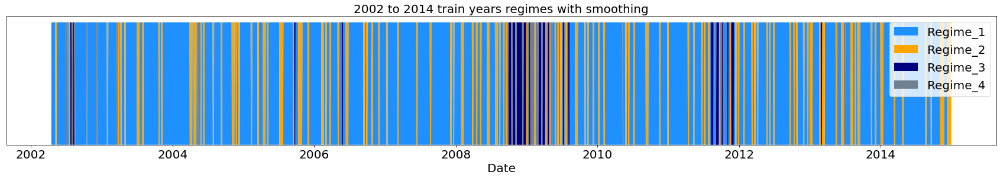

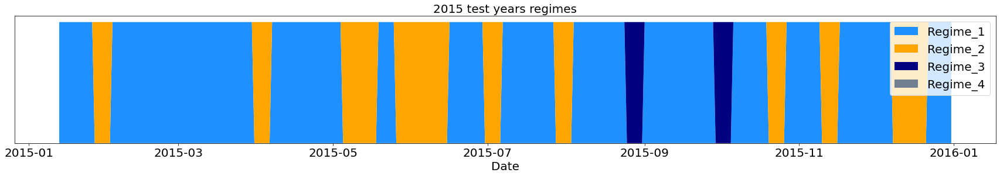

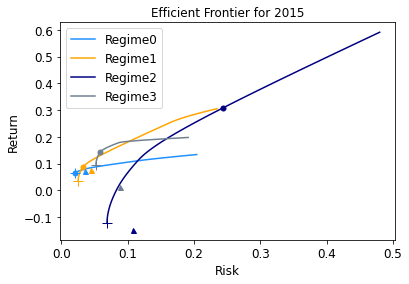

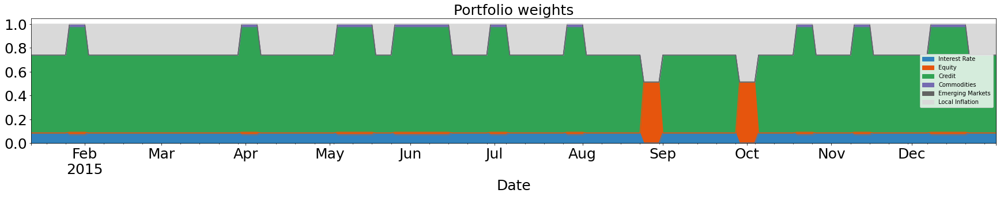

Training on years 2003 to 2015
Testing on year 2016
Optimal number of regimes: 4


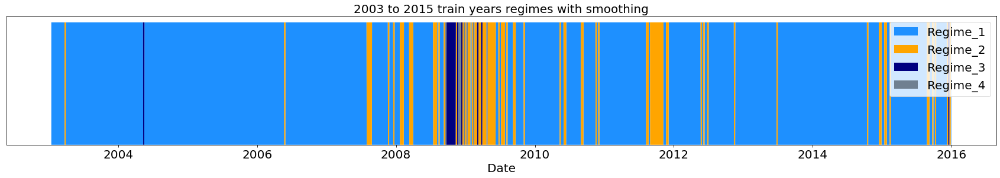

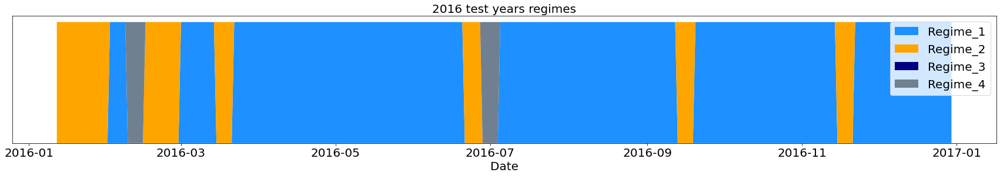

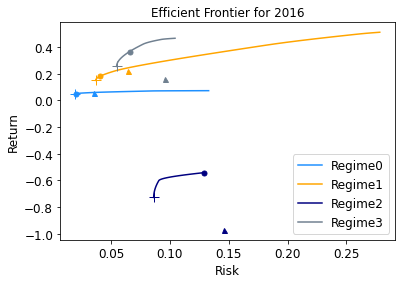

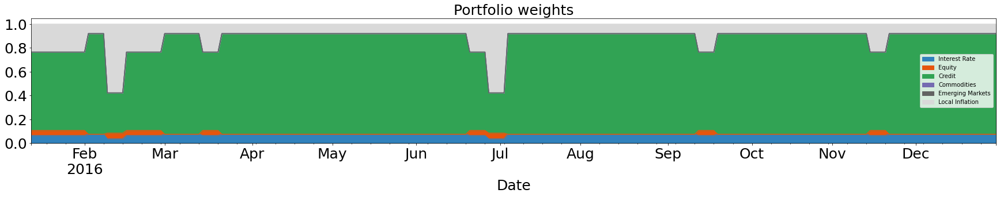

Training on years 2004 to 2016
Testing on year 2017
Optimal number of regimes: 4


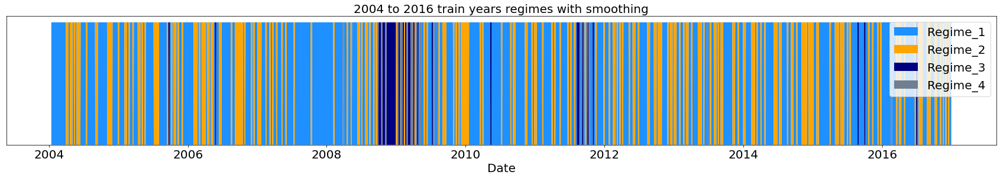

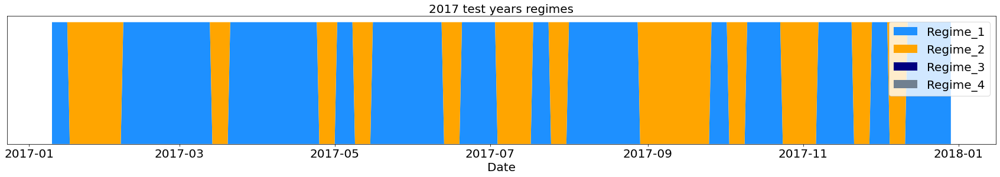

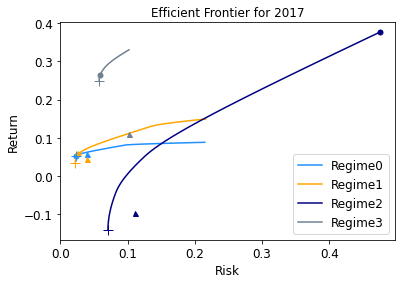

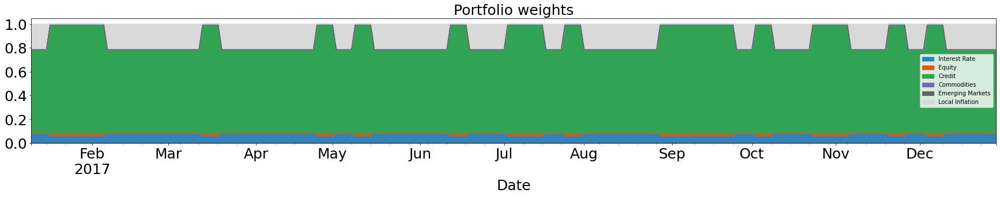

Training on years 2005 to 2017
Testing on year 2018
Optimal number of regimes: 4


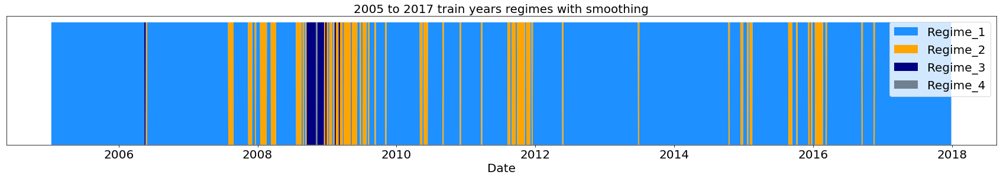

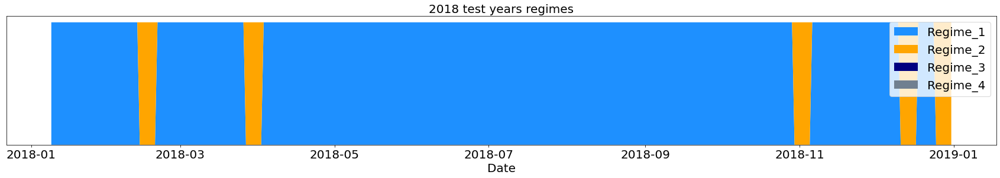

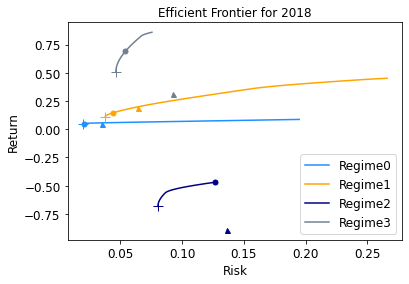

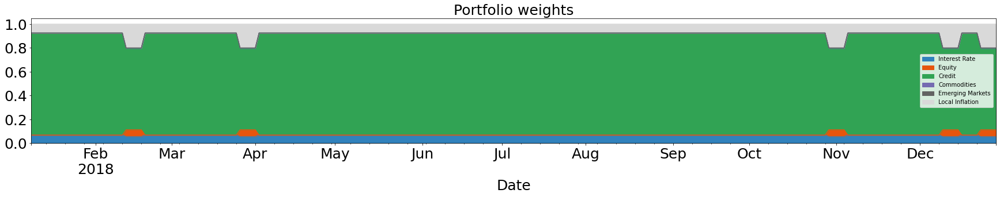

Training on years 2006 to 2018
Testing on year 2019
Optimal number of regimes: 4


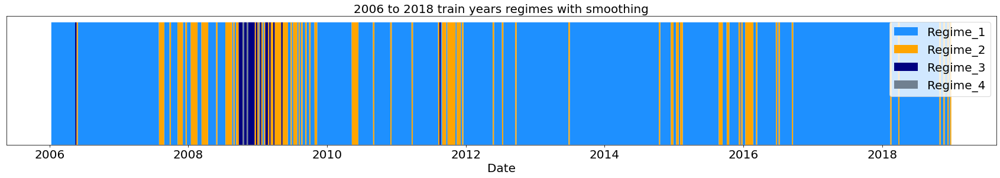

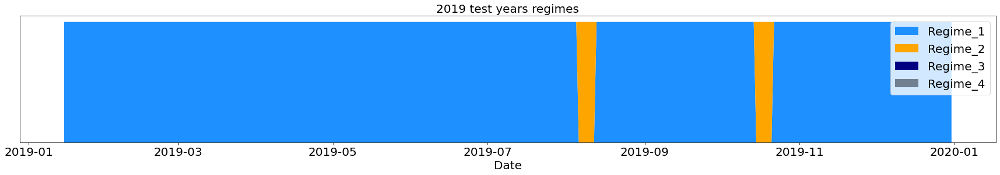

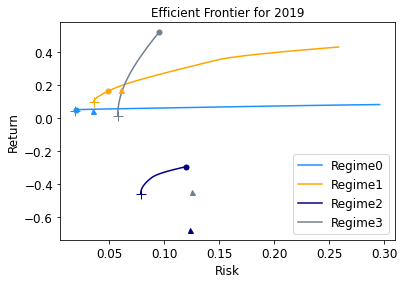

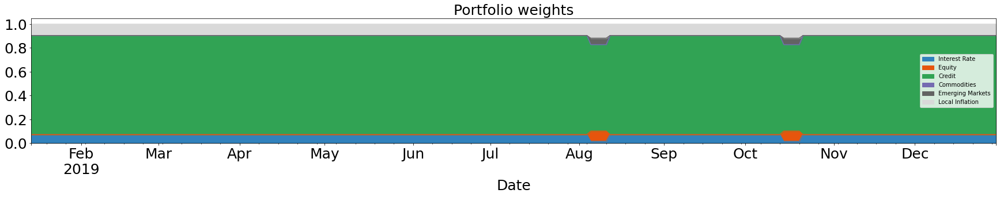

Training on years 2007 to 2019
Testing on year 2020
Optimal number of regimes: 4


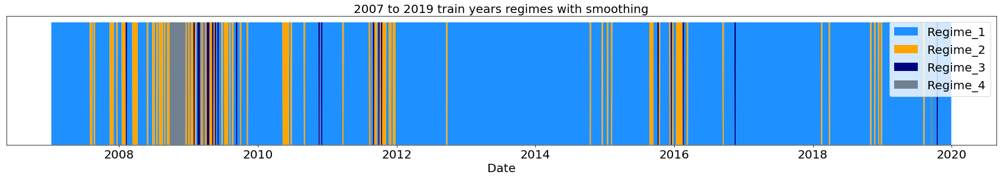

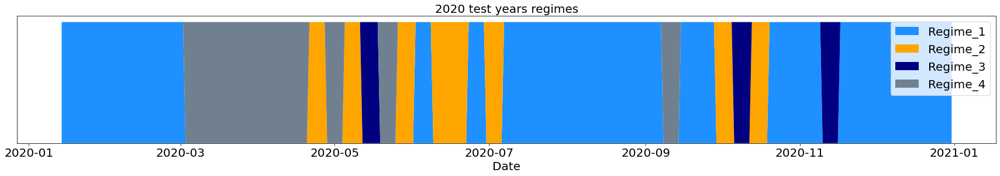

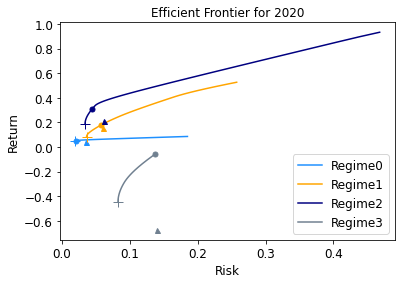

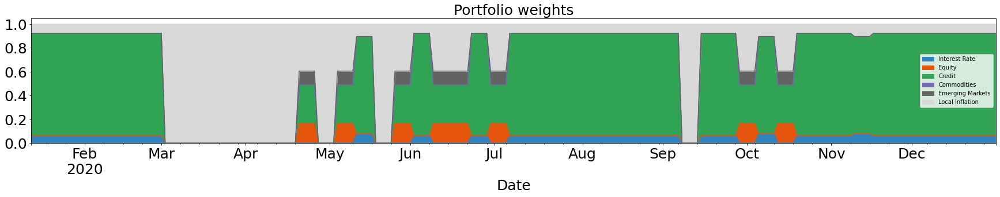

Training on years 2008 to 2020
Testing on year 2021
Optimal number of regimes: 4


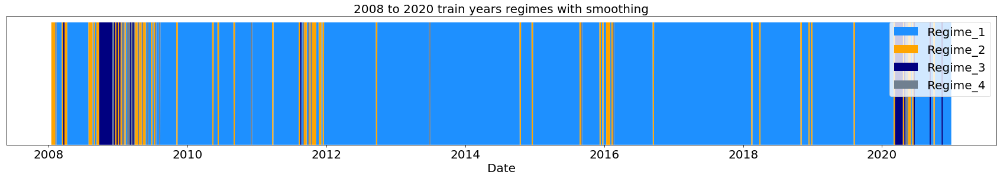

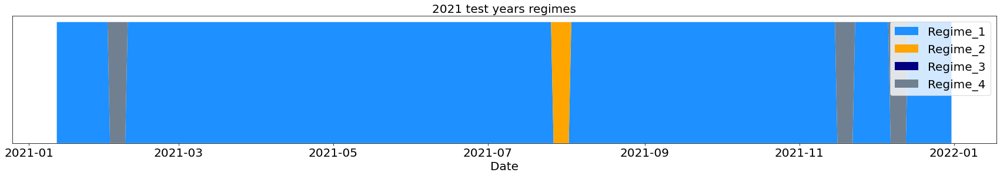

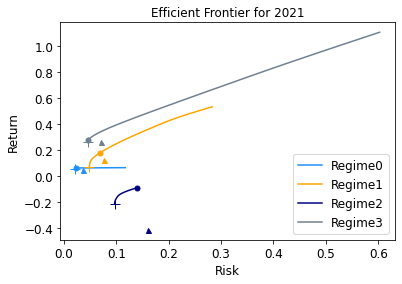

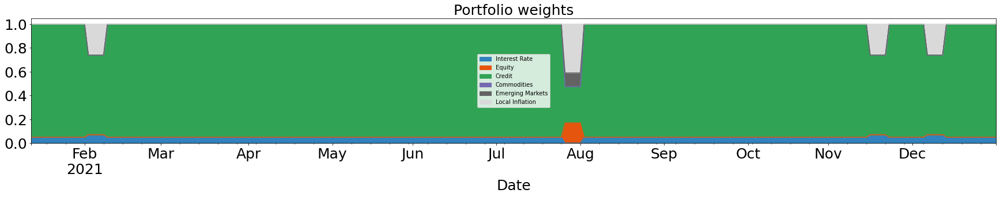

Training on years 2009 to 2021
Testing on year 2022
Optimal number of regimes: 4


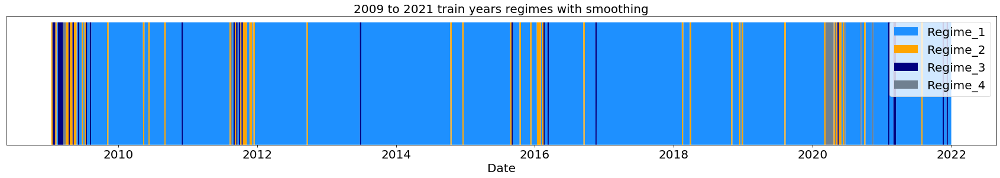

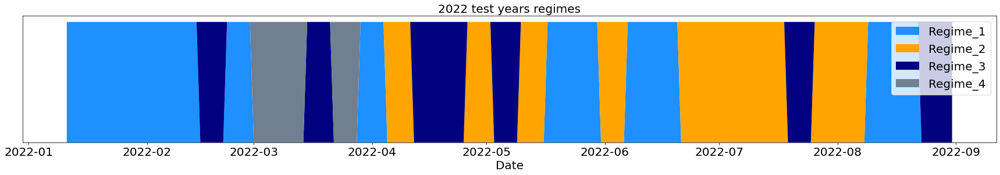

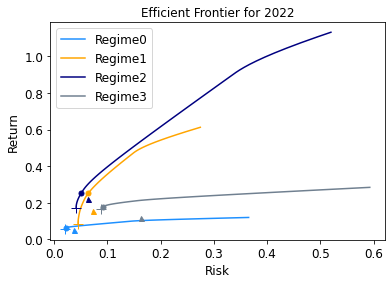

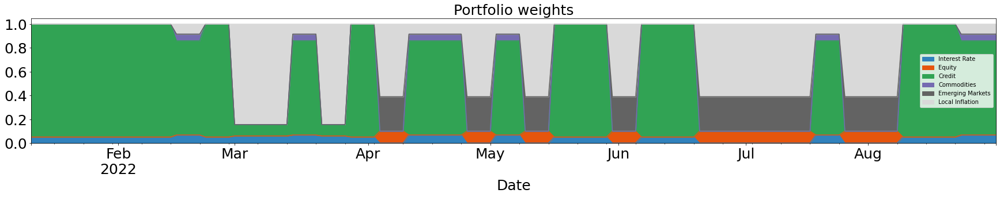

In [50]:
train_window = 12
years = np.arange(2002 + train_window + 1, 2023)
pnl_total, pnl_base_total = pd.DataFrame(), pd.DataFrame()

for y in years:
    pnl, pnl_base = run(factor = invest_factors_us, 
                        invest_factor = invest_factors_us, 
                        year = y, 
                        train_window = train_window, 
                        print_stats = False, 
                        plot_chart = True, 
                        portfolio_type = 'Markowitz', 
                        weighted = False, 
                        weekly = False, 
                        expanding = False, 
                        fix_k = 4, 
                        portfolio_sub_type = 'original', 
                        min_ret = None, 
                        max_var = None, 
                        min_weight = None)
    pnl_total = pd.concat([pnl_total, pnl])
    pnl_base_total = pd.concat([pnl_base_total, pnl_base])

Weighted Markowitz US factors detect and invest Performance
Portfolio Annual Return:  0.053589500376372,  Baseline Annual Return: 0.03208854214698009
Portfolio Sharpe Ratio:  1.3044710254761047,  Baseline Sharpe Ratio: 0.8088039875261425
Portfolio Max Drawdown:  0.09995368244495606,  Baseline Max Drawdown: 0.16745937414687428
Portfolio Calmar Ratio:  0.5298019630875436,  Baseline Calmar Ratio: 0.1929134807322569


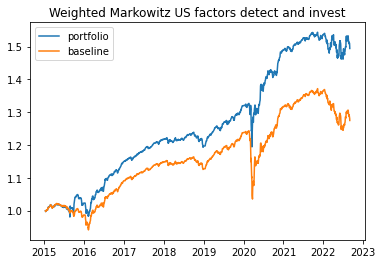

In [51]:
pnl_analysis(pnl_total, pnl_base_total, 'Weighted Markowitz US factors detect and invest')

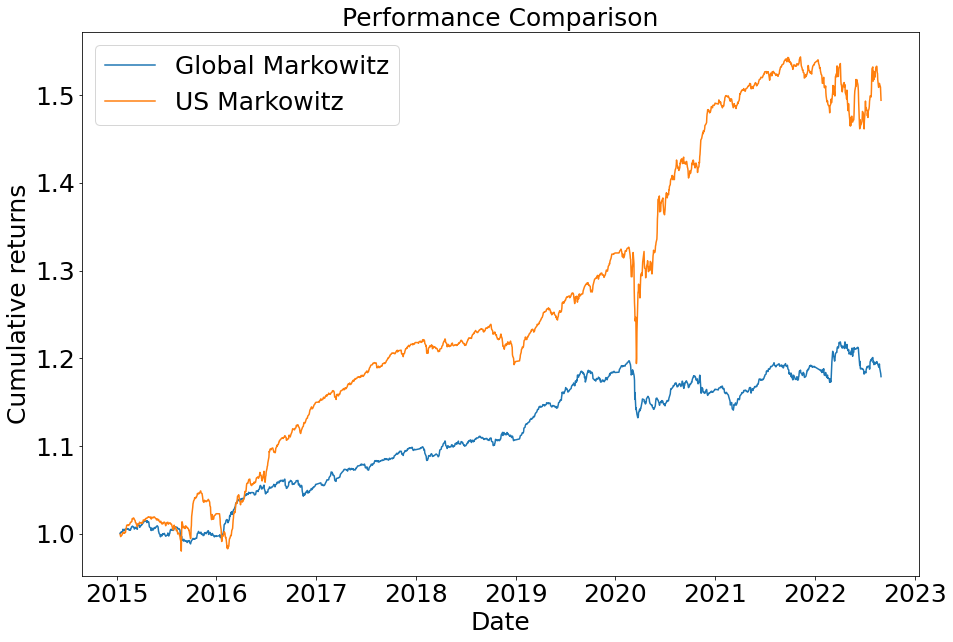

In [52]:
us_markowitz = (1 + pnl_total).cumprod()

plt.figure(figsize = (15, 10))
plt.plot(regime_markowitz, label = "Global Markowitz")
plt.plot(us_markowitz, label = "US Markowitz")
plt.title("Performance Comparison", fontsize = 25)
plt.xlabel("Date", fontsize = 25)
plt.ylabel("Cumulative returns", fontsize = 25)
plt.xticks(fontsize = 25)
plt.yticks(fontsize = 25)
plt.legend(fontsize = 25)
plt.show()